#File and library loading

In [ ]:
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
#testing with just one modality
from scipy.stats import norm

#multivariate normal for multivariate case
from scipy.stats import multivariate_normal
#K-means
from sklearn.cluster import KMeans
from random import seed
import datetime

In [ ]:
from google.colab import files

#Load the four brain images provided with the notebook
uploaded = files.upload()

#Preparing data
Function is done so it receives an unknown amount of modalities.

input is a file directory, output is data non zero, and indices.

In [ ]:
def create_data_nonzero(*nifti_images, gt):
    feature_data = []
    #done this way to accept more than one image
    #mascara is to get rid of the cerebellum
    mascara = nib.load(gt).get_fdata()
    mascara[mascara>0]=1
    for image in nifti_images:
        nifti_data = nib.load(image).get_fdata()
        nifti_data = np.multiply(nifti_data,mascara)
        flattened_data = nifti_data.flatten()
        feature_data.append(flattened_data)

    # Stack all the data together
    feature_data = np.vstack(feature_data)
    feature_data = np.transpose(feature_data)

    # Find row indices with nonzero data
    feature_data_nonzero_row_indices = [i for i, x in enumerate(feature_data) if x.any()]
    data_nonzero = feature_data[feature_data_nonzero_row_indices]

    return data_nonzero, feature_data_nonzero_row_indices

#Dice Coefficient
This function will compare the segmented image against the ground truth provided. Is the same from previous lab except for the additional parameter that is used to select which label to compare.

In [ ]:
#calculating dice coefficient for a given intensity value in both segmented image and groundtruth
def calculate_dice_coefficient(seg_image, true_image, intensity_values):
    """
    Calculate the Dice coefficient for specific intensity values in two binary NIfTI images.

    Parameters:
        seg_image: str, path to the segmentation binary NIfTI image file.
        true_image: str, path to the ground truth binary NIfTI image file.
        intensity_values: list of integers, the intensity values to consider.

    Returns:
        dice_coefficient: float, Dice coefficient.
    """
    # Load the binary NIfTI images
    seg_image_data = nib.load(seg_image).get_fdata()
    true_image_data = nib.load(true_image).get_fdata()

    # Create binary masks for specified intensity values
    seg_mask = np.isin(seg_image_data, intensity_values)
    true_mask = np.isin(true_image_data, intensity_values)

    # Calculate the Dice coefficient
    intersection = np.sum(seg_mask * true_mask)
    union = np.sum(seg_mask) + np.sum(true_mask)

    if union == 0:
        return 1.0  # Handle the case where both masks are empty.

    dice_coefficient = float((2.0 * intersection) / union)
    return dice_coefficient

#EM Algorithm Initialization
Class uses n_components as the number of clusters, max iterations as the maximum repetitions of the E-M process. Tolerance as another way to stop the E-M process based on the log-likelihood. Means, covariances and weights are parameters initialized. Weights are the proportion of of data points in the K-means clustering result assigned to that component.

---
#####there is a random initialization and a k-means initialization of parameters.
---
#####In expectation, belonging is the probability of a point belonging to a class given the clusters in that given moment. We calculate the probability density of each data point in the data without zero (which is the overall input in the class) belonging to the each of the clusters. This is done by evaluating the probability density function (pdf) of the multivariate normal distribution (mvn) at each data point. We use scipy stats for that comparing against a made function using the formulas. The custom method fails using random initialization and sometimes when multimodal.
---
##### In Maximization we update the means, covariances, and weights for each component based on the responsibilities (belonging) of data points to those components.

In [ ]:
#EM algorithm
class EM_algorithm:
    def __init__(self, n_components, method,mvm_method, max_iterations=150, tolerance=1e-5):
        #number of clusters
        self.n_components = n_components
        #iterations to stop the E-M loop. Either iterations or tolerance
        self.max_iterations = max_iterations
        self.tolerance = tolerance
        #means, covariance and weights
        self.means = None
        self.covariances = None
        self.weights = None
        #methods to initialize: our multivariate gaussian or the one in scipy stats and parameters random or k-means
        self.method = method
        self.mvm_method = mvm_method

    def initialize_parameters_with_kmeans(self, data):
        #number of clusters is used to initialize kmeans
        kmeans = KMeans(n_clusters=self.n_components, n_init='auto')
        kmeans.fit(data)
        kmeans_labels = kmeans.labels_
        #function taken to make sure of the order of the clusters
        new_clusters = self.robust_integration(kmeans.cluster_centers_,kmeans.predict(data))
        print(new_clusters)
        #assigning the clusters obtained with k-means and covariances as an identity matrix
        self.means = new_clusters
        self.covariances = [np.eye(data.shape[1]) for _ in range(self.n_components)]
        #weights are the proportion of the labels in the data
        self.weights = np.array([np.mean(kmeans_labels == i) for i in range(self.n_components)])

    def initialize_parameters_random(self, data):
        n_samples, n_features = data.shape
        #random number between 0 and 255, possible values in the grayscaleimage
        random_numbers = np.random.randint(0, 256, size=(self.n_components, 1))
        self.means = np.tile(random_numbers, (1, n_features))
        self.covariances = [np.eye(data.shape[1]) for _ in range(self.n_components)]
        self.weights = np.full(self.n_components, 1.0 / self.n_components)
        new_clusters = self.robust_integration(self.means,self.expectation(data))
        #in the class material, it is mentioned that parameters can be initalized either with a "set of parameters and then expectation"
        #or the weights and maximization steps, that is way we use it in the function to reorganize clusters
        self.means = new_clusters
        print(self.means)

    def initialize_parameters(self, data):
        #initialize according to the parameter initialization method selected
        if self.method == 'km':
          return self.initialize_parameters_with_kmeans(data)
        if self.method == 'rn':
          return self.initialize_parameters_random(data)

    def expectation(self, data):
      #create a 'belonging' array with the shape of the data and the number of components
        belonging = np.zeros((data.shape[0], self.n_components))
        #iterate 'self.n_components' times. One for each mixture model.
        for k in range(self.n_components):
            if self.mvm_method == 'mvn':
                # Use scipy.stats.multivariate_normal
                mvn = multivariate_normal(mean=self.means[k], cov=self.covariances[k], allow_singular=True)
                belonging[:, k] = self.weights[k] * mvn.pdf(data)
            elif self.mvm_method == 'our':
                # Use our multivariate gaussian. Our function delivers the probability density function
                belonging[:, k] = self.weights[k] * self.multivariate_normal_nonp(self.means[k], self.covariances[k], data)

        # Add a small value to the denominator to avoid division by zero error
        normalization = belonging.sum(axis=1, keepdims=True) + 1e-6
        belonging /= normalization
        return belonging

    def maximization(self, data, belonging):
        n_samples = data.shape[0]
        #loop over each component
        for k in range(self.n_components):
          #here starts the update of the center of each components.
          #first a weighted sum
            weighted_sum = np.dot(belonging[:, k], data)
            #Update the mean (center) of component 'k' by dividing the weighted sum calculated in the previous step by the sum of the weights of all data points belonging to component 'k'.
            self.means[k] = weighted_sum / belonging[:, k].sum() #mu_k new in the formula
            #this diff is to be used on the covariance
            diff = data - self.means[k]
            weighted_diff = belonging[:, k][:, np.newaxis] * diff
            covariance = np.dot(weighted_diff.T, diff) / belonging[:, k].sum()
            self.covariances[k] = covariance
        self.weights = belonging.sum(axis=0) / n_samples

    def fit(self, data):
        self.initialize_parameters(data)

        likelihoods = []  # List to store likelihood values per iteration
        prev_log_likelihood = 0  # Initialize previous log likelihood


        #iterate max_iteration times the E-M algorithm. It stops after max_iteration times or if the absolute value of the previous and curren likelihood.
        #is smaller than self.tolerance
        for iteration in range(self.max_iterations):
            belonging = self.expectation(data)
            self.maximization(data, belonging)
            log_likelihood = np.sum(np.log(np.sum(belonging, axis=1)))
            likelihoods.append(log_likelihood)  # Append the likelihood value
            if iteration > 0 and abs(log_likelihood - prev_log_likelihood) < self.tolerance:
                break
            prev_log_likelihood = log_likelihood
        #print the definitive clusters.
        print(self.means)

        plt.figure()
        plt.plot(range(1, len(likelihoods) + 1), likelihoods)
        plt.xlabel('Iteration')
        plt.ylabel('Log Likelihood')
        plt.title('Likelihood per Iteration')
        plt.show()

    def predict(self, data):
        belonging = self.expectation(data)
        return np.argmax(belonging, axis=1) + 1 #need to add 1 since labels at this point are 0,1,2 and groundtruth is 1,2,3

    #this method was found and added because the centers used to change every time kmeans was executed
    def robust_integration(self, centroids, Kmeans_predict):
        # Find the minimum and maximum values and their corresponding indexes
        min_index = np.argmin(centroids[:, 0])
        max_index = np.argmax(centroids[:, 0])

        # Make clustering more robust
        centroid_new = np.zeros_like(centroids)
        centroid_new[0] = centroids[min_index]
        centroid_new[2] = centroids[max_index]

        if min_index + max_index == 1:
            centroid_new[1] = centroids[2]
        elif min_index + max_index == 2:
            centroid_new[1] = centroids[1]
        elif min_index + max_index == 3:
            centroid_new[1] = centroids[0]
        return centroid_new


    def multivariate_normal_nonp(self,mean, cov, x):
        """
        Calculate the probability density of a multivariate normal distribution at point x.

        Parameters, same as scipy stats multivariate_normal:
        - mean: Mean vector of the distribution.
        - cov: Covariance matrix of the distribution.
        - x: Data point at which to calculate the probability density.

        Returns:
        - pdf: Probability density at point x.
        """
        dim = mean.shape[0]

        # Calculate the determinant of the covariance matrix for the denominator
        det = np.linalg.det(cov)
        # Add regularization term (small constant) to the diagonal of the covariance matrix
        reg_param = 1e-6
        reg_cov = cov + reg_param * np.eye(cov.shape[0])

        # Calculate the inverse of the regularized covariance matrix
        inv_cov = np.linalg.inv(reg_cov)
        # Centered data point
        x_minus_mean = x - mean

        # Exponent term
        exponent = -0.5 * np.sum(np.dot(x_minus_mean, inv_cov) * x_minus_mean, axis=1) #mahalanobis distance

        # Normalization term
        normalization = 1.0 / (((2 * np.pi) ** (dim / 2)) * np.sqrt(det))

        # Probability density
        pdf = normalization * np.exp(exponent)

        return pdf


#Reconstruction
This function takes the result of the EM algorithm and convert it again in a nifti image.

In [ ]:
def reconstruction (some_input_image, feature_data_nonzero_row_indices, cluster_assignments,output_filename):
  t1_og = nib.load(some_input_image)
  shape_original_image = t1_og.shape
  shape_original_image_flatten = t1_og.get_fdata().flatten().shape
  segmented_image=np.zeros(shape_original_image_flatten)
  segmented_image[feature_data_nonzero_row_indices]=cluster_assignments
  segmented=np.reshape(segmented_image,shape_original_image)

  # Save the EM segmentation as a NIfTI image
  output_nifti = nib.Nifti1Image(segmented, t1_og.affine)
  nib.save(output_nifti, output_filename)

#Testing the code

In [ ]:
relevant_data, relevant_indices = create_data_nonzero('stripped_T1.nii', 'stripped_T2.nii', gt='LabelsForTesting.nii')

In [ ]:
gmm_with_kmeans = EM_algorithm(n_components=3, method = 'km', mvm_method = 'our')

[[ 37.59769713  58.39203661]
 [107.3066669  164.81314671]
 [171.45587389 174.43109121]]


<ipython-input-4-867ae800249b>:97: RuntimeWarning: divide by zero encountered in log
  log_likelihood = np.sum(np.log(np.sum(belonging, axis=1)))
<ipython-input-4-867ae800249b>:99: RuntimeWarning: invalid value encountered in double_scalars
  if iteration > 0 and abs(log_likelihood - prev_log_likelihood) < self.tolerance:


[[ 31.33446221  43.46529384]
 [ 91.40715286 145.97729901]
 [160.03919217 172.38792726]]


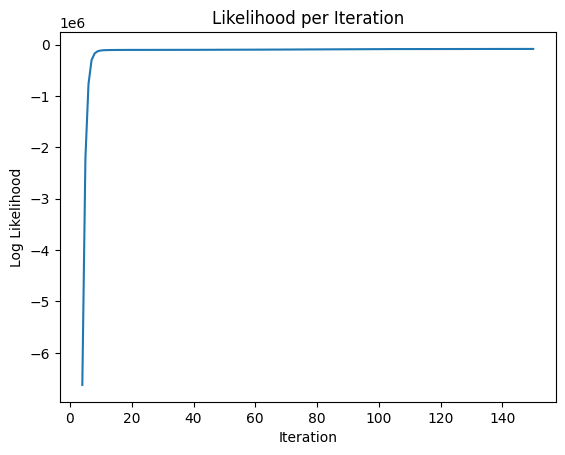


 This method took 41 sec.


In [ ]:
# Fit the K-means with K-means initialization
start = datetime.datetime.now()
gmm_with_kmeans.fit(relevant_data)
end = datetime.datetime.now()

print(f'\n This method took {(end-start).seconds} sec.')

In [ ]:
gmm_with_random = EM_algorithm(n_components=3, method = 'rn', mvm_method = 'our')

In [ ]:
# Fit the K-means with random initialization
start = datetime.datetime.now()
gmm_with_random.fit(relevant_data)
end = datetime.datetime.now()

print(f'\n This method took {(end-start).seconds} sec.')

In [ ]:
cluster_assignments = gmm_with_kmeans.predict(relevant_data)

In [ ]:
cluster_assignments2 = gmm_with_random.predict(relevant_data)

In [ ]:
reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments, 'km_our.nii')
reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments2, 'rn_our.nii')

In [ ]:
d_cof = calculate_dice_coefficient('rn_our.nii', 'LabelsForTesting.nii',1)
print(f"the dice score for this is: {d_cof:.2f}")

the dice score for this is: 0.44


#Plot Function

In [ ]:
def plot_nifti_slices(A_path, B_path, pixel_intensity, slice_number):
    # Load NIfTI images
    A_img = nib.load(A_path)
    B_img = nib.load(B_path)

    # Get the image data arrays
    A_data = A_img.get_fdata()
    B_data = B_img.get_fdata()

    # Get the specified slices
    A_slice = A_data[:, :, slice_number]
    B_slice = B_data[:, :, slice_number]

    # Create masks for pixel_intensity
    A_mask = np.where(A_slice == pixel_intensity, 1, 0)
    B_mask = np.where(B_slice == pixel_intensity, 1, 0)

    # Calculate the difference
    diff = A_mask - B_mask

    # Create subplots
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    if pixel_intensity == 1:
      fig.suptitle('CSF')
    if pixel_intensity == 2:
      fig.suptitle('GM')
    if pixel_intensity == 3:
      fig.suptitle('wM')

    axes[0].imshow(A_mask, cmap='gray')
    axes[0].set_title('Segmentation Mask (A)')

    axes[1].imshow(B_mask, cmap='gray')
    axes[1].set_title('Ground Truth Mask (B)')

    axes[2].imshow(diff, cmap='gray')
    axes[2].set_title('Difference (A - B)')

    for ax in axes:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

#Testing Function

In [ ]:
def testing (t1, t2, labels, which, slice_number):
  """
  t1 is t1 image
  t2 is t2 image
  labels is the ground truth
  which is to select if running on just one modalitie or both, can be t1, t2 and mv, slice number is for plotting
  slice_number is the number of the slice to be plot
  """
  np.seterr(all='ignore')
  #testing on t1
  if which == 't1':
    relevant_data, relevant_indices = create_data_nonzero(t1, gt='LabelsForTesting.nii')
  #testing on t2
  if which == 't2':
    relevant_data, relevant_indices = create_data_nonzero(t2, gt='LabelsForTesting.nii')
  #multivariate
  if which == 'mv':
    relevant_data, relevant_indices = create_data_nonzero(t1, t2, gt='LabelsForTesting.nii')

  #initialize an EM_algorithm object for kmeans and our mv
  gmm_with_kmeans = EM_algorithm(n_components=3, method = 'km', mvm_method = 'our')
  #initialize an EM_algorithm object for kmeans and our mv
  gmm_with_random = EM_algorithm(n_components=3, method = 'rn', mvm_method = 'our')
    #initialize an EM_algorithm object for kmeans and scipy
  gmm_with_kmeans_sc = EM_algorithm(n_components=3, method = 'km', mvm_method = 'mvn')
  #initialize an EM_algorithm object for kmeans and scipy
  gmm_with_random_sc = EM_algorithm(n_components=3, method = 'rn', mvm_method = 'mvn')

  # Fit the clusters with K-means initialization, our mvn
  start = datetime.datetime.now()
  gmm_with_kmeans.fit(relevant_data)
  end = datetime.datetime.now()

  print(f'\n k-means initialization custom gmm, t1 took {(end-start).seconds} sec.')

  # Fit the clusters with K-means initialization scipy
  start = datetime.datetime.now()
  gmm_with_kmeans_sc.fit(relevant_data)
  end = datetime.datetime.now()

  print(f'\n k-means initialization scipy gmm, t1 took {(end-start).seconds} sec.')

  # Fit the clusters with random initialization
  start = datetime.datetime.now()
  gmm_with_random.fit(relevant_data)
  end = datetime.datetime.now()

  print(f'\n random initialization custom gmm, with t1 took {(end-start).seconds} sec.')

  # Fit the clusters with random initialization
  start = datetime.datetime.now()
  gmm_with_random_sc.fit(relevant_data)
  end = datetime.datetime.now()

  print(f'\n random initialization scipy gmm, with t1 took {(end-start).seconds} sec.')

  cluster_assignments_km = gmm_with_kmeans.predict(relevant_data)
  cluster_assignments_km_sc = gmm_with_kmeans_sc.predict(relevant_data)
  cluster_assignments_rn = gmm_with_random.predict(relevant_data)
  cluster_assignments_rn_sc = gmm_with_random_sc.predict(relevant_data)
  reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments_km, 'km_our.nii')
  reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments_km_sc, 'km_sci.nii')
  reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments_rn, 'rn_our.nii')
  reconstruction('stripped_T1.nii', relevant_indices,cluster_assignments_rn_sc, 'rn_sci.nii')

  plot_nifti_slices('km_our.nii', 'LabelsForTesting.nii', 1, slice_number)
  d_cof = calculate_dice_coefficient('km_our.nii', 'LabelsForTesting.nii',1)
  print(f"the dice score for this CSF is: {d_cof:.2f}")

  plot_nifti_slices('km_sci.nii', 'LabelsForTesting.nii', 1, slice_number)
  d_cof = calculate_dice_coefficient('km_sci.nii', 'LabelsForTesting.nii',1)
  print(f"the dice score for this CSF is: {d_cof:.2f}")

  plot_nifti_slices('rn_our.nii', 'LabelsForTesting.nii', 1, slice_number)
  d_cof = calculate_dice_coefficient('rn_our.nii', 'LabelsForTesting.nii',1)
  print(f"the dice score for this CSF is: {d_cof:.2f}")

  plot_nifti_slices('rn_sci.nii', 'LabelsForTesting.nii', 1, slice_number)
  d_cof = calculate_dice_coefficient('rn_sci.nii', 'LabelsForTesting.nii',1)
  print(f"the dice score for this CSF is: {d_cof:.2f}")

  plot_nifti_slices('km_our.nii', 'LabelsForTesting.nii', 2, slice_number)
  d_cof = calculate_dice_coefficient('km_our.nii', 'LabelsForTesting.nii',2)
  print(f"the dice score for this GM is: {d_cof:.2f}")

  plot_nifti_slices('km_sci.nii', 'LabelsForTesting.nii', 2, slice_number)
  d_cof = calculate_dice_coefficient('km_sci.nii', 'LabelsForTesting.nii',2)
  print(f"the dice score for this GM is: {d_cof:.2f}")

  plot_nifti_slices('rn_our.nii', 'LabelsForTesting.nii', 2, slice_number)
  d_cof = calculate_dice_coefficient('rn_our.nii', 'LabelsForTesting.nii',2)
  print(f"the dice score for this GM is: {d_cof:.2f}")

  plot_nifti_slices('rn_sci.nii', 'LabelsForTesting.nii', 2, slice_number)
  d_cof = calculate_dice_coefficient('rn_sci.nii', 'LabelsForTesting.nii',2)
  print(f"the dice score for this GM is: {d_cof:.2f}")

  plot_nifti_slices('km_our.nii', 'LabelsForTesting.nii', 3, slice_number)
  d_cof = calculate_dice_coefficient('km_our.nii', 'LabelsForTesting.nii',3)
  print(f"the dice score for this WM is: {d_cof:.2f}")

  plot_nifti_slices('km_sci.nii', 'LabelsForTesting.nii', 3, slice_number)
  d_cof = calculate_dice_coefficient('km_sci.nii', 'LabelsForTesting.nii',3)
  print(f"the dice score for this WM is: {d_cof:.2f}")

  plot_nifti_slices('rn_our.nii', 'LabelsForTesting.nii', 3, slice_number)
  d_cof = calculate_dice_coefficient('rn_our.nii', 'LabelsForTesting.nii',3)
  print(f"the dice score for this WM is: {d_cof:.2f}")

  plot_nifti_slices('rn_sci.nii', 'LabelsForTesting.nii', 3, slice_number)
  d_cof = calculate_dice_coefficient('rn_sci.nii', 'LabelsForTesting.nii',3)
  print(f"the dice score for this WM is: {d_cof:.2f}")

#Testing
Testing was done by uploading stripped_T1.nii, stripped_T2.nii and LabelsForTesting.nii for each of the cases.

#case 1

[[ 41.9096286 ]
 [134.28240813]
 [208.39445595]]
[[ 36.50132444]
 [145.03956787]
 [218.34979247]]


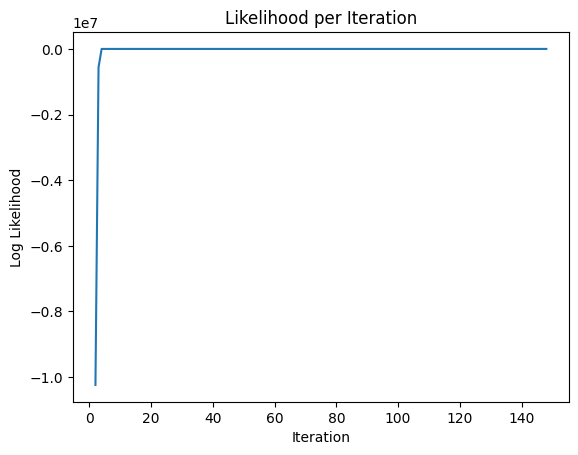


 k-means initialization custom gmm, t1 took 17 sec.
[[ 41.87285145]
 [134.21424911]
 [208.35935452]]
[[ 36.50131621]
 [145.03956122]
 [218.34979258]]


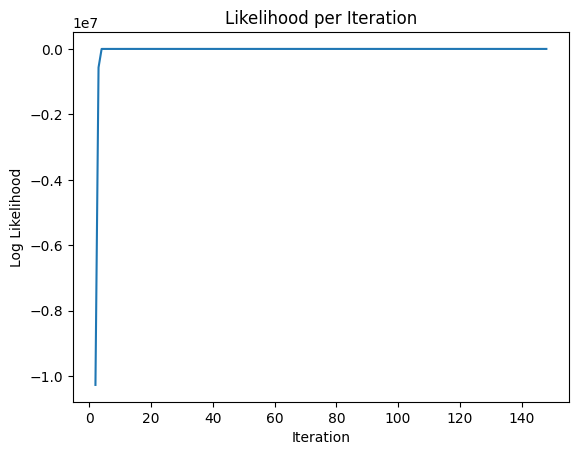


 k-means initialization scipy gmm, t1 took 19 sec.
[[111]
 [178]
 [189]]
[[ 35]
 [142]
 [217]]


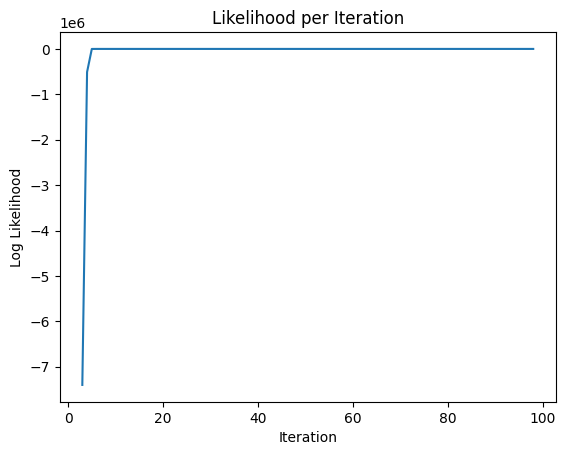


 random initialization custom gmm, with t1 took 12 sec.
[[ 35]
 [164]
 [173]]
[[ 35]
 [142]
 [217]]


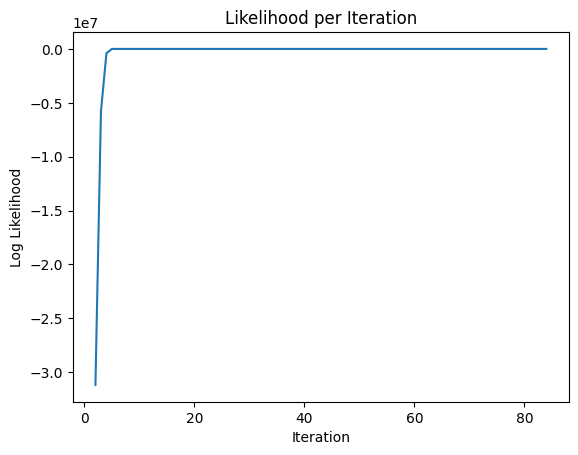


 random initialization scipy gmm, with t1 took 11 sec.


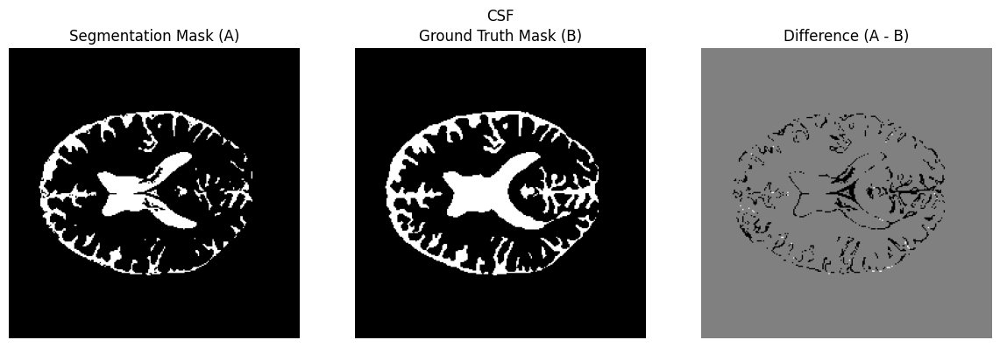

the dice score for this CSF is: 0.80


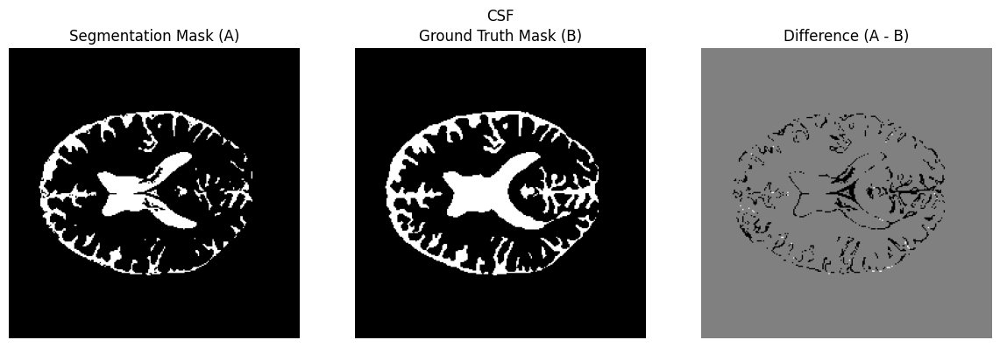

the dice score for this CSF is: 0.80


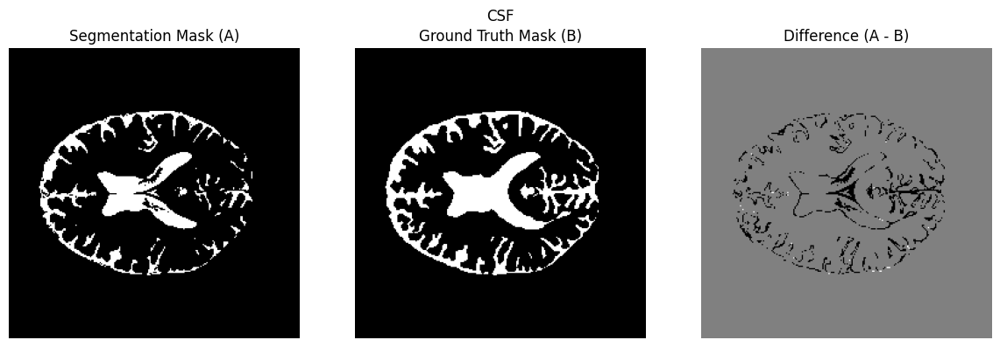

the dice score for this CSF is: 0.79


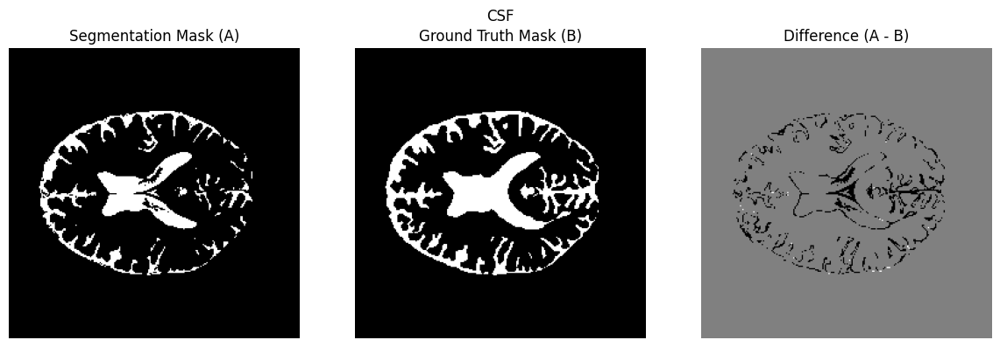

the dice score for this CSF is: 0.79


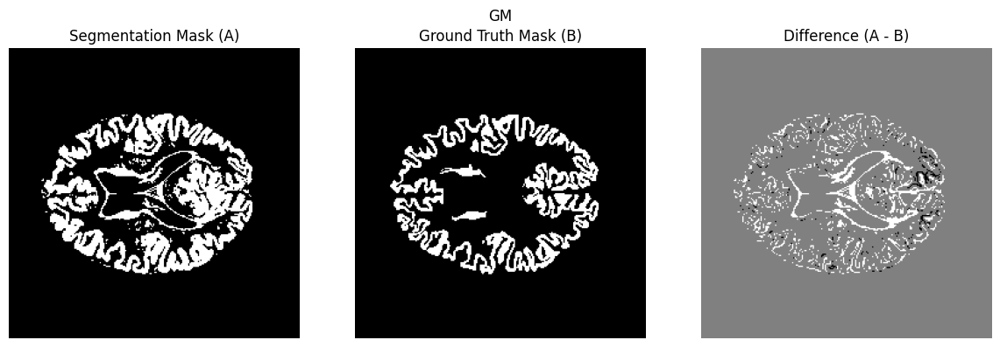

the dice score for this GM is: 0.78


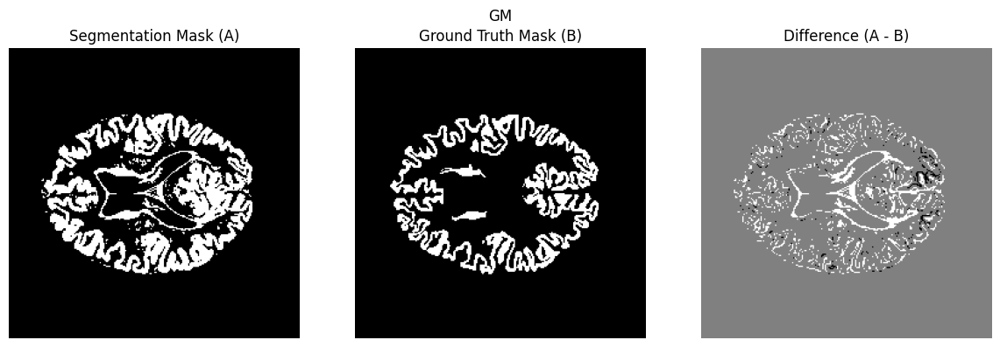

the dice score for this GM is: 0.78


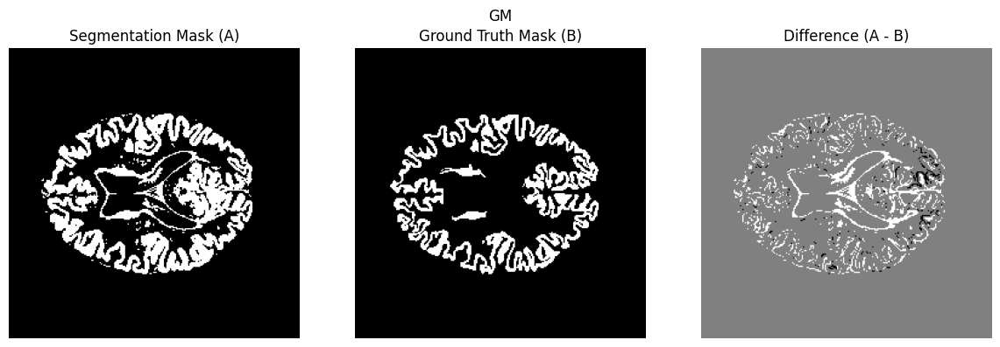

the dice score for this GM is: 0.78


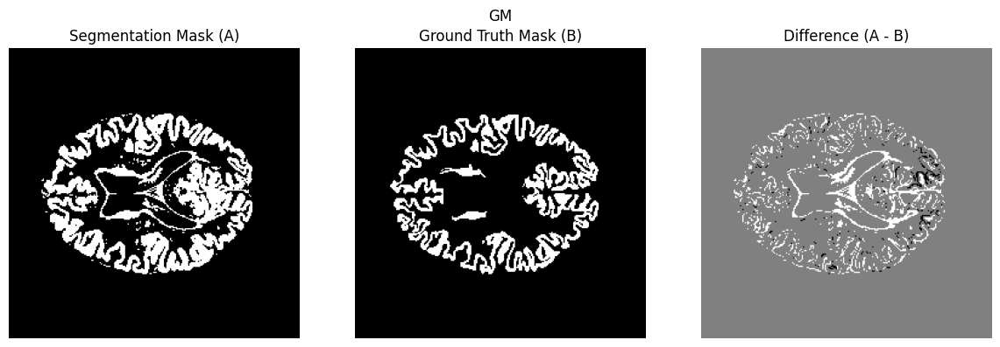

the dice score for this GM is: 0.78


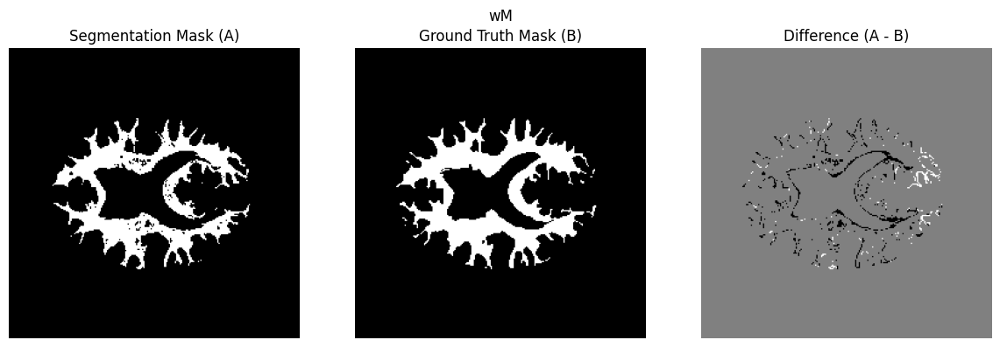

the dice score for this WM is: 0.86


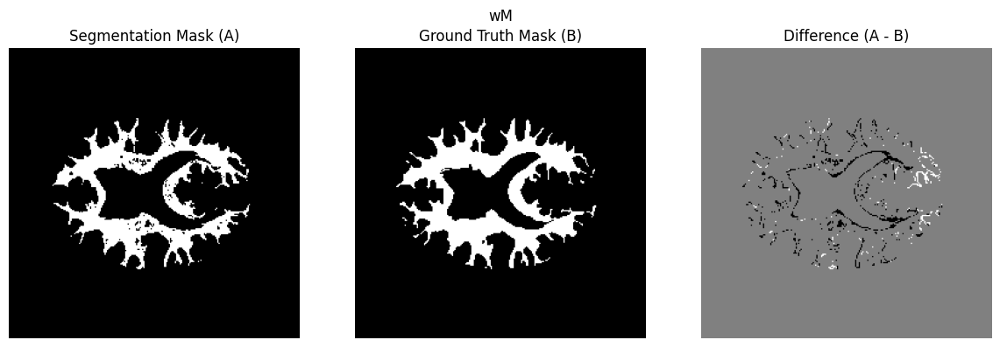

the dice score for this WM is: 0.86


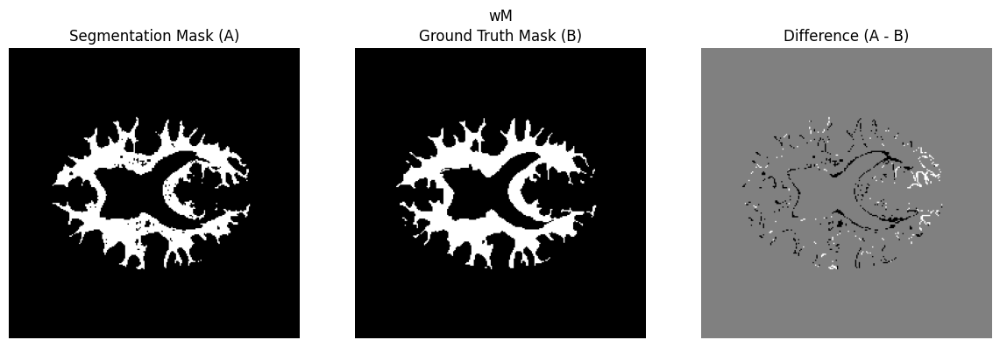

the dice score for this WM is: 0.87


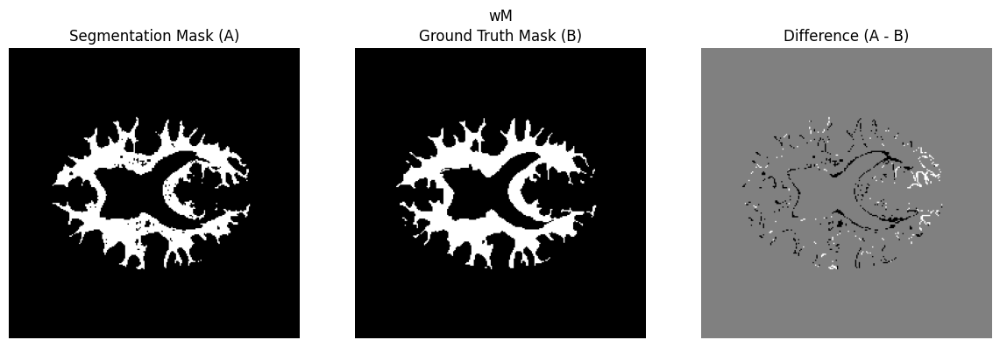

the dice score for this WM is: 0.87


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't1', 24)

[[ 49.69037319]
 [142.88804894]
 [185.76252543]]
[[ 61.41195897]
 [154.06435409]
 [185.19704445]]


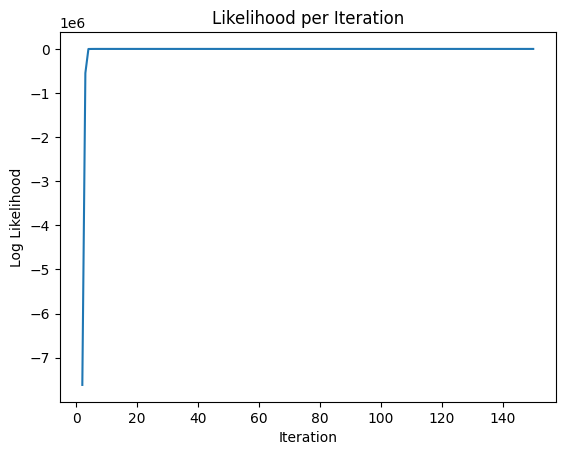


 k-means initialization custom gmm, t1 took 17 sec.
[[ 49.61829257]
 [142.73043461]
 [185.62449006]]
[[ 61.50972476]
 [153.16466156]
 [182.56918457]]


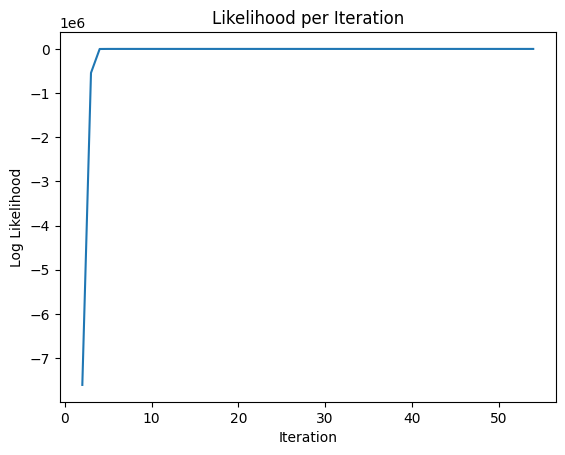


 k-means initialization scipy gmm, t1 took 7 sec.
[[154]
 [183]
 [251]]
[[ 57]
 [160]
 [204]]


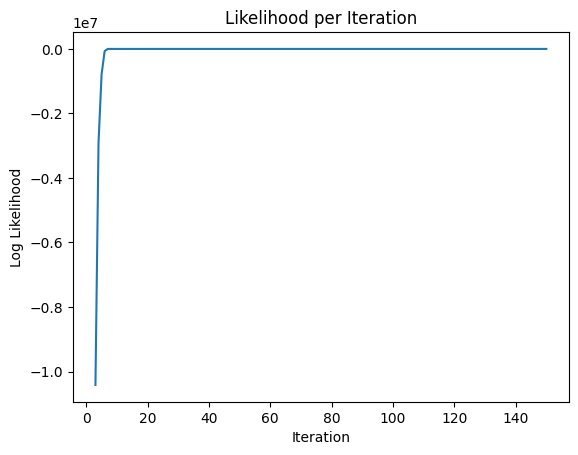


 random initialization custom gmm, with t1 took 18 sec.
[[112]
 [217]
 [254]]
[[ 55]
 [162]
 [208]]


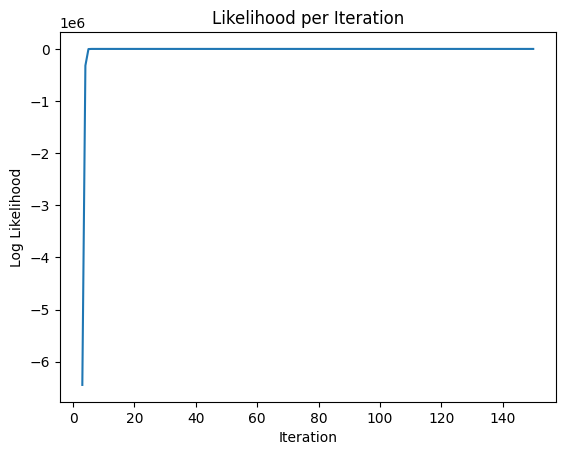


 random initialization scipy gmm, with t1 took 20 sec.


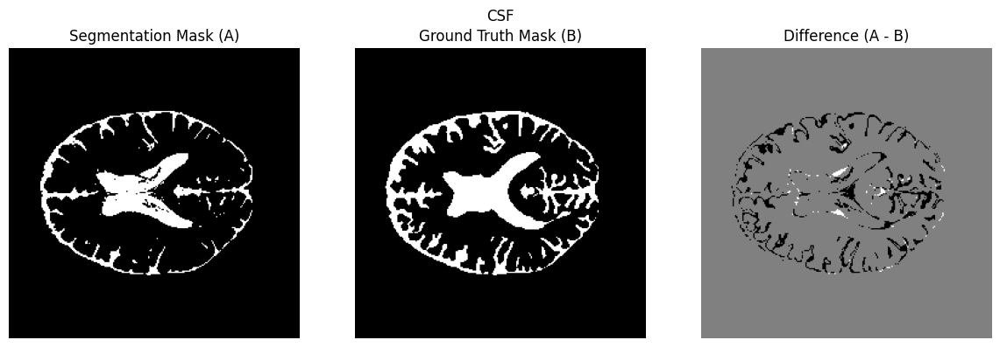

the dice score for this CSF is: 0.76


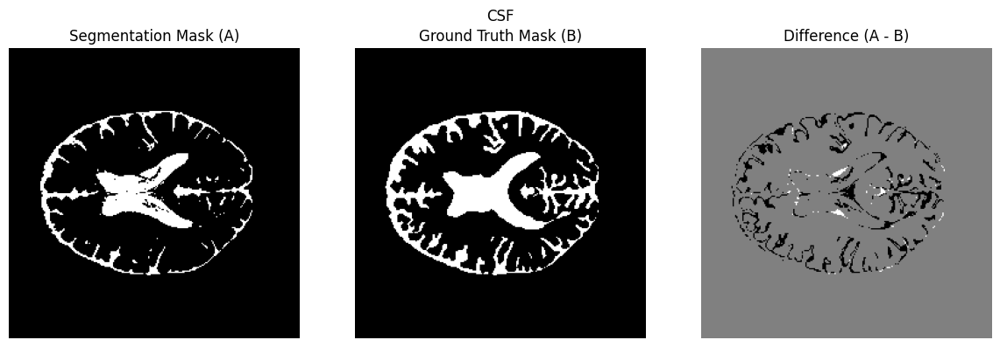

the dice score for this CSF is: 0.76


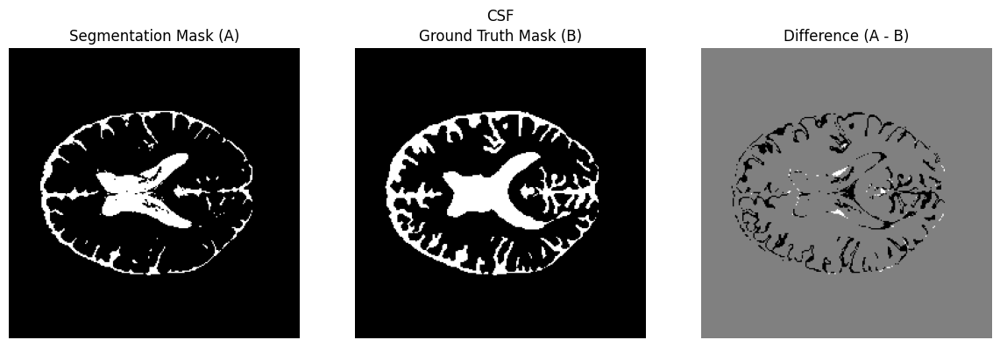

the dice score for this CSF is: 0.74


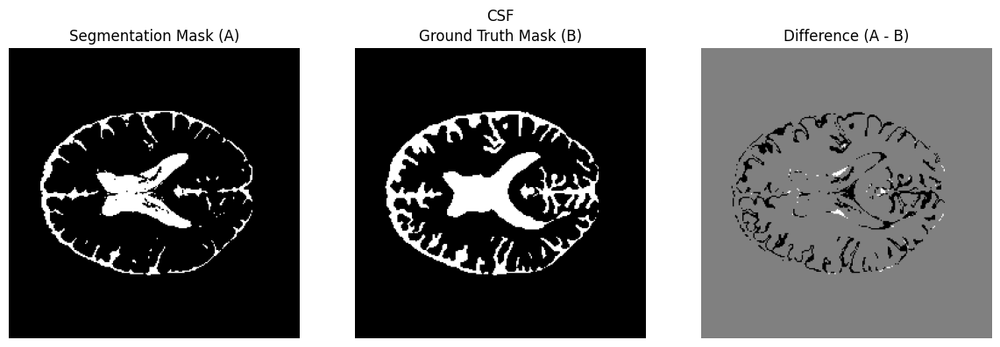

the dice score for this CSF is: 0.73


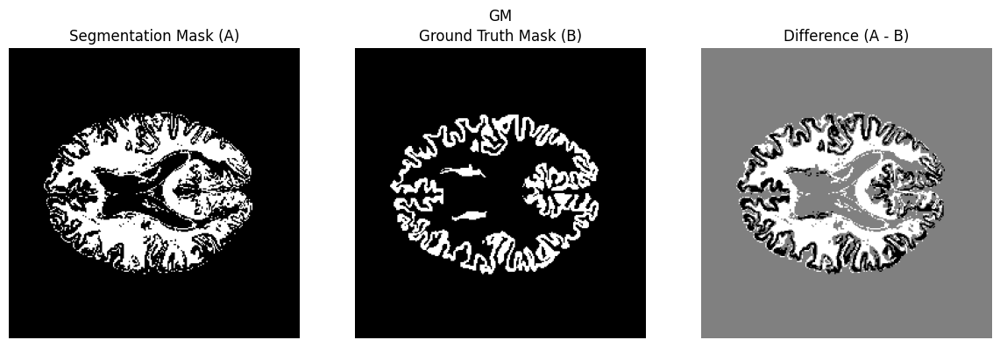

the dice score for this GM is: 0.39


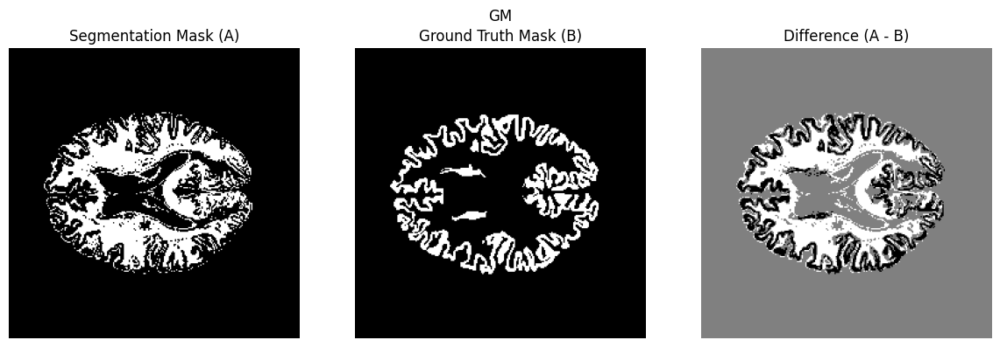

the dice score for this GM is: 0.35


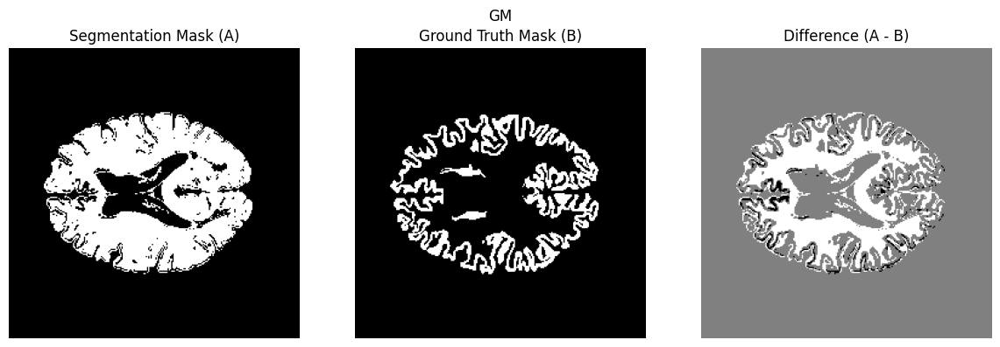

the dice score for this GM is: 0.58


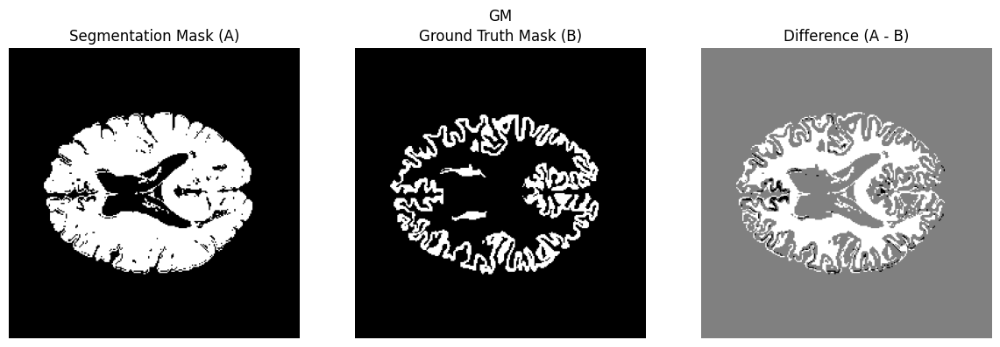

the dice score for this GM is: 0.61


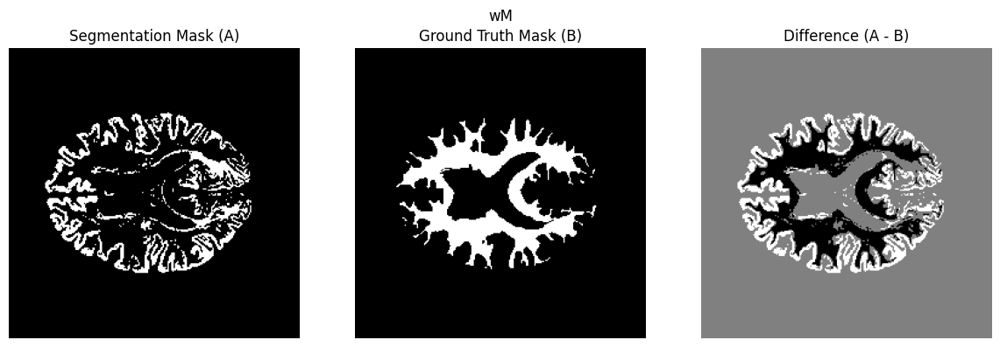

the dice score for this WM is: 0.10


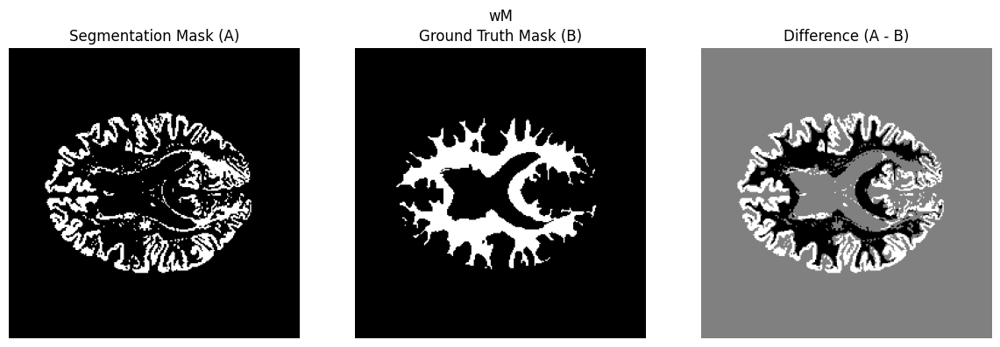

the dice score for this WM is: 0.12


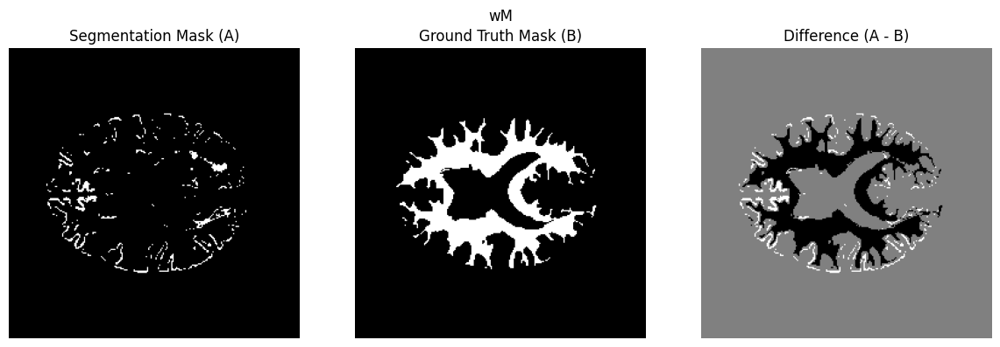

the dice score for this WM is: 0.02


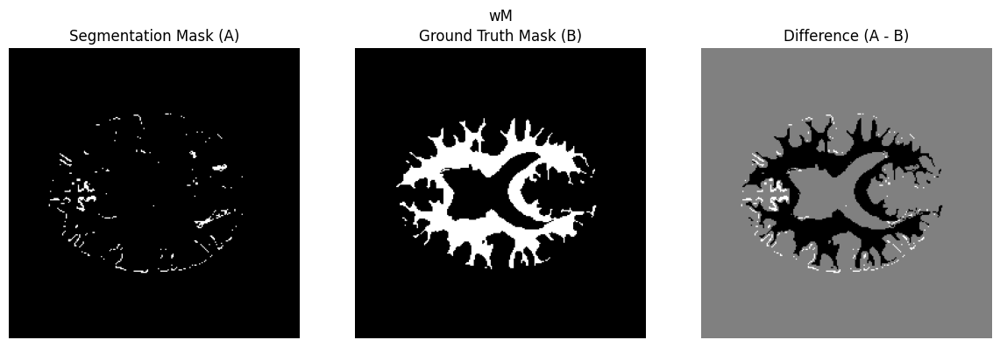

the dice score for this WM is: 0.01


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't2', 24)

[[ 41.49446806  62.5195564 ]
 [125.53226624 178.8761628 ]
 [206.5137892  155.11004432]]
[[ 51.48708234  86.58346807]
 [155.86216073 177.70571469]
 [218.22842867 151.76007829]]


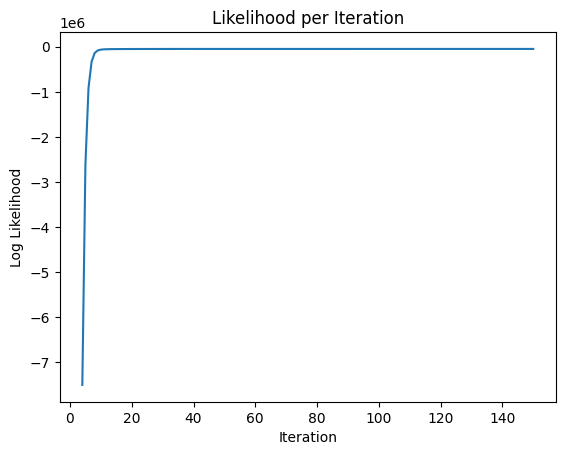


 k-means initialization custom gmm, t1 took 35 sec.
[[ 41.66224755  62.97078855]
 [126.42728478 179.01383502]
 [207.04104201 154.86048457]]
[[ 51.48708246  86.58346824]
 [155.86216123 177.7057145 ]
 [218.22842884 151.76007824]]


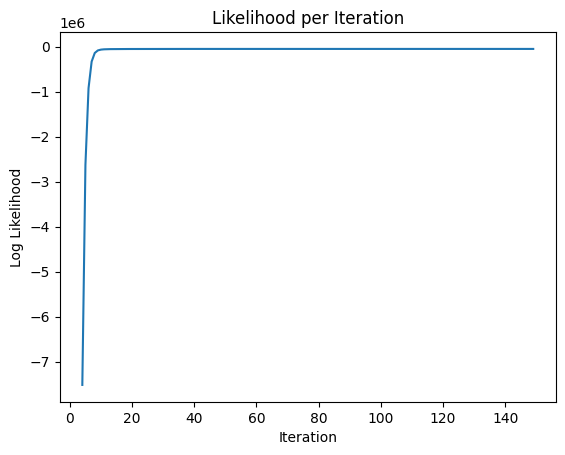


 k-means initialization scipy gmm, t1 took 36 sec.
[[  5   5]
 [135 135]
 [175 175]]
[[ 24  41]
 [ 80 129]
 [183 166]]


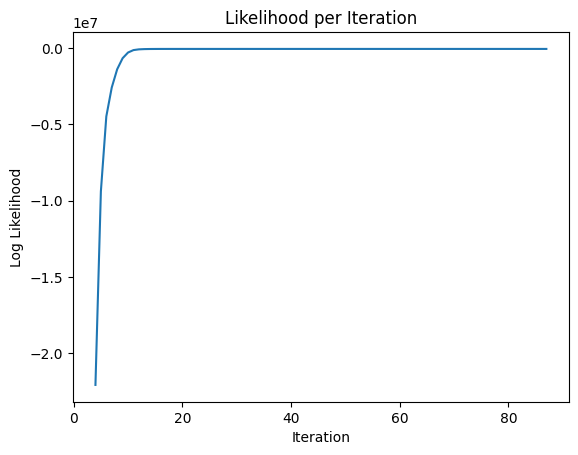


 random initialization custom gmm, with t1 took 21 sec.
[[ 84  84]
 [166 166]
 [192 192]]
[[ 49  83]
 [154 177]
 [218 151]]


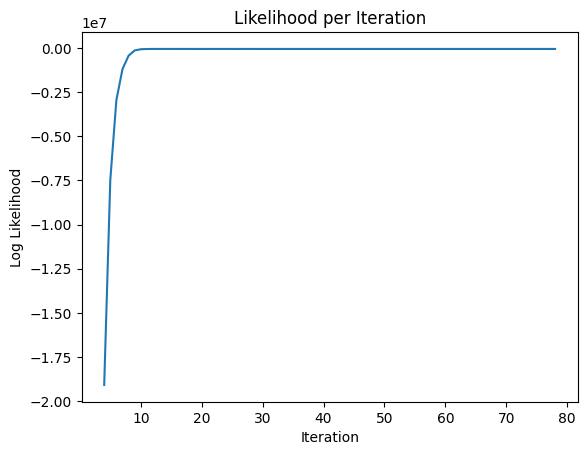


 random initialization scipy gmm, with t1 took 18 sec.


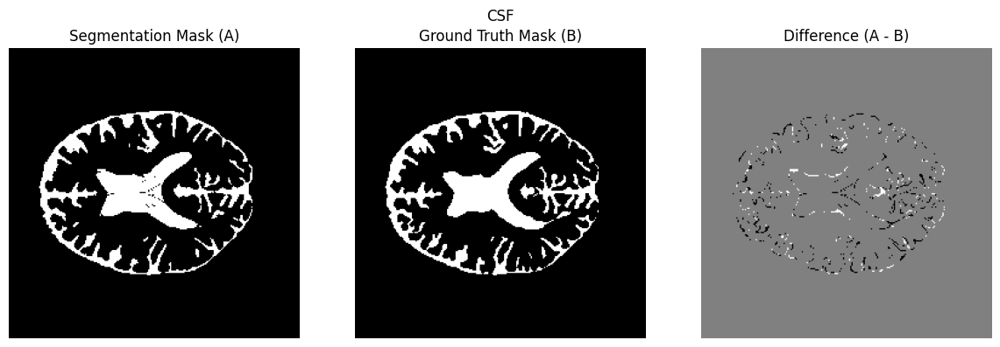

the dice score for this CSF is: 0.90


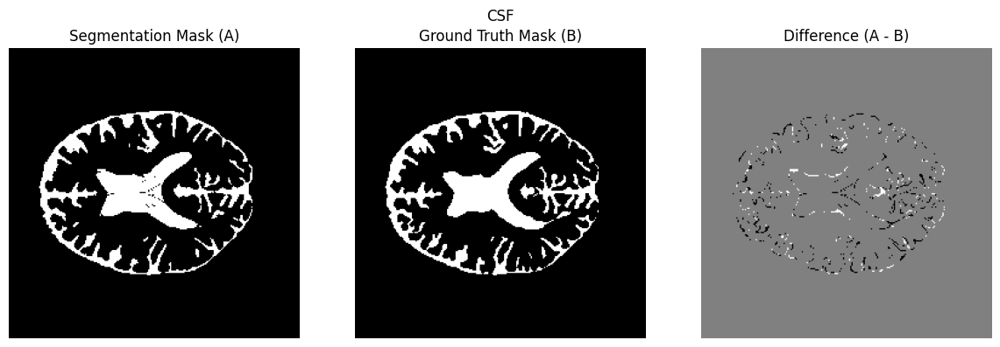

the dice score for this CSF is: 0.90


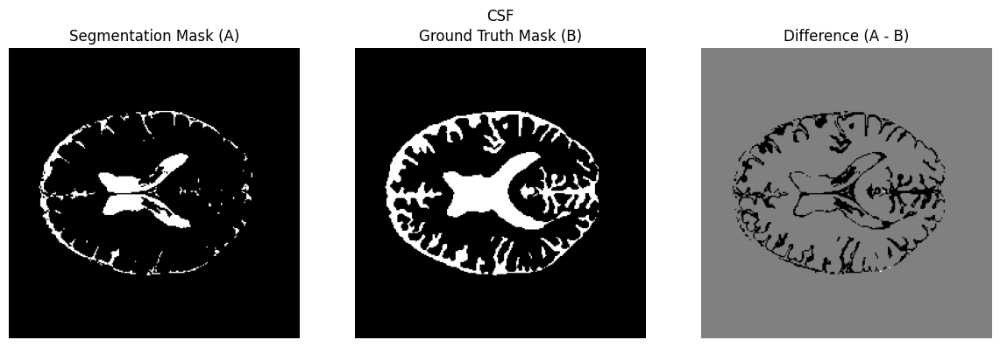

the dice score for this CSF is: 0.55


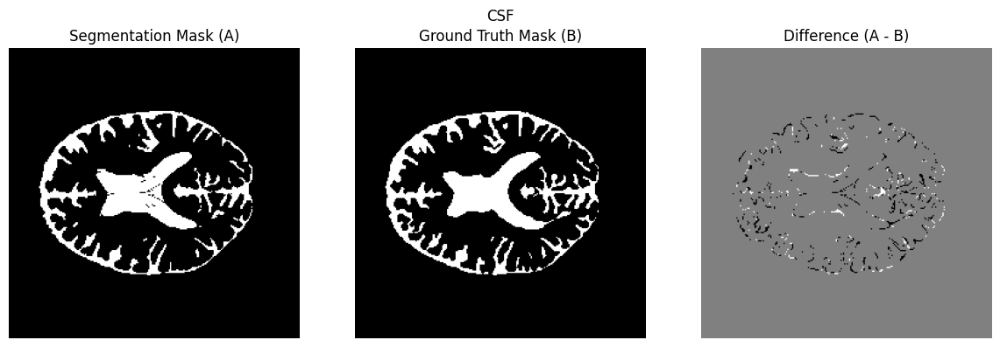

the dice score for this CSF is: 0.90


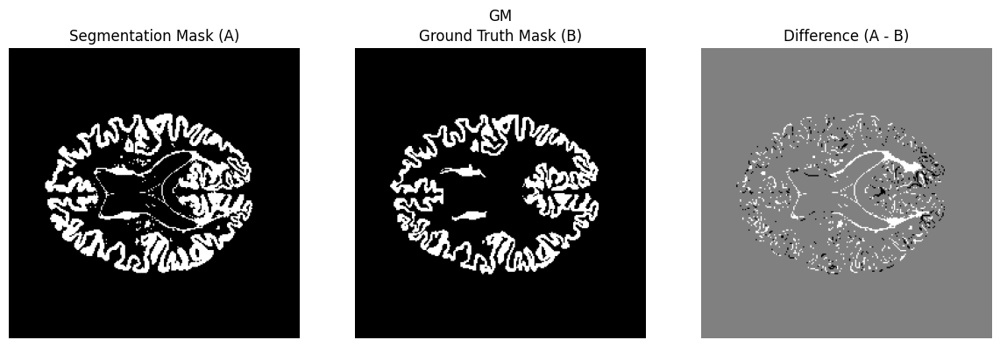

the dice score for this GM is: 0.83


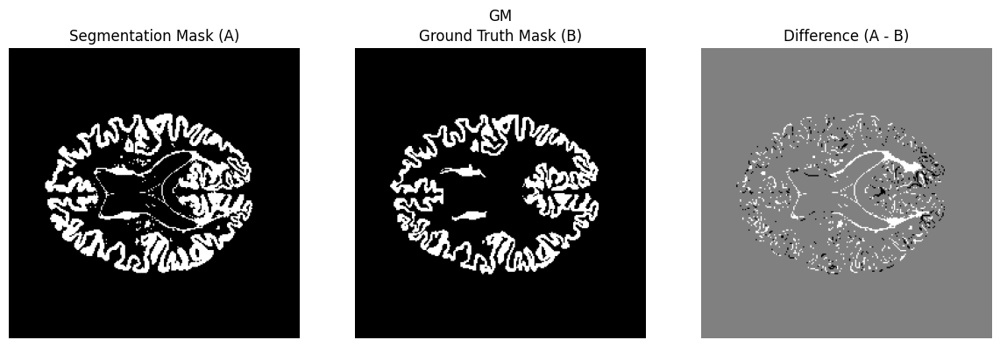

the dice score for this GM is: 0.83


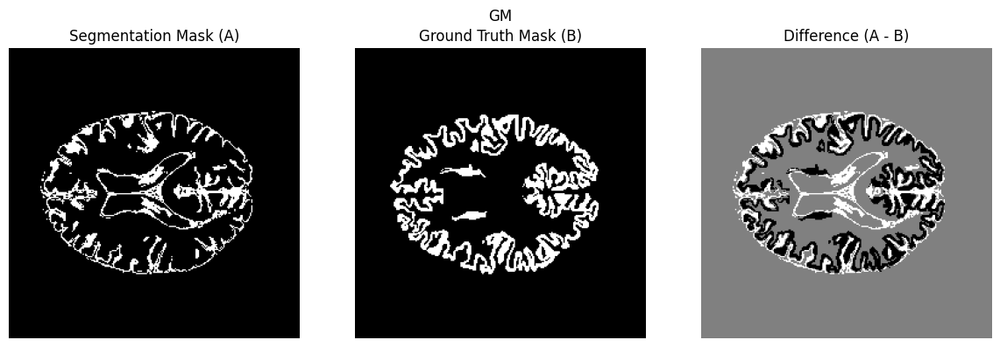

the dice score for this GM is: 0.16


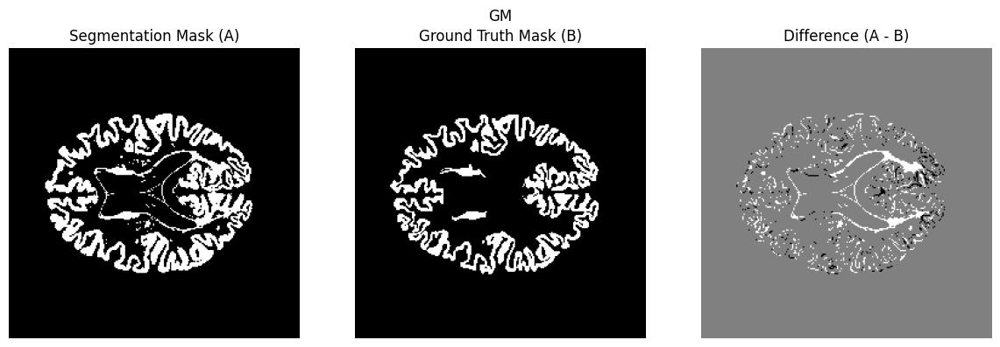

the dice score for this GM is: 0.83


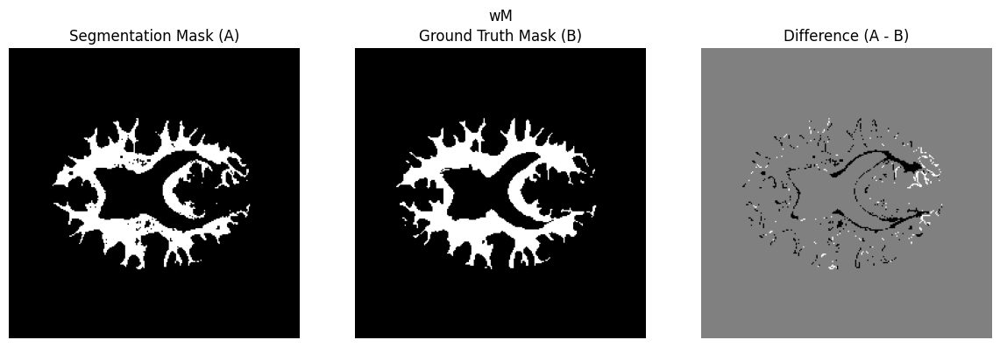

the dice score for this WM is: 0.86


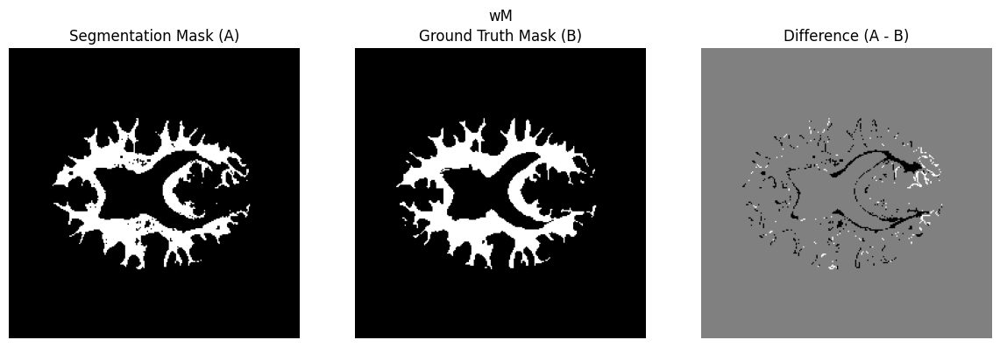

the dice score for this WM is: 0.86


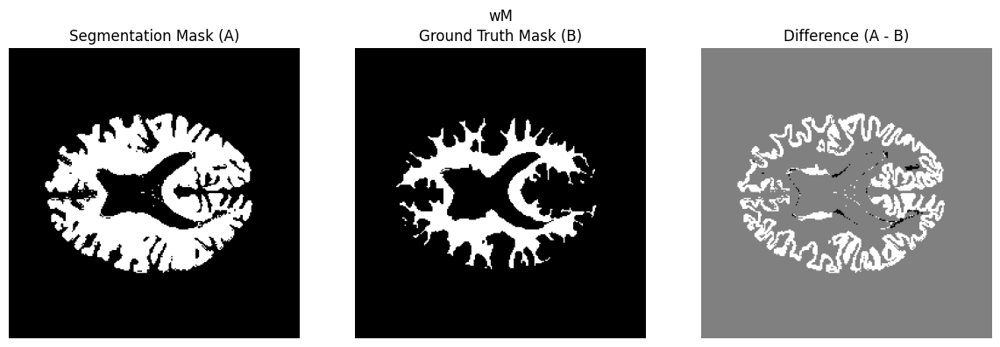

the dice score for this WM is: 0.61


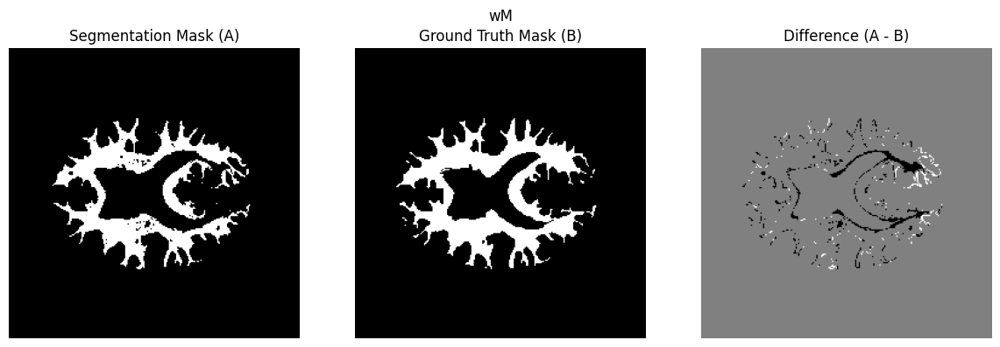

the dice score for this WM is: 0.86


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 'mv', 24)

#case 2

[[ 38.85956226]
 [119.78440258]
 [176.33180958]]
[[ 39.01273987]
 [133.60386678]
 [185.36400159]]


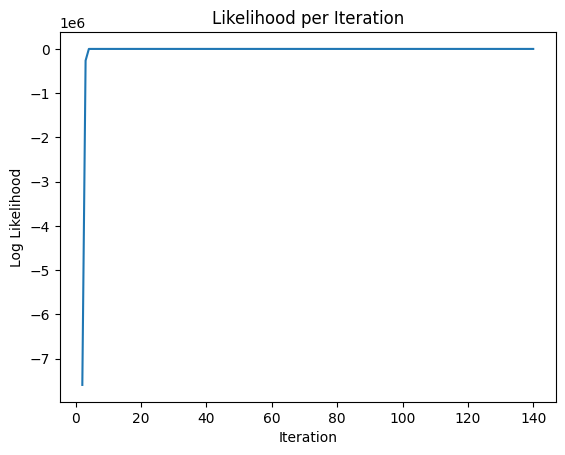


 k-means initialization custom gmm, t1 took 22 sec.
[[ 38.8798506 ]
 [119.87159589]
 [176.40000376]]
[[ 39.01273821]
 [133.60386668]
 [185.364002  ]]


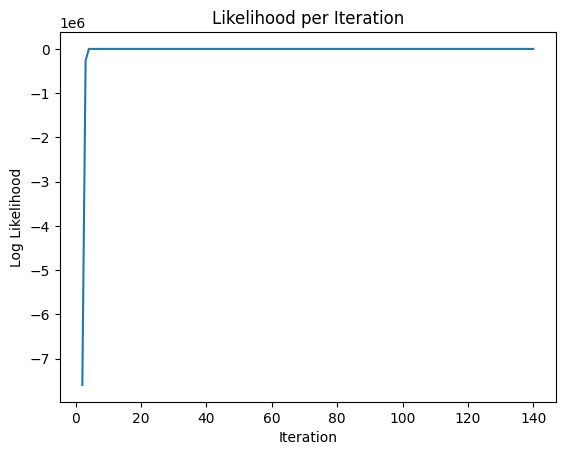


 k-means initialization scipy gmm, t1 took 19 sec.
[[ 82]
 [185]
 [199]]
[[ 38]
 [131]
 [184]]


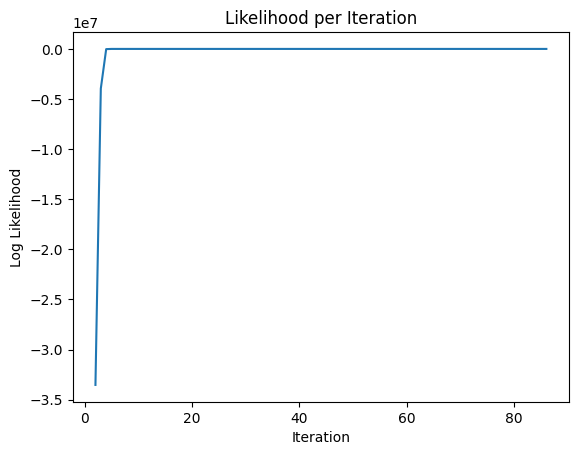


 random initialization custom gmm, with t1 took 12 sec.
[[ 24]
 [ 67]
 [179]]
[[ 25]
 [ 76]
 [157]]


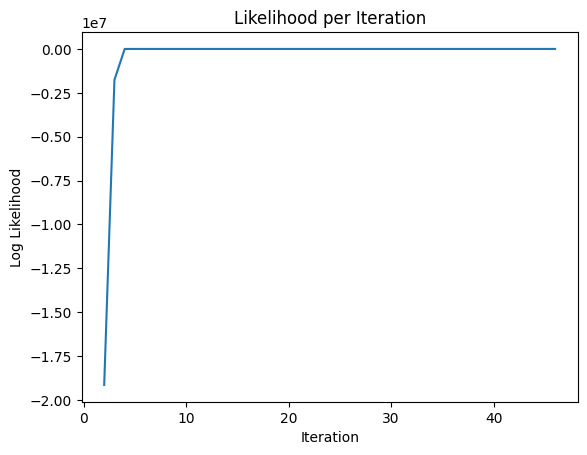


 random initialization scipy gmm, with t1 took 7 sec.


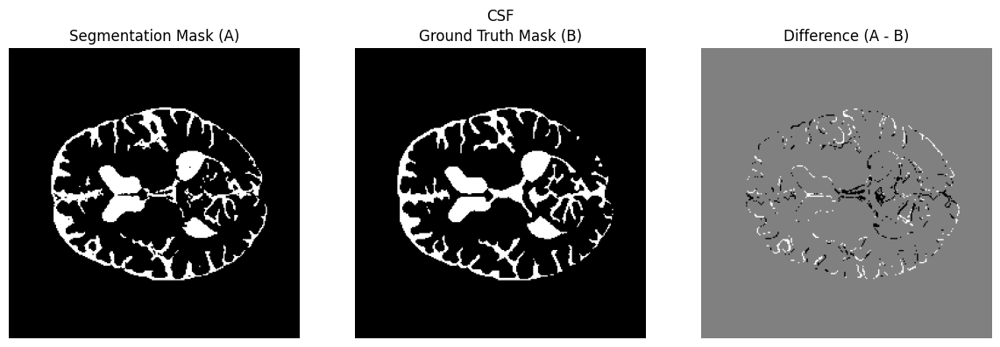

the dice score for this CSF is: 0.87


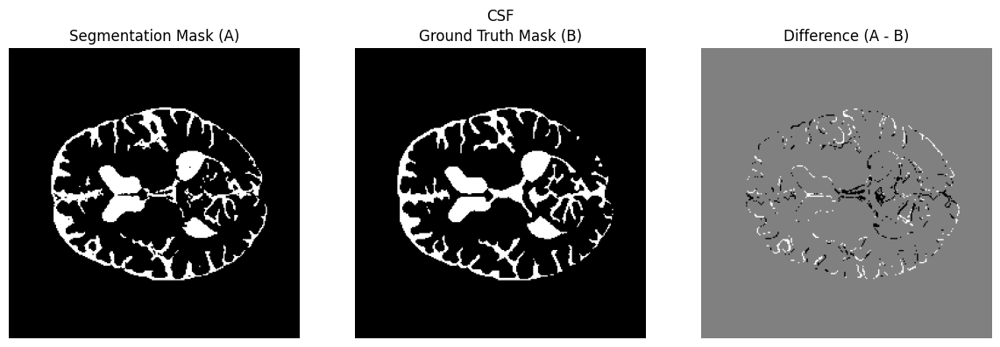

the dice score for this CSF is: 0.87


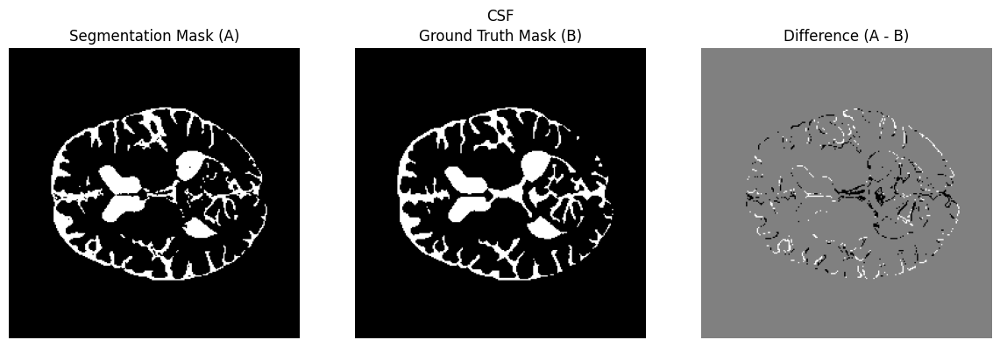

the dice score for this CSF is: 0.87


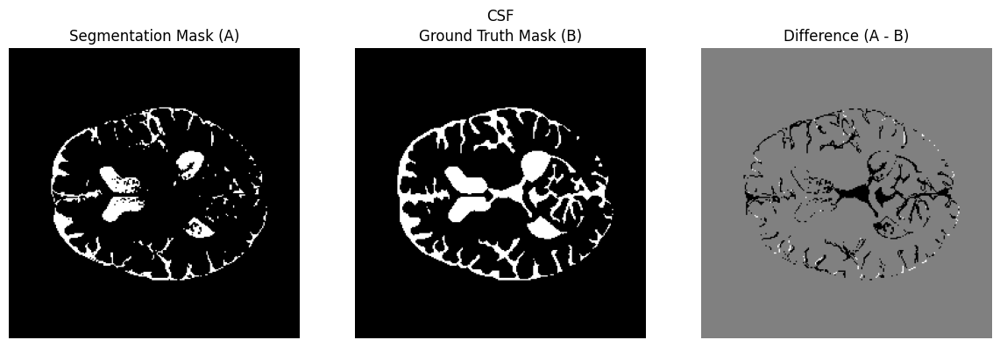

the dice score for this CSF is: 0.71


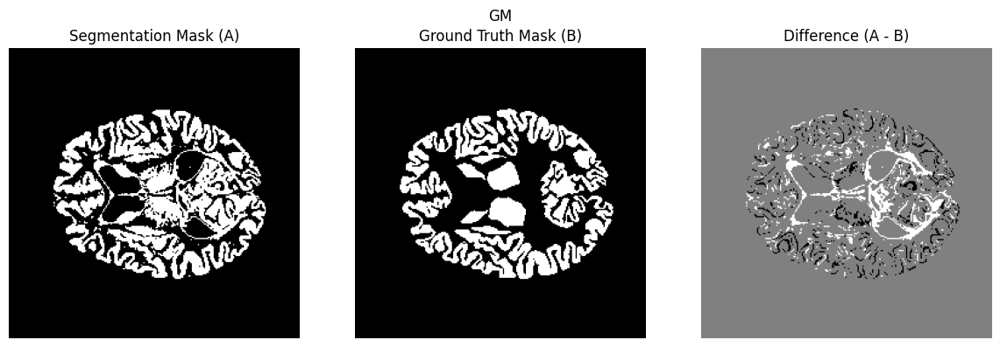

the dice score for this GM is: 0.81


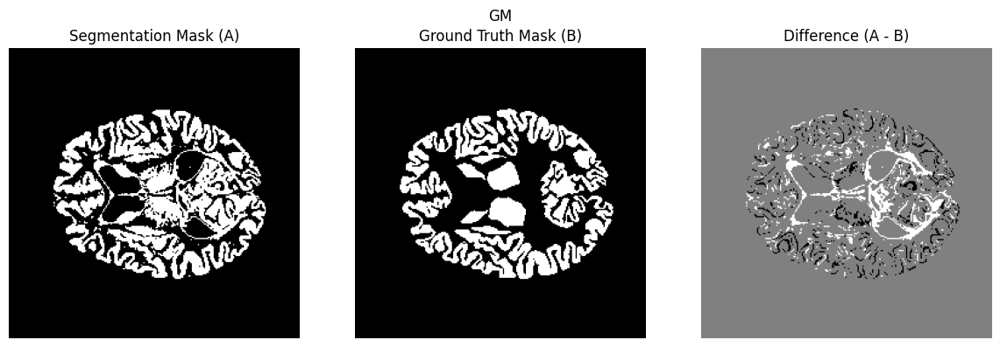

the dice score for this GM is: 0.81


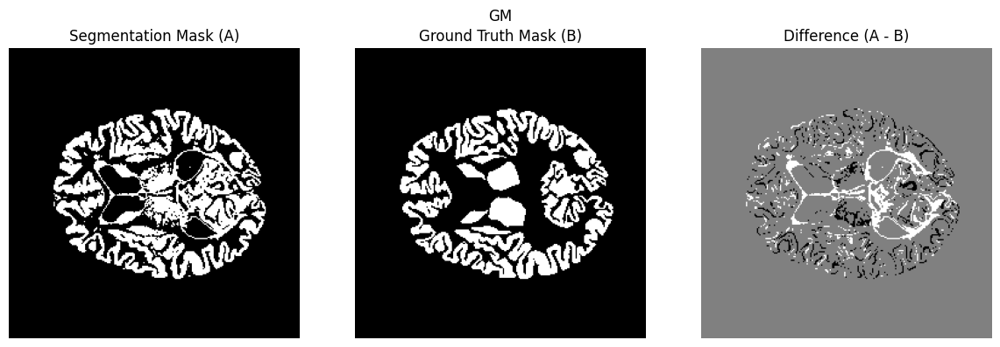

the dice score for this GM is: 0.81


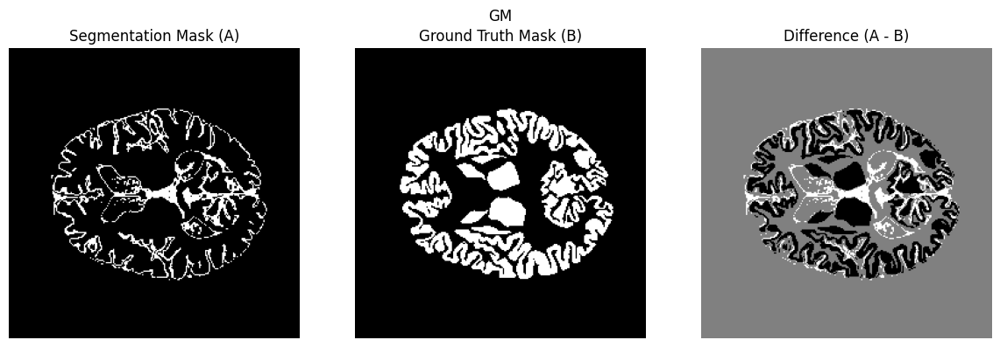

the dice score for this GM is: 0.28


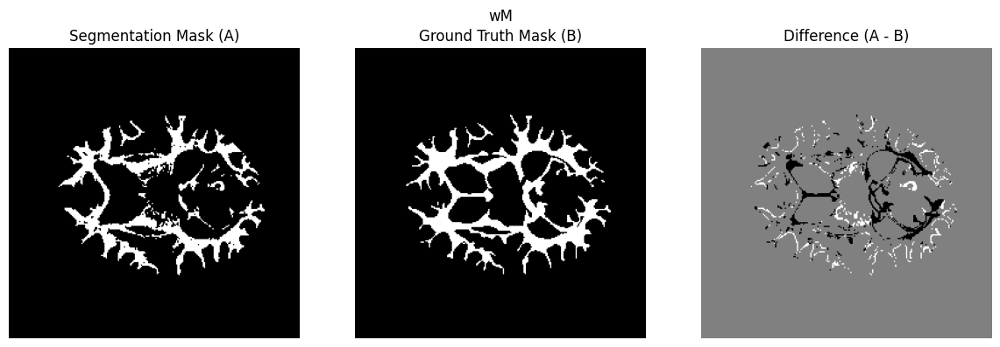

the dice score for this WM is: 0.78


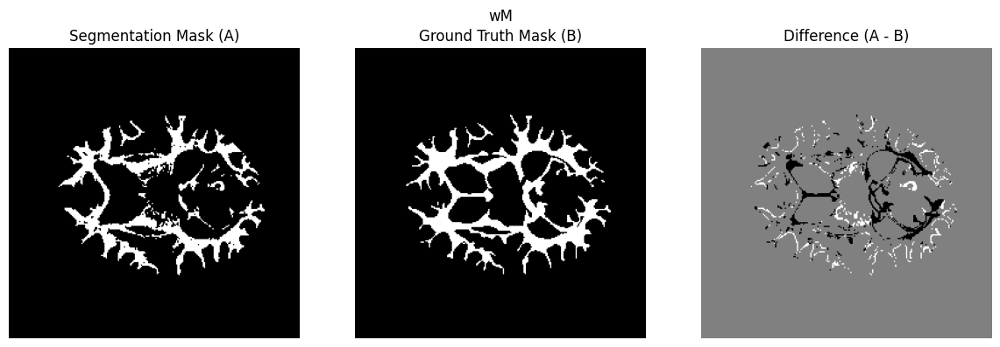

the dice score for this WM is: 0.78


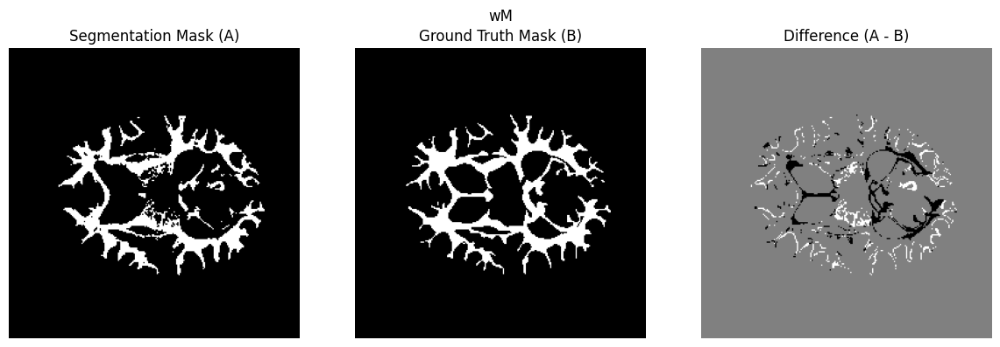

the dice score for this WM is: 0.79


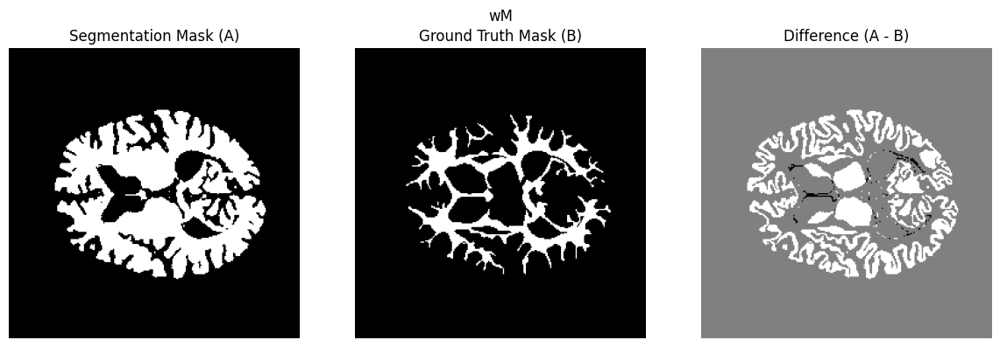

the dice score for this WM is: 0.59


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't1', 24)

[[ 38.1382624 ]
 [112.31498183]
 [175.78760631]]
[[ 26.14565587]
 [ 91.77893675]
 [172.12200748]]


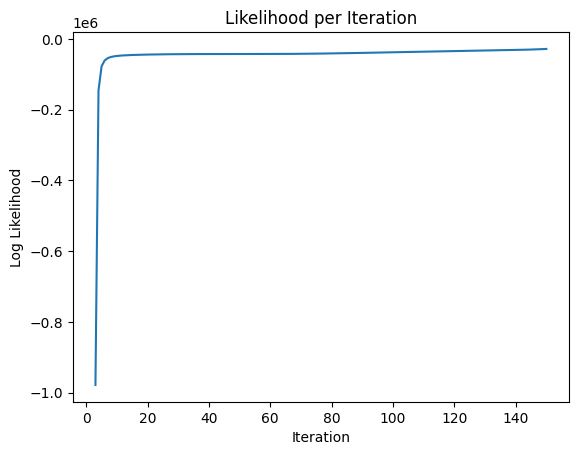


 k-means initialization custom gmm, t1 took 21 sec.
[[ 38.02232511]
 [112.06188162]
 [175.74979332]]
[[ 26.20677035]
 [ 93.05235007]
 [172.2090923 ]]


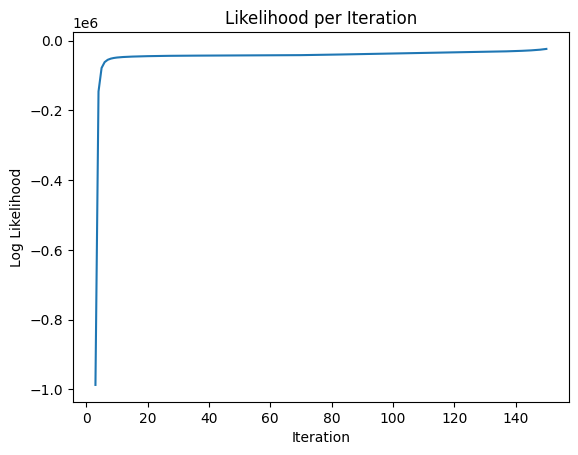


 k-means initialization scipy gmm, t1 took 22 sec.
[[ 98]
 [117]
 [128]]
[[ 23]
 [ 84]
 [171]]


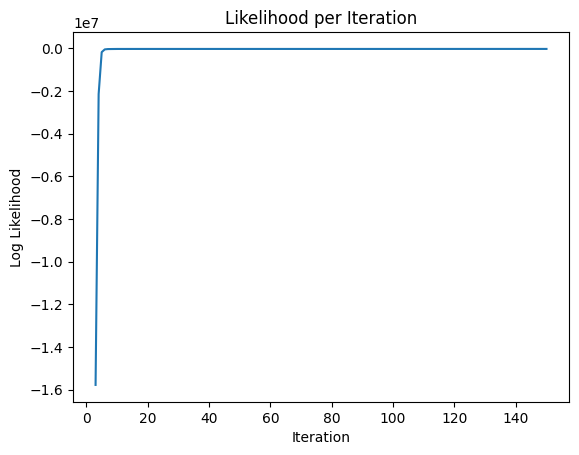


 random initialization custom gmm, with t1 took 20 sec.
[[187]
 [191]
 [235]]
[[105]
 [172]
 [173]]


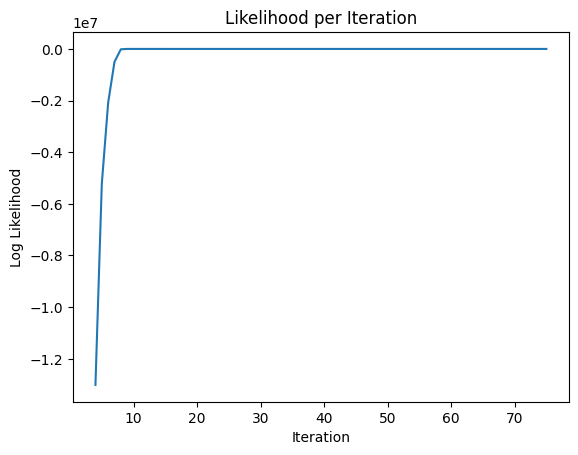


 random initialization scipy gmm, with t1 took 11 sec.


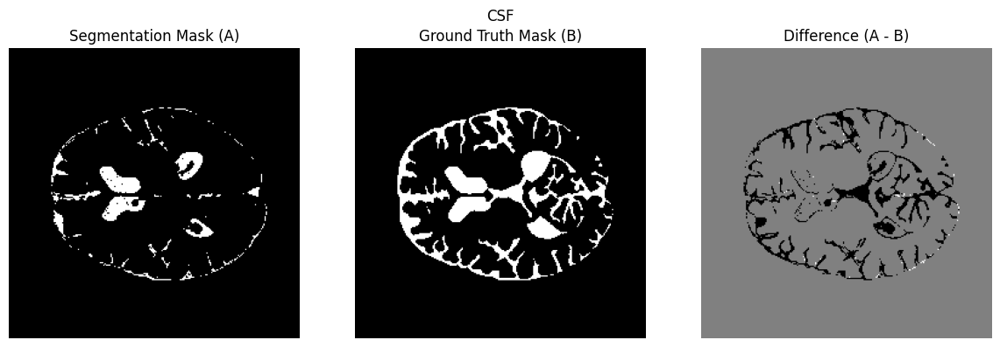

the dice score for this CSF is: 0.49


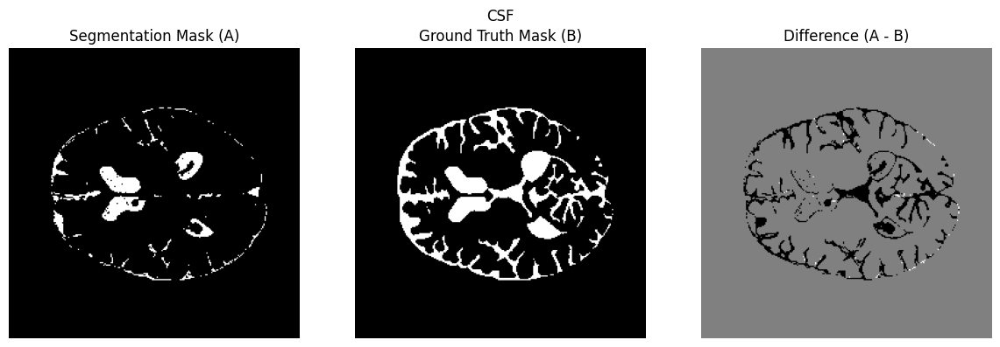

the dice score for this CSF is: 0.49


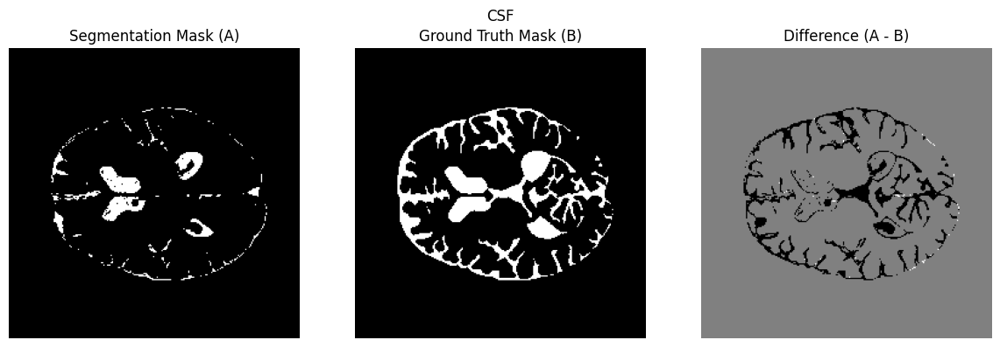

the dice score for this CSF is: 0.44


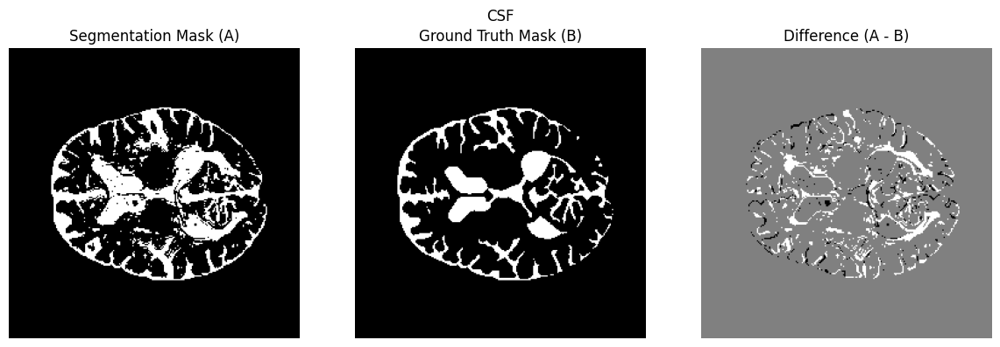

the dice score for this CSF is: 0.78


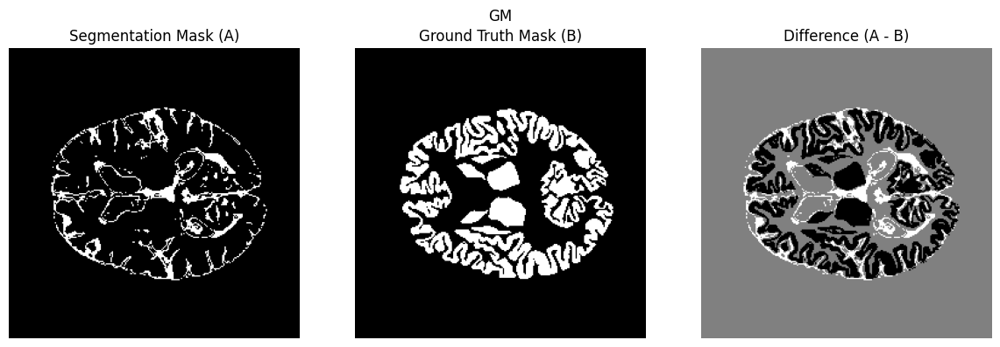

the dice score for this GM is: 0.13


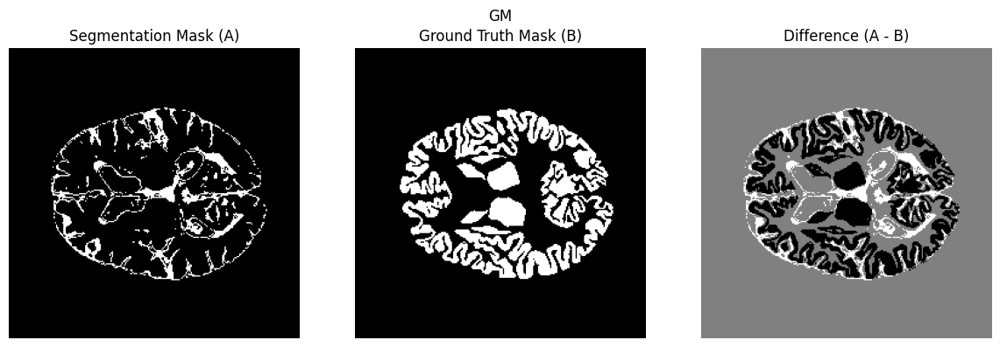

the dice score for this GM is: 0.13


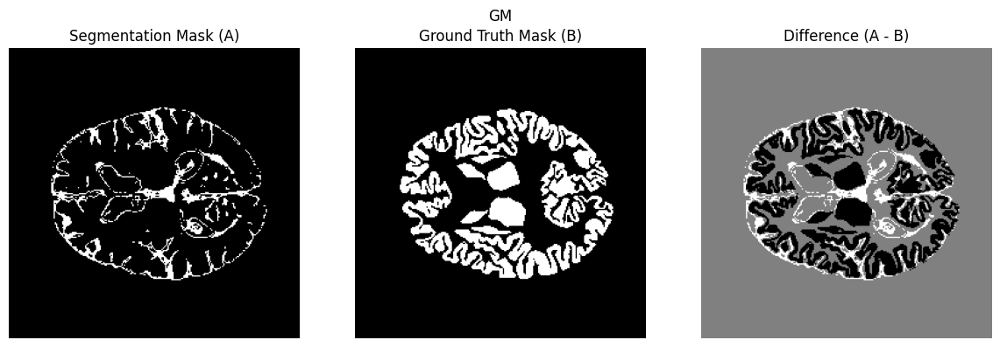

the dice score for this GM is: 0.11


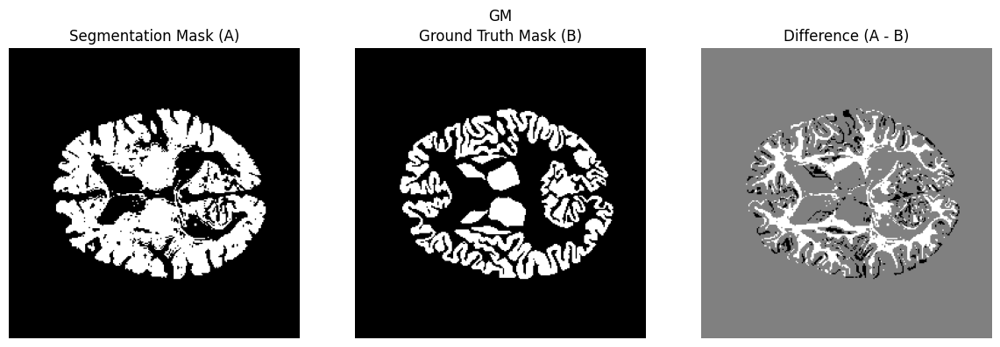

the dice score for this GM is: 0.69


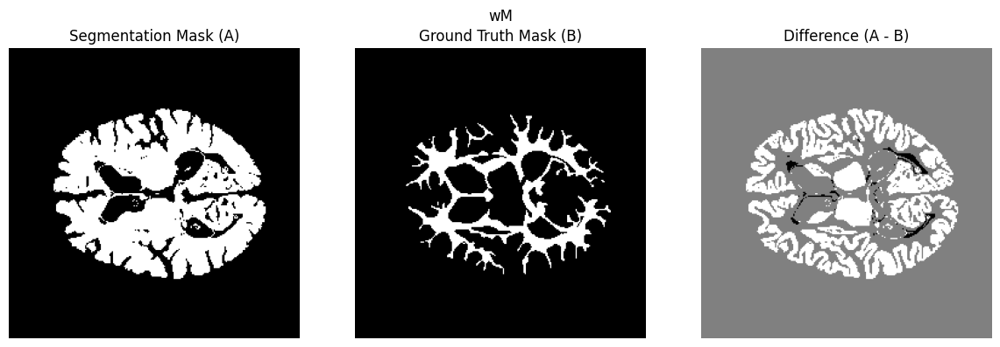

the dice score for this WM is: 0.52


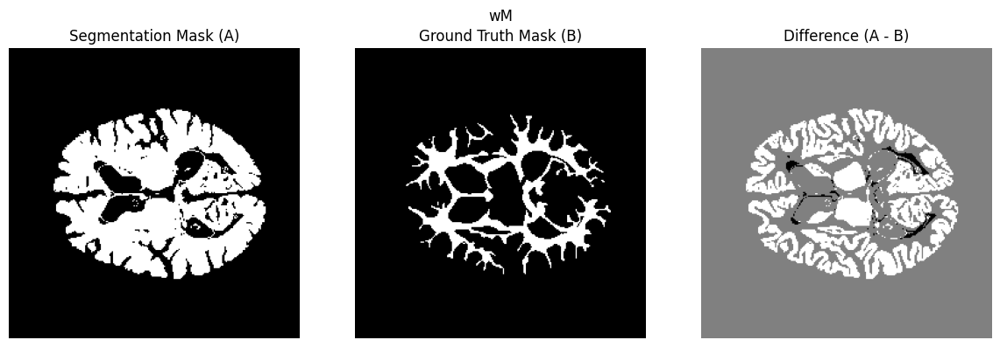

the dice score for this WM is: 0.52


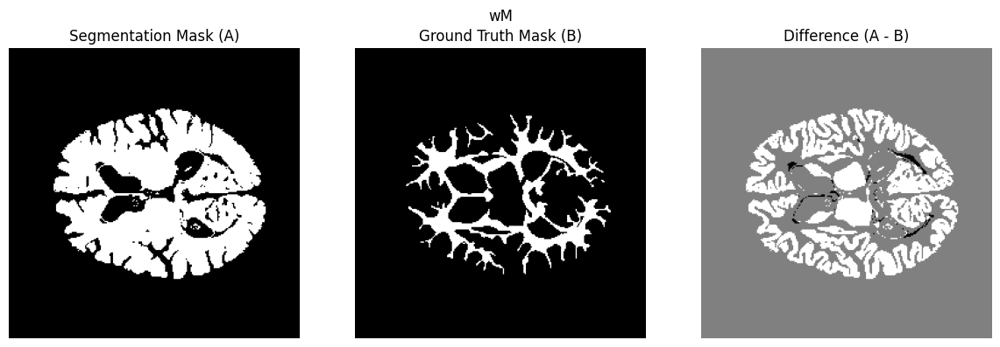

the dice score for this WM is: 0.52


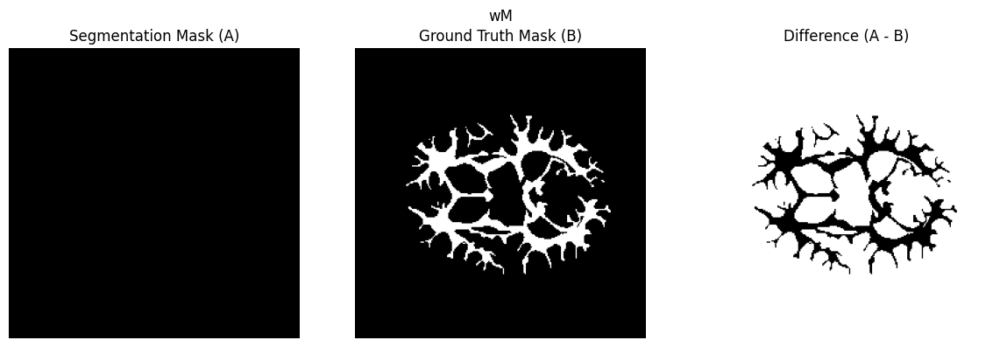

the dice score for this WM is: 0.00


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't2', 24)

[[ 34.19843446  48.40265072]
 [ 80.35625052 141.15845464]
 [158.80090222 175.71294392]]
[[ 30.88343253  41.49156073]
 [ 88.80754256 143.32729512]
 [159.7647625  172.43898664]]


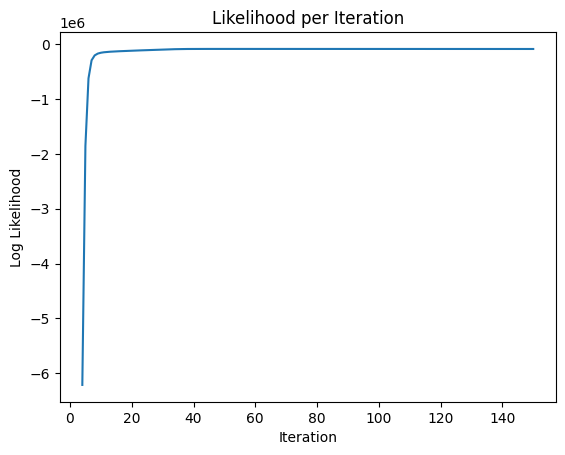


 k-means initialization custom gmm, t1 took 38 sec.
[[ 34.20798415  48.43449692]
 [ 80.41131424 141.21548706]
 [158.81580186 175.71522878]]
[[ 30.88361066  41.49233064]
 [ 88.80855252 143.32835542]
 [159.76486879 172.4389668 ]]


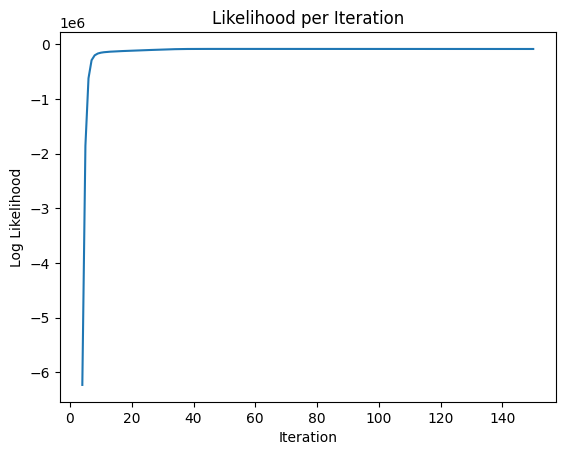


 k-means initialization scipy gmm, t1 took 38 sec.
[[ 58  58]
 [148 148]
 [177 177]]
[[ 30  38]
 [ 85 139]
 [159 172]]


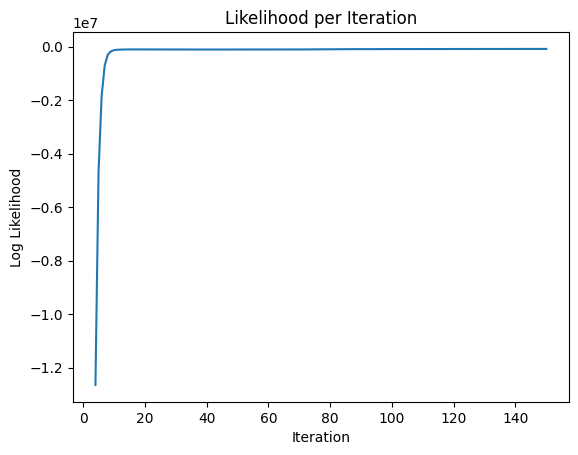


 random initialization custom gmm, with t1 took 39 sec.
[[ 86  86]
 [118 118]
 [223 223]]
[[ 45  78]
 [152 172]
 [204 213]]


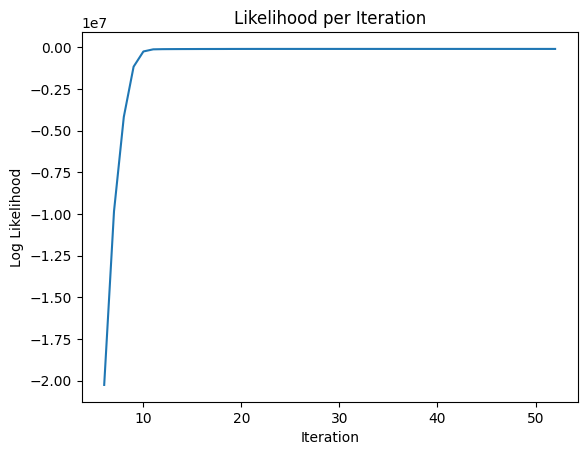


 random initialization scipy gmm, with t1 took 14 sec.


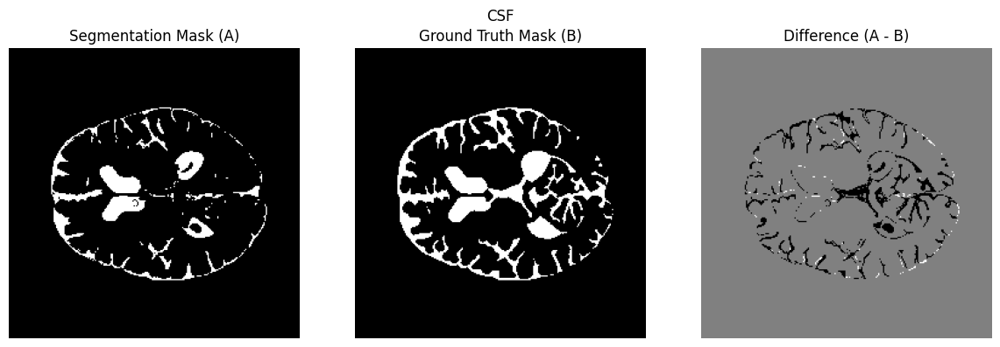

the dice score for this CSF is: 0.73


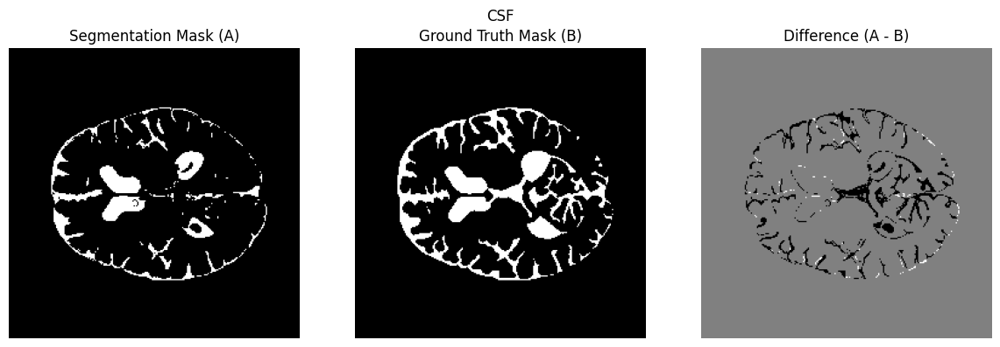

the dice score for this CSF is: 0.73


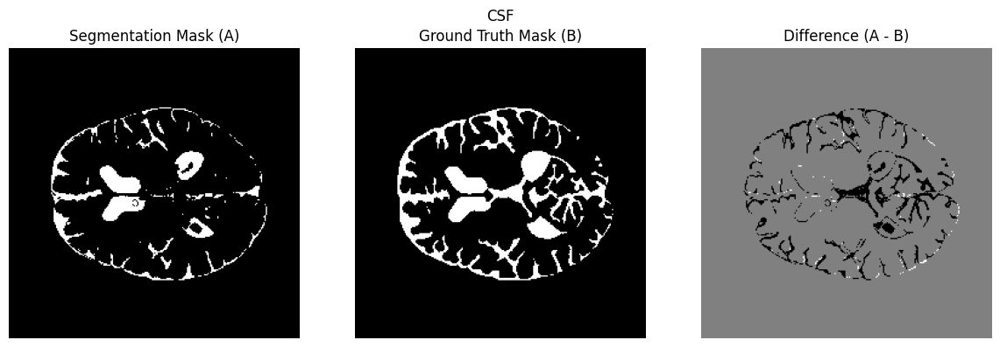

the dice score for this CSF is: 0.70


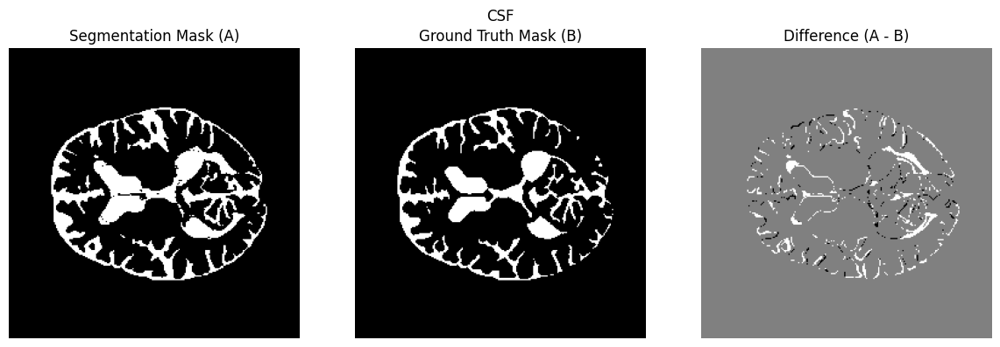

the dice score for this CSF is: 0.86


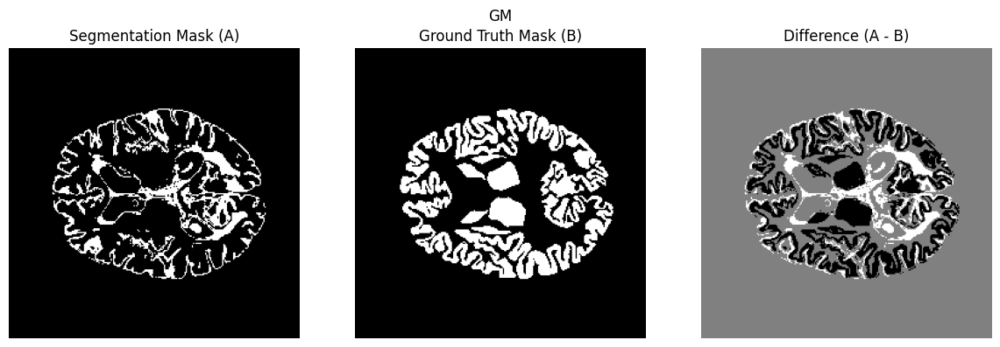

the dice score for this GM is: 0.34


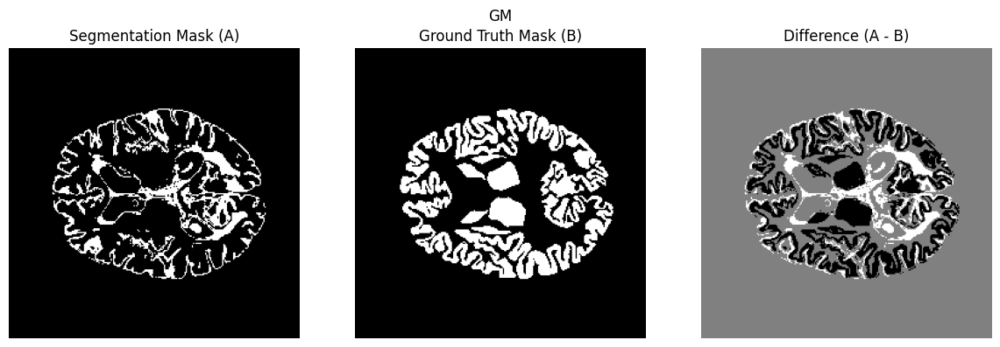

the dice score for this GM is: 0.34


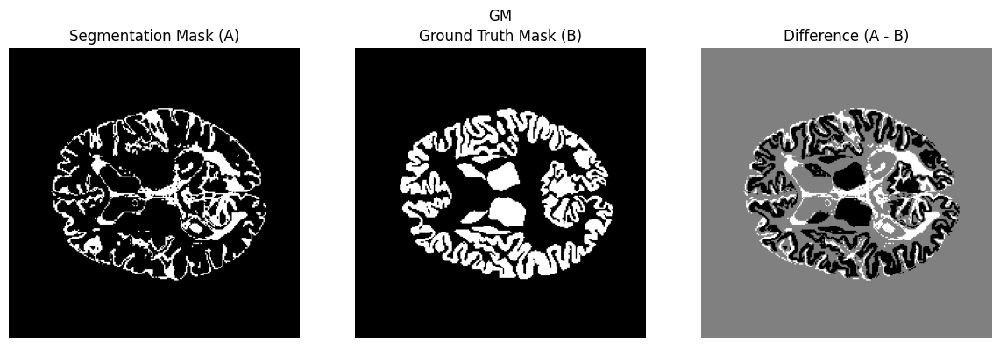

the dice score for this GM is: 0.32


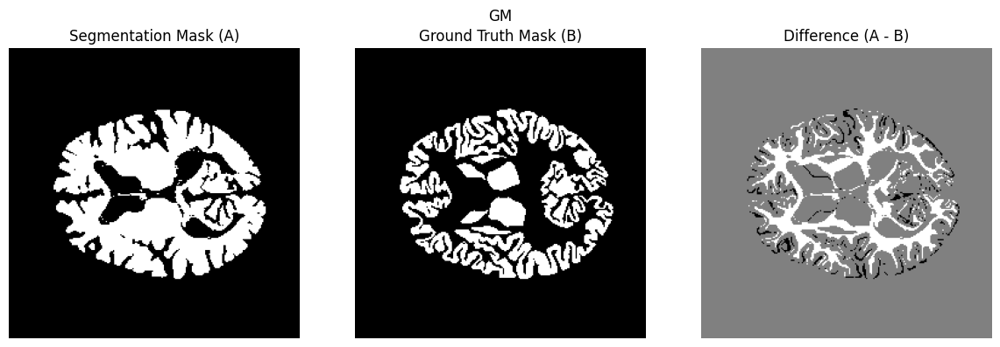

the dice score for this GM is: 0.70


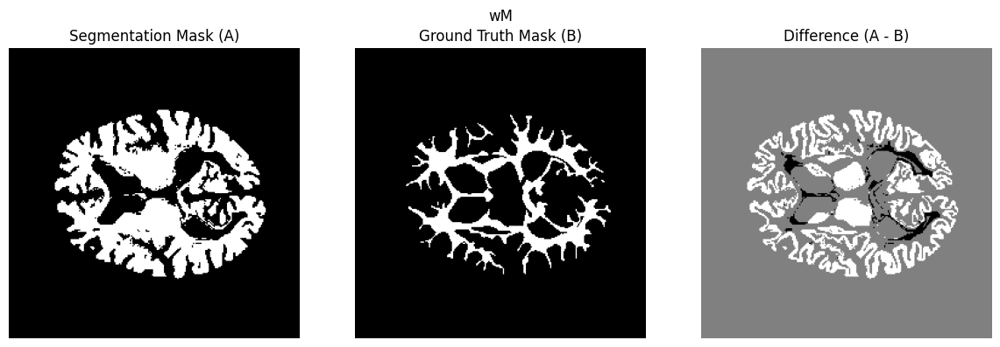

the dice score for this WM is: 0.56


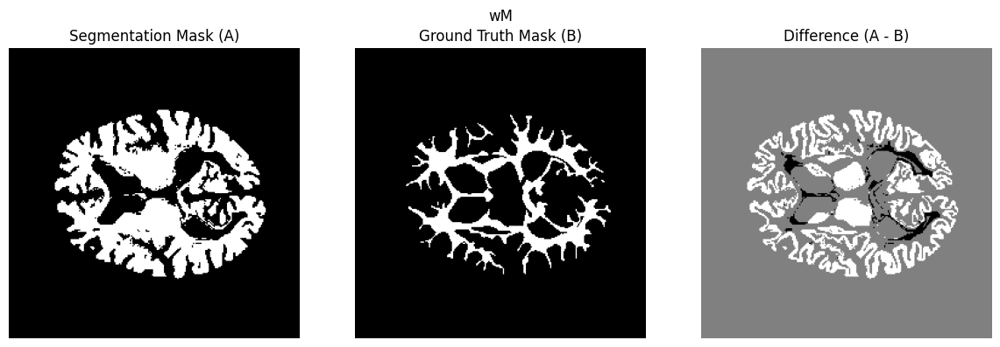

the dice score for this WM is: 0.56


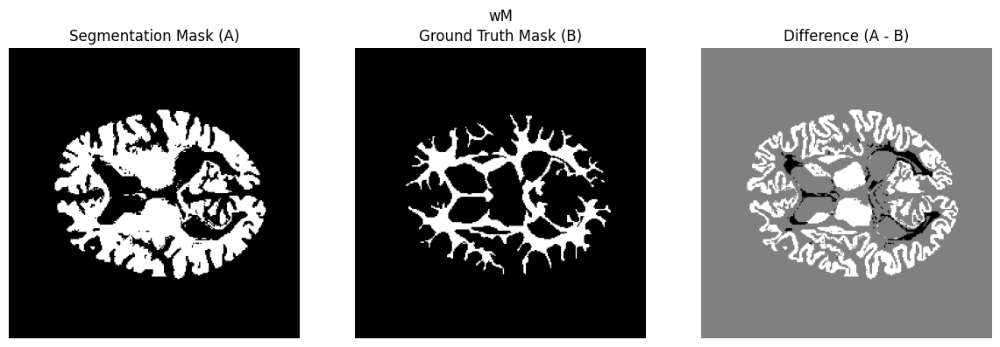

the dice score for this WM is: 0.56


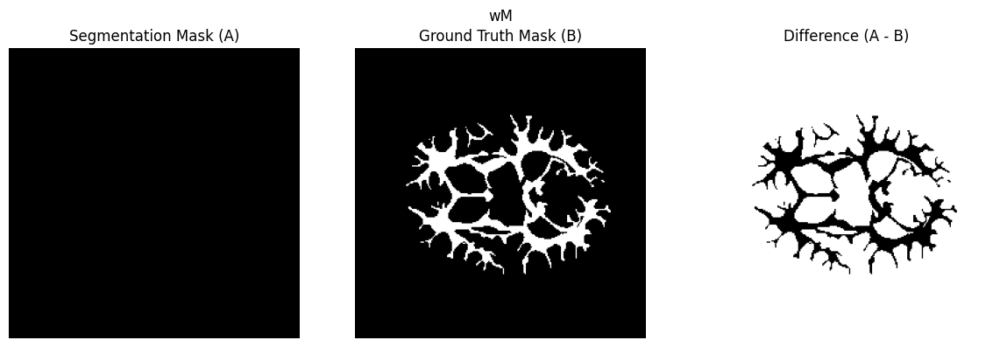

the dice score for this WM is: 0.00


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 'mv', 24)

#Case 3

[[ 49.95885848]
 [147.84387394]
 [221.80051425]]
[[ 48.21905301]
 [162.24374569]
 [231.81139321]]


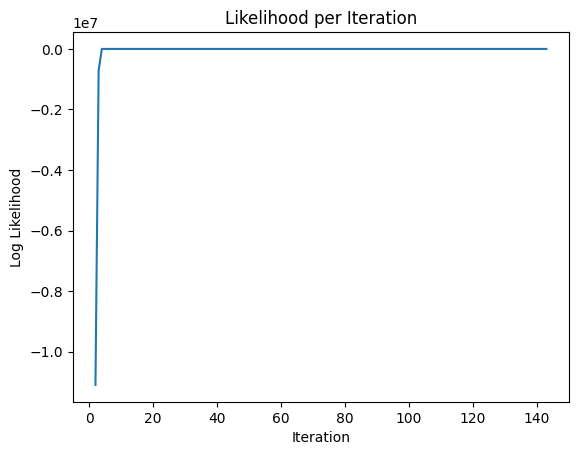


 k-means initialization custom gmm, t1 took 16 sec.
[[ 50.00564955]
 [147.86420182]
 [221.78463257]]
[[ 48.21901582]
 [162.2437229 ]
 [231.81139359]]


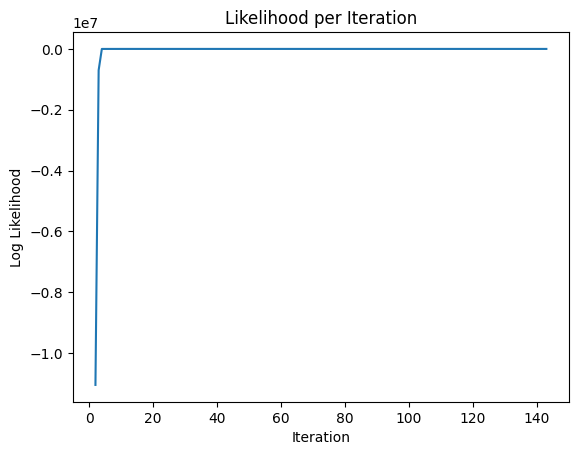


 k-means initialization scipy gmm, t1 took 19 sec.
[[ 84]
 [ 97]
 [173]]
[[ 32]
 [108]
 [202]]


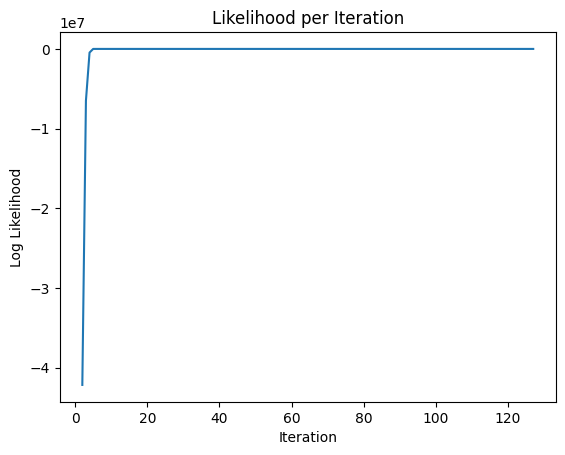


 random initialization custom gmm, with t1 took 15 sec.
[[ 10]
 [159]
 [219]]
[[ 42]
 [156]
 [230]]


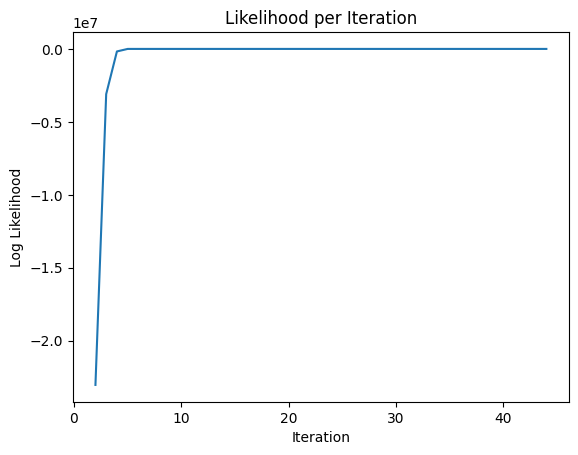


 random initialization scipy gmm, with t1 took 5 sec.


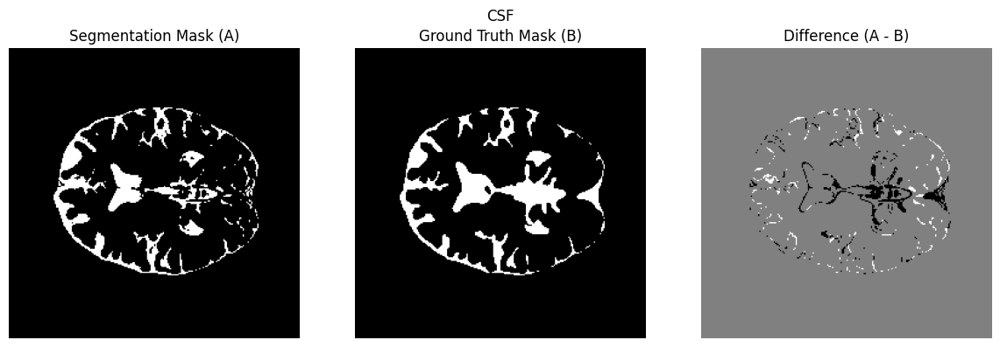

the dice score for this CSF is: 0.83


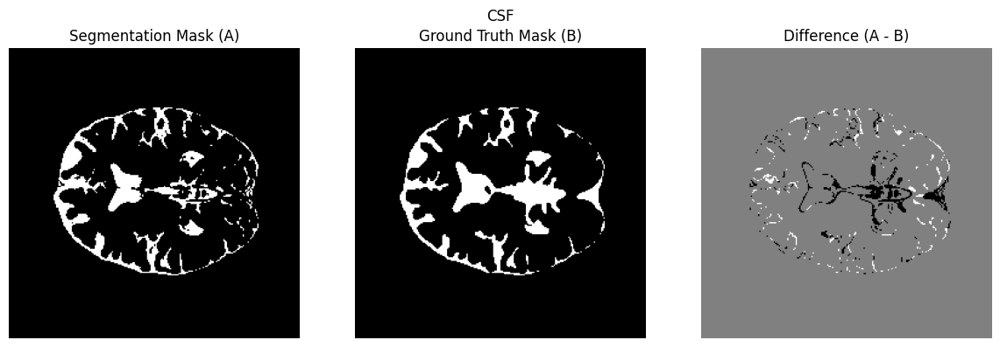

the dice score for this CSF is: 0.83


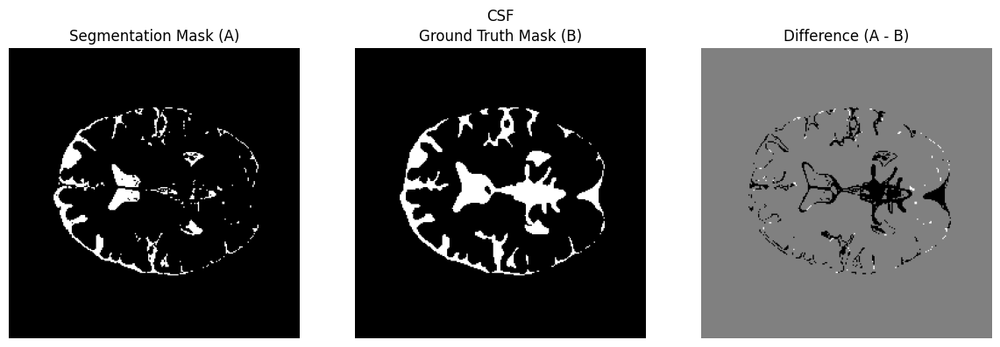

the dice score for this CSF is: 0.63


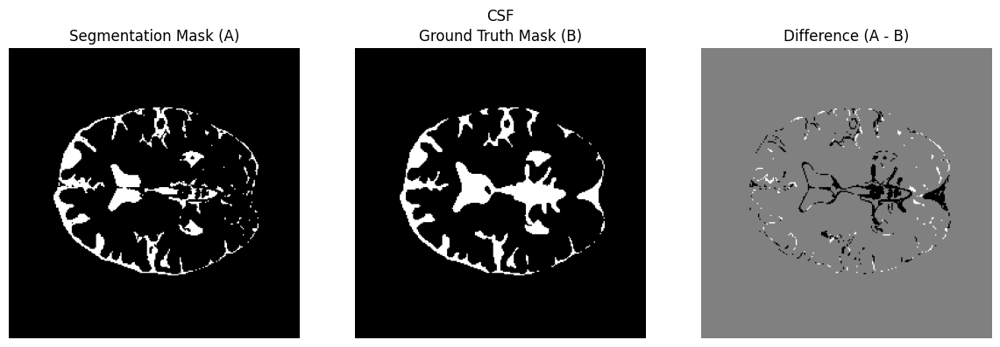

the dice score for this CSF is: 0.78


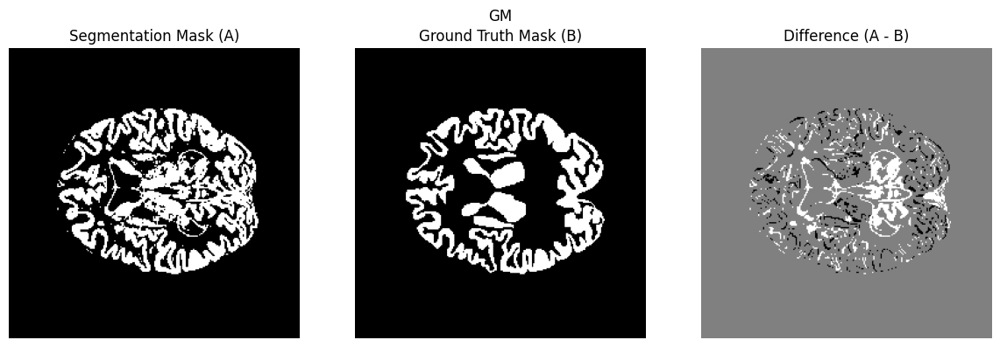

the dice score for this GM is: 0.79


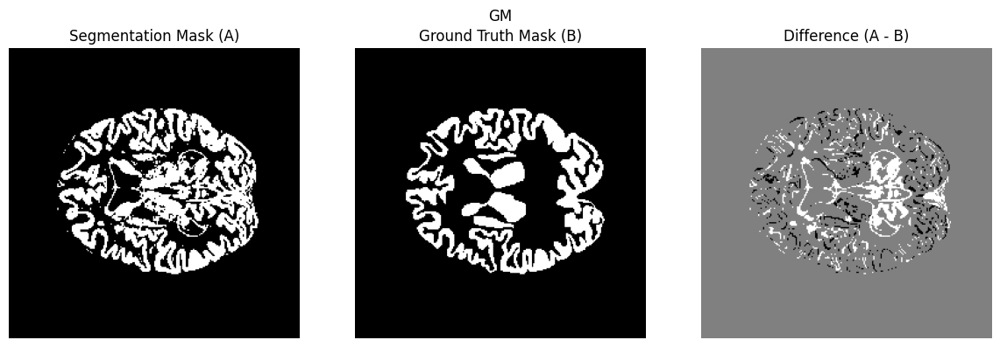

the dice score for this GM is: 0.79


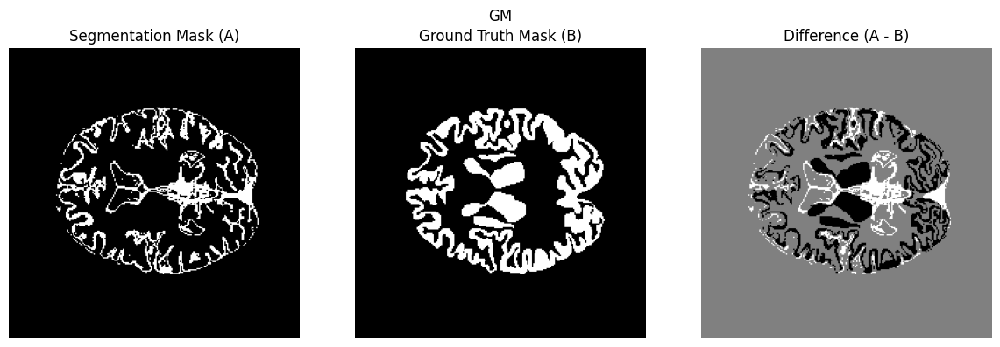

the dice score for this GM is: 0.36


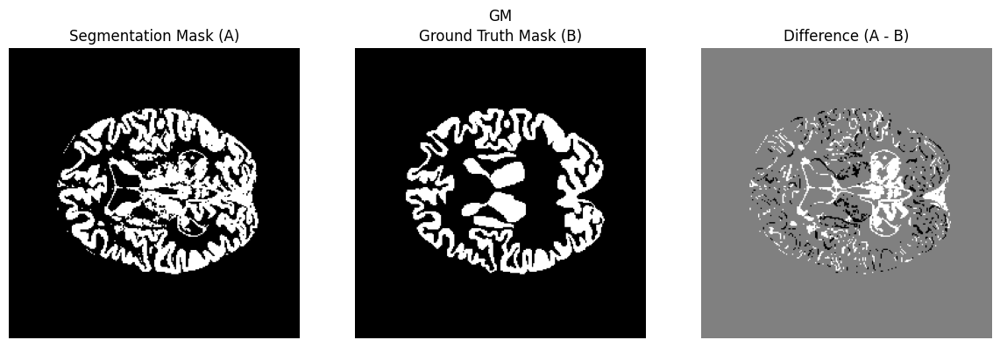

the dice score for this GM is: 0.77


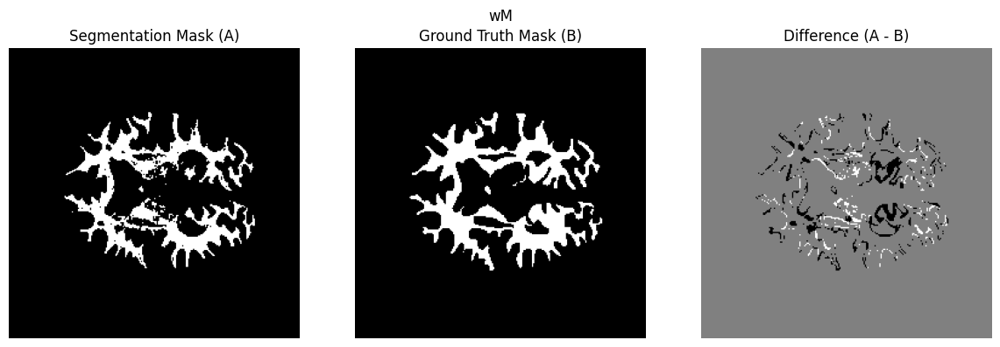

the dice score for this WM is: 0.85


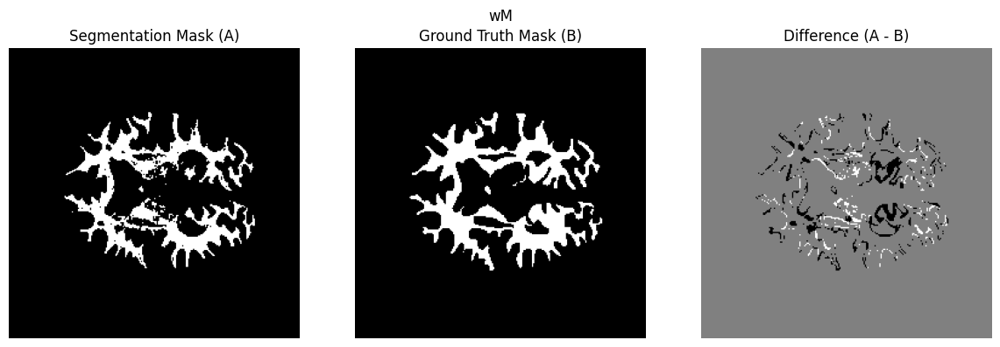

the dice score for this WM is: 0.85


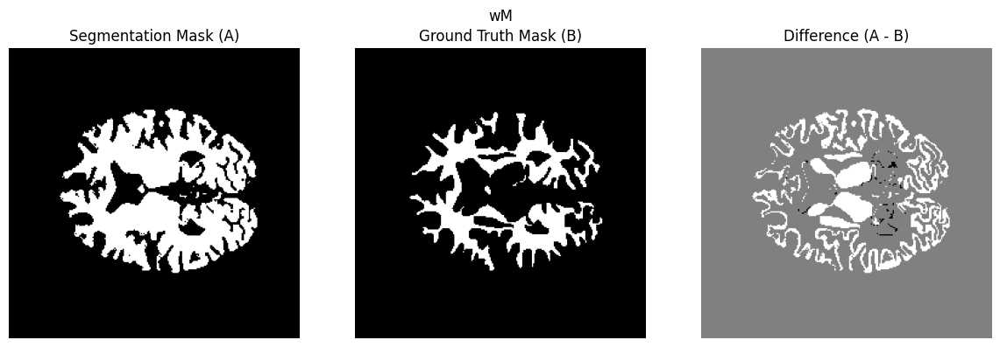

the dice score for this WM is: 0.70


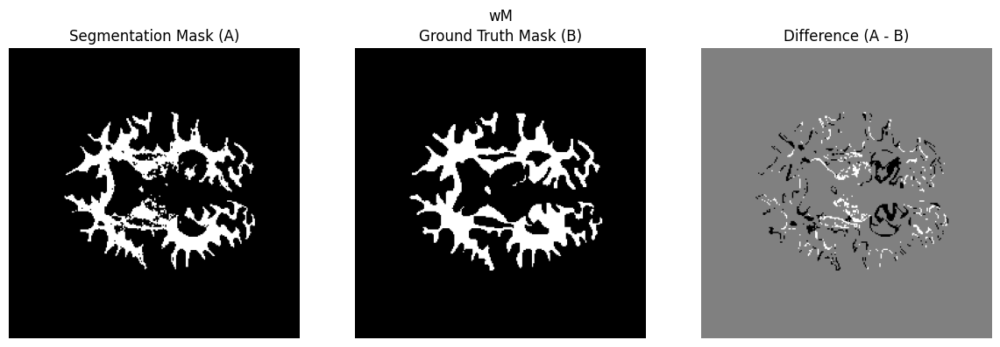

the dice score for this WM is: 0.86


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't1', 24)

[[ 62.98847617]
 [156.92809511]
 [200.38742694]]
[[ 51.60348148]
 [186.8961981 ]
 [154.63886505]]


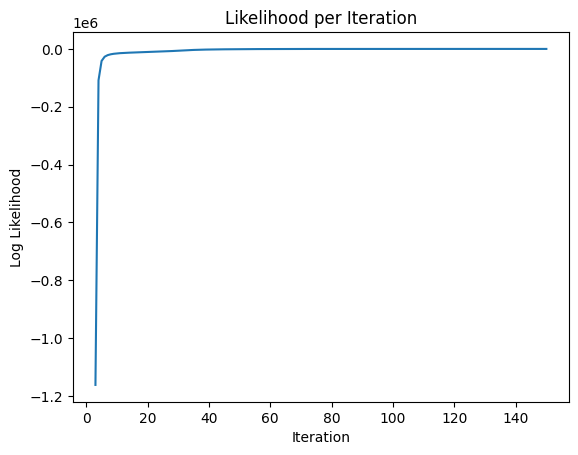


 k-means initialization custom gmm, t1 took 18 sec.
[[ 62.98847617]
 [156.92809511]
 [200.38742694]]
[[ 51.53471238]
 [186.89805067]
 [154.57572706]]


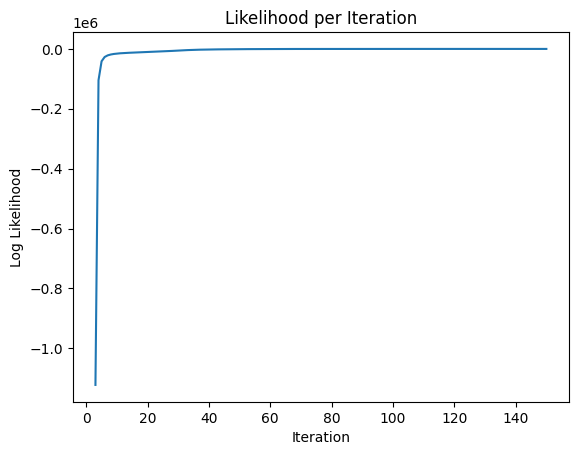


 k-means initialization scipy gmm, t1 took 18 sec.
[[104]
 [150]
 [228]]
[[ 49]
 [186]
 [152]]


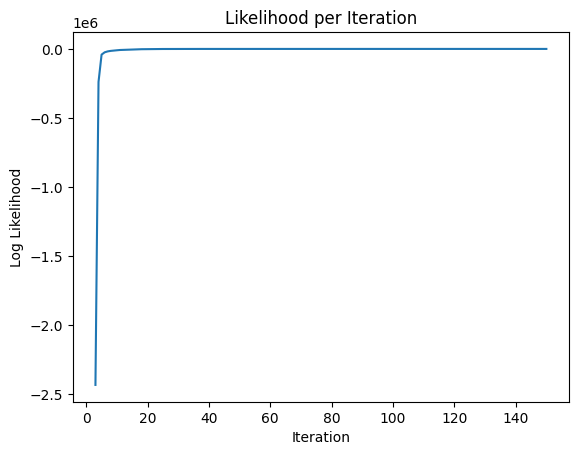


 random initialization custom gmm, with t1 took 18 sec.
[[18]
 [23]
 [71]]
[[ 10]
 [ 81]
 [185]]


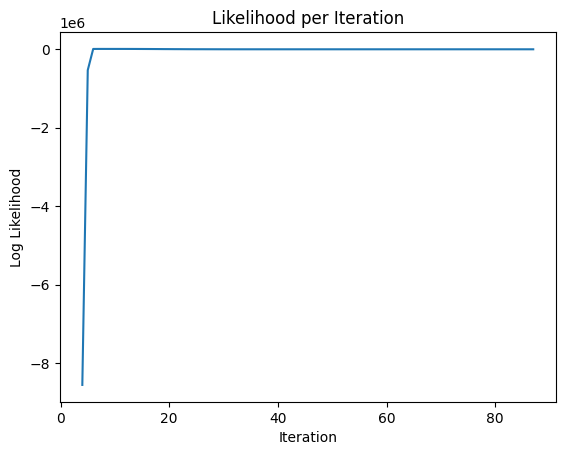


 random initialization scipy gmm, with t1 took 11 sec.


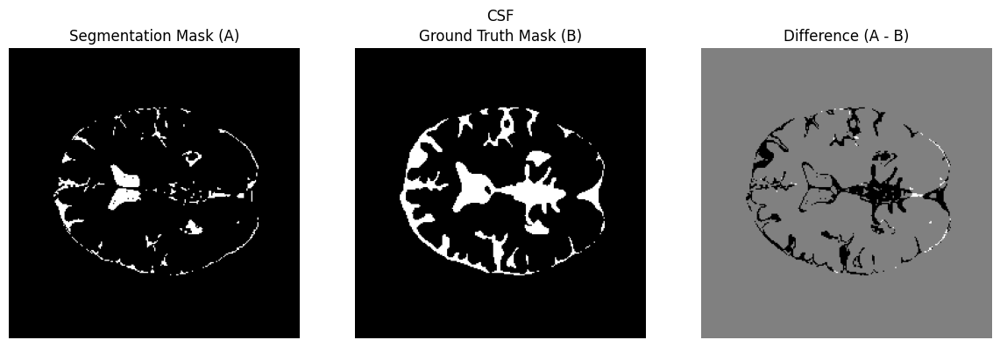

the dice score for this CSF is: 0.45


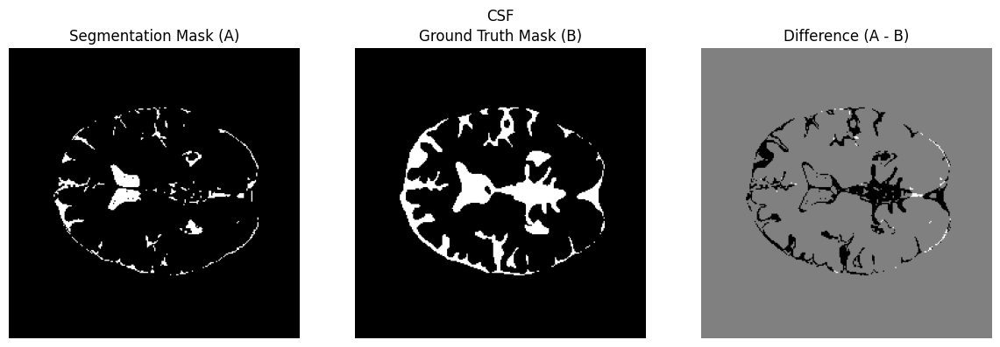

the dice score for this CSF is: 0.45


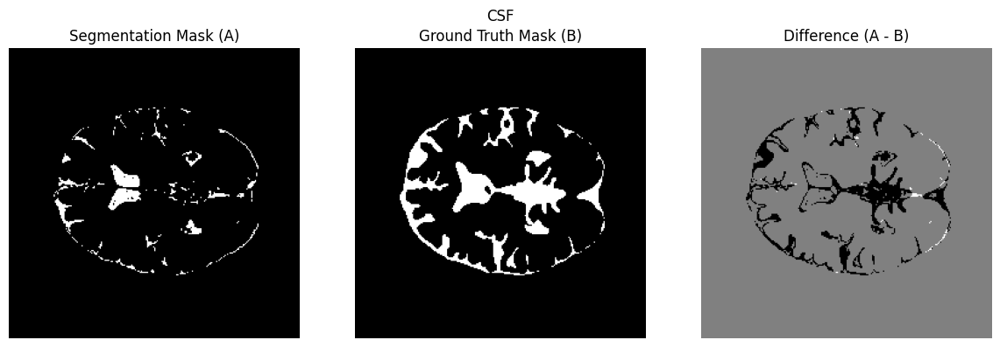

the dice score for this CSF is: 0.41


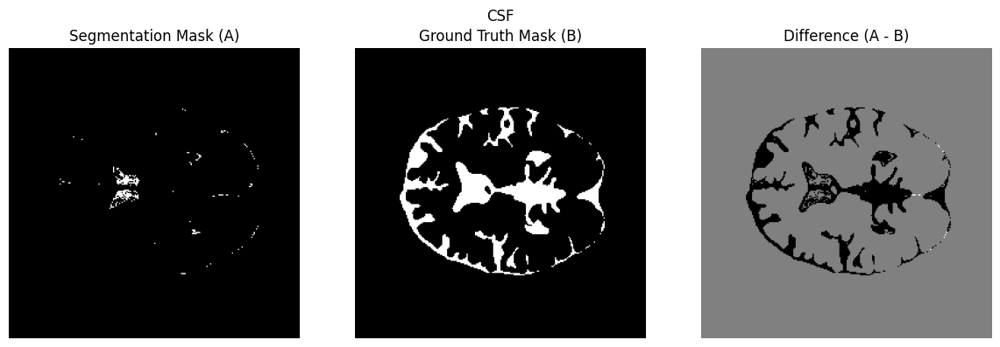

the dice score for this CSF is: 0.09


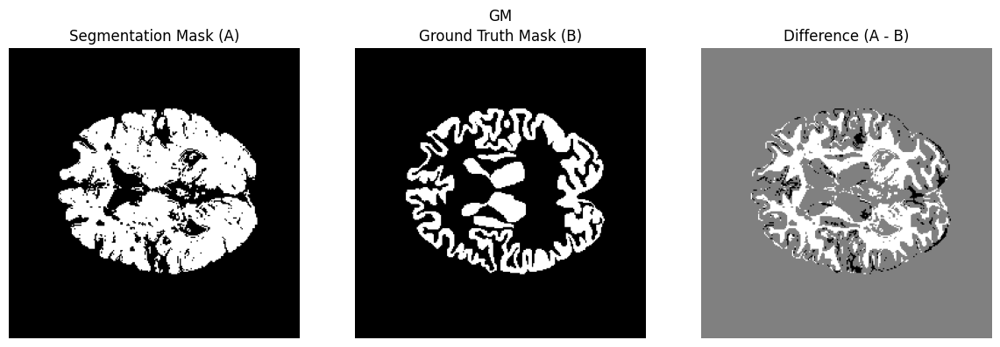

the dice score for this GM is: 0.61


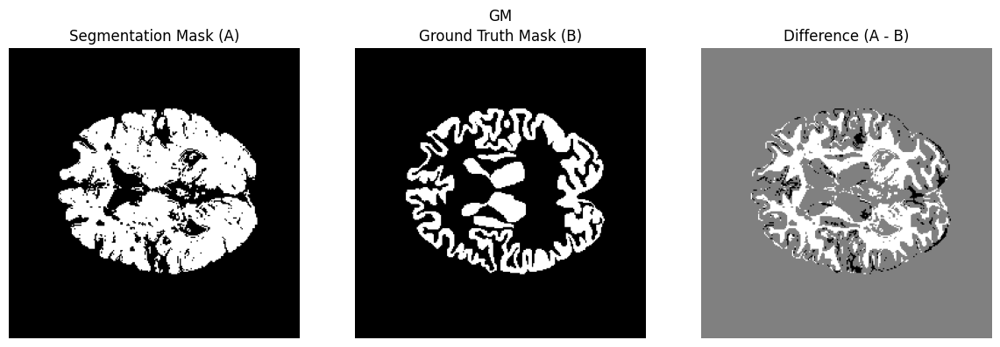

the dice score for this GM is: 0.61


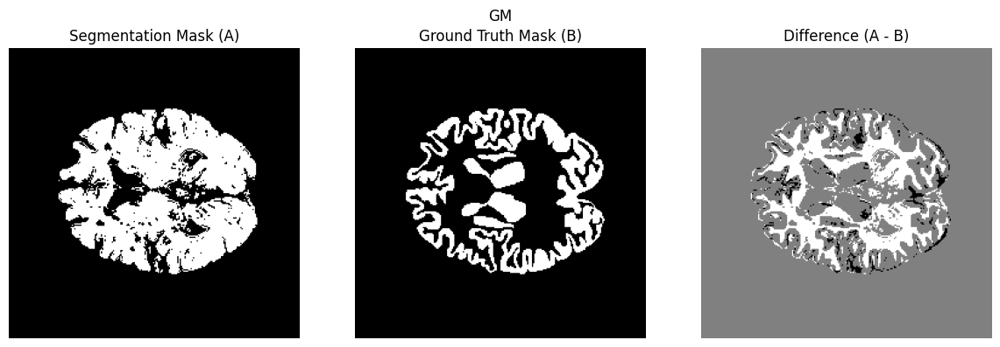

the dice score for this GM is: 0.61


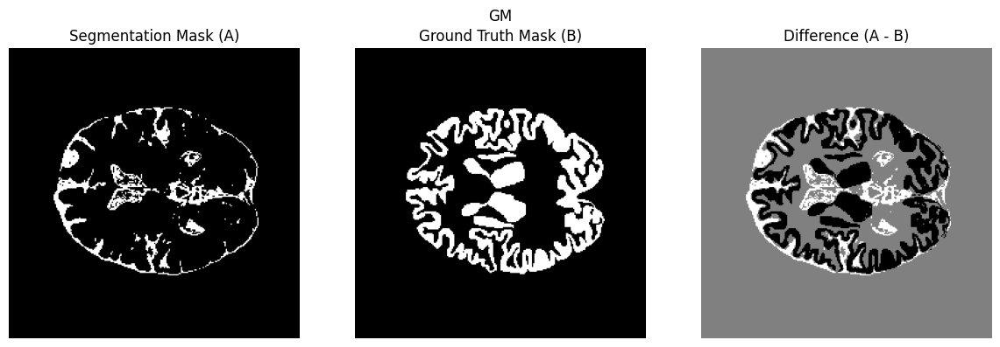

the dice score for this GM is: 0.03


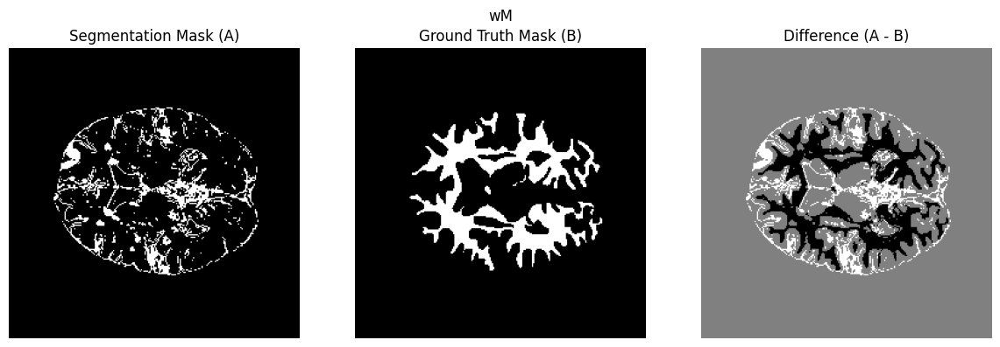

the dice score for this WM is: 0.12


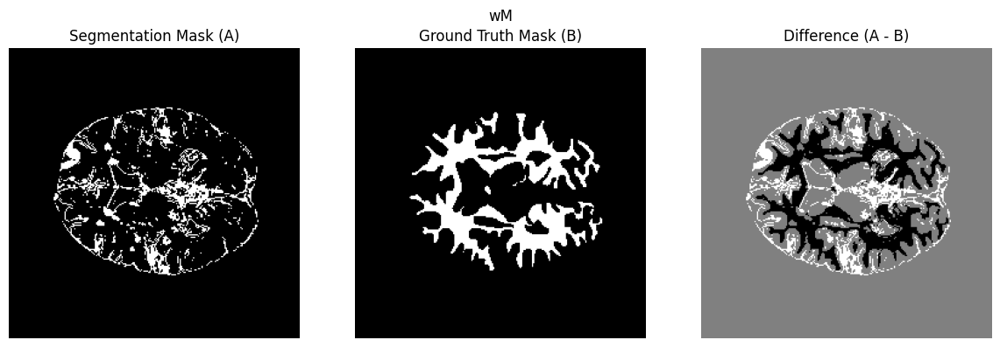

the dice score for this WM is: 0.12


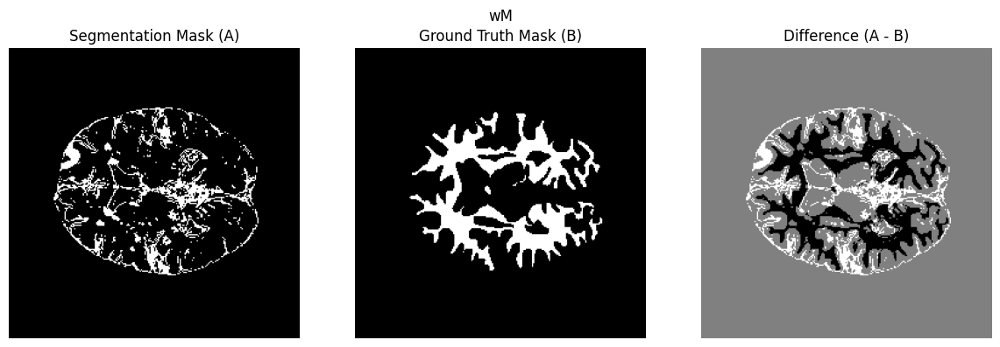

the dice score for this WM is: 0.12


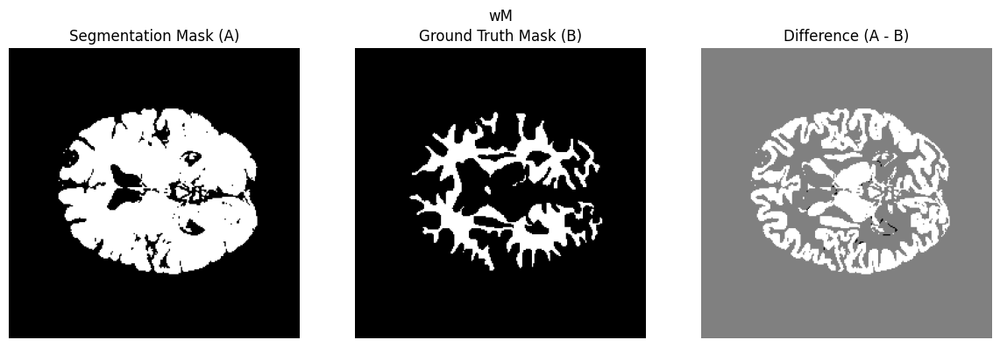

the dice score for this WM is: 0.55


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't2', 24)

[[ 48.34045371  86.85497171]
 [138.80611077 194.60986026]
 [219.80669652 182.21665715]]
[[ 64.36948619 115.52570938]
 [171.57274465 192.17734474]
 [232.24974072 182.03299767]]


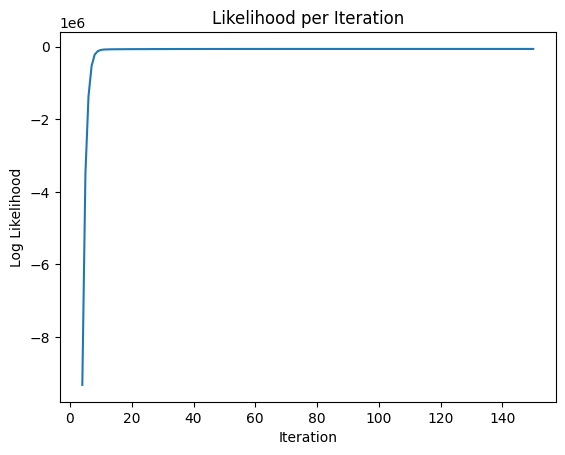


 k-means initialization custom gmm, t1 took 34 sec.
[[ 48.05588467  86.17981551]
 [137.64583127 194.34433054]
 [219.16484049 182.40887124]]
[[ 64.36947527 115.52569649]
 [171.5727421  192.17734517]
 [232.24974124 182.03299654]]


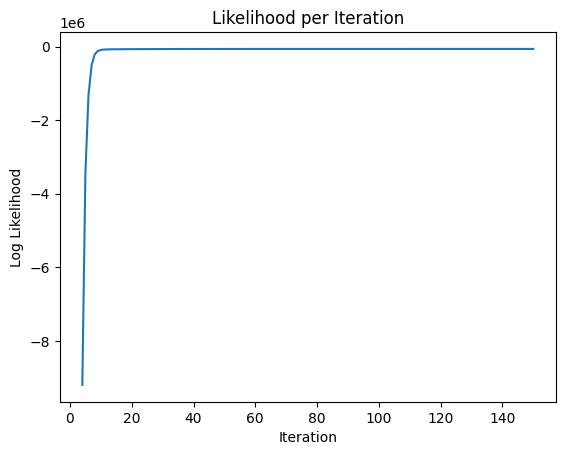


 k-means initialization scipy gmm, t1 took 35 sec.
[[ 42  42]
 [133 133]
 [198 198]]
[[ 33  64]
 [ 99 161]
 [198 187]]


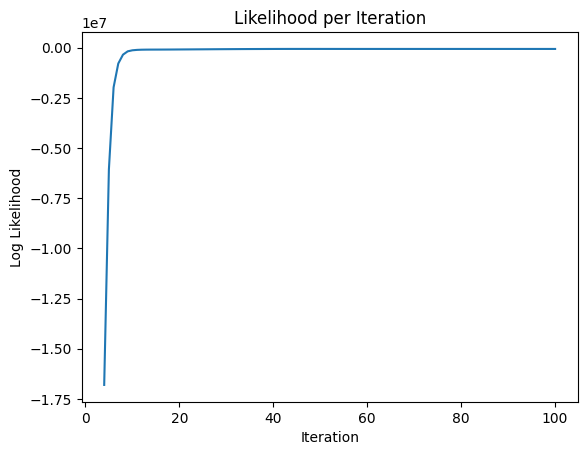


 random initialization custom gmm, with t1 took 23 sec.
[[ 29  29]
 [103 103]
 [238 238]]
[[ 59 110]
 [166 192]
 [230 181]]


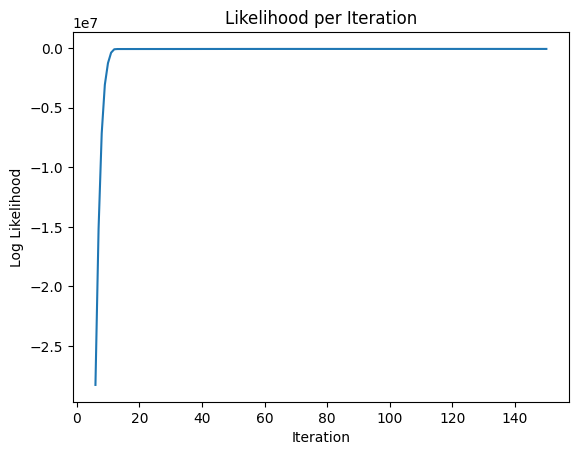


 random initialization scipy gmm, with t1 took 35 sec.


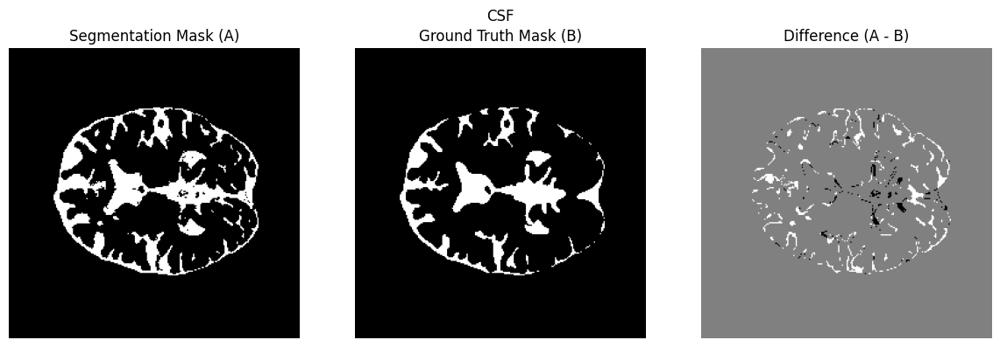

the dice score for this CSF is: 0.87


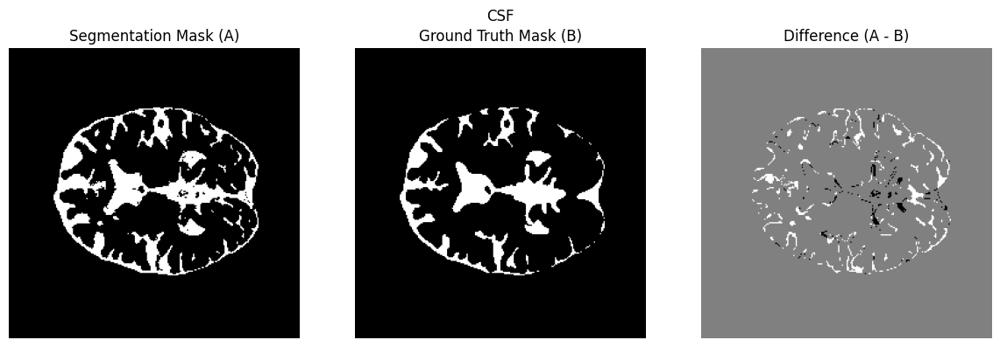

the dice score for this CSF is: 0.87


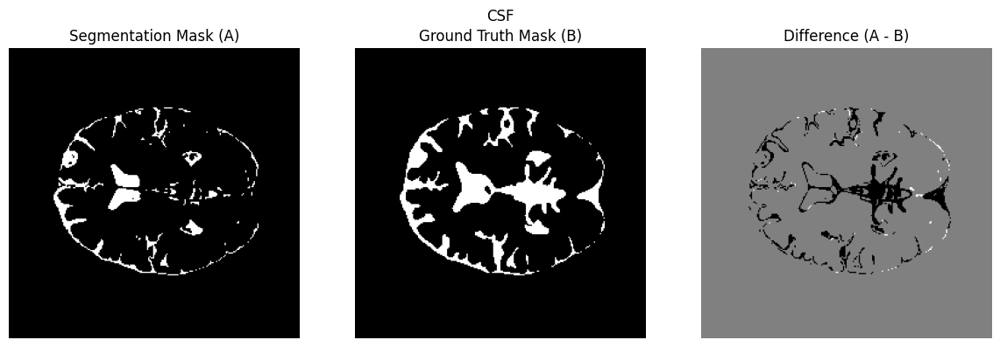

the dice score for this CSF is: 0.57


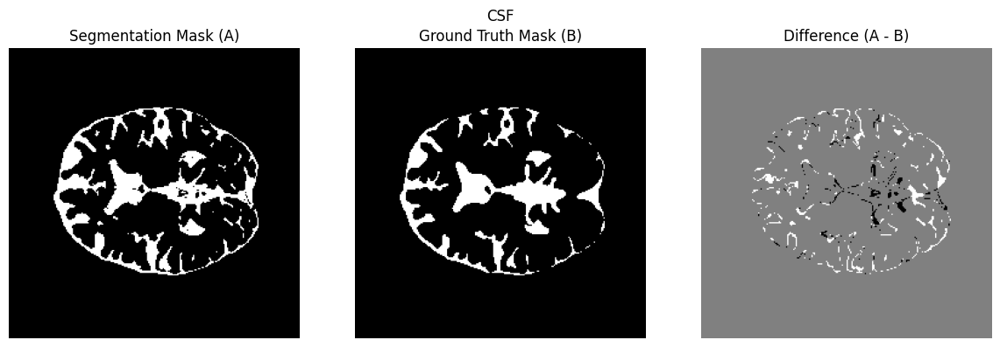

the dice score for this CSF is: 0.88


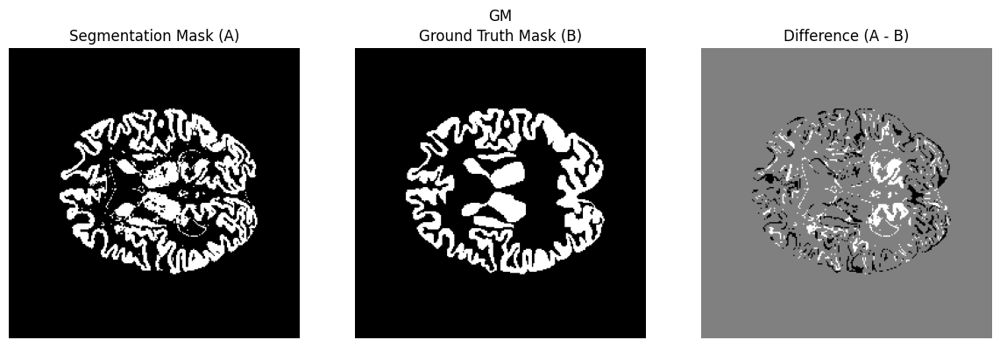

the dice score for this GM is: 0.80


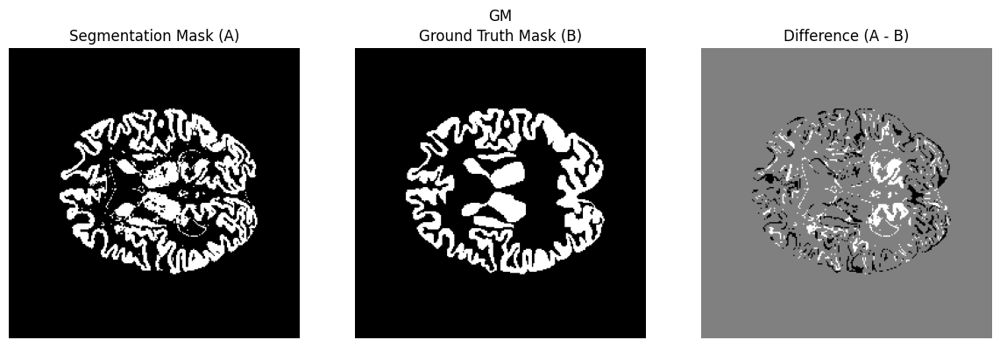

the dice score for this GM is: 0.80


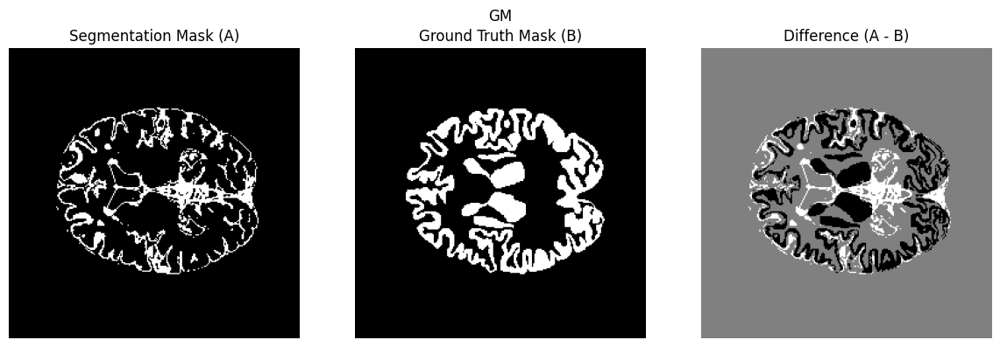

the dice score for this GM is: 0.25


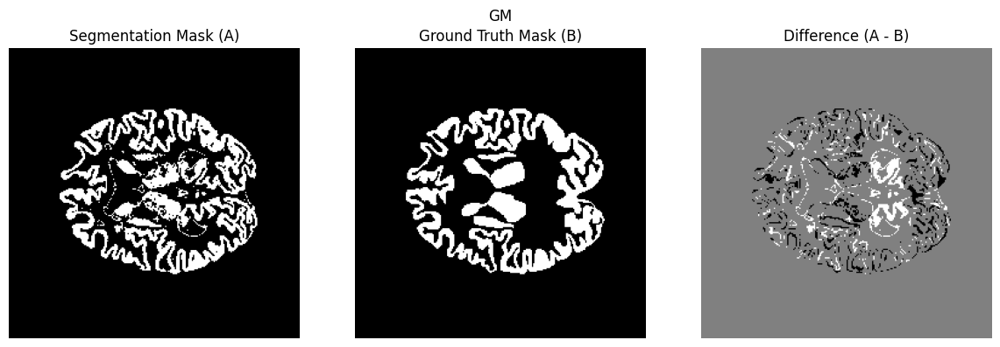

the dice score for this GM is: 0.81


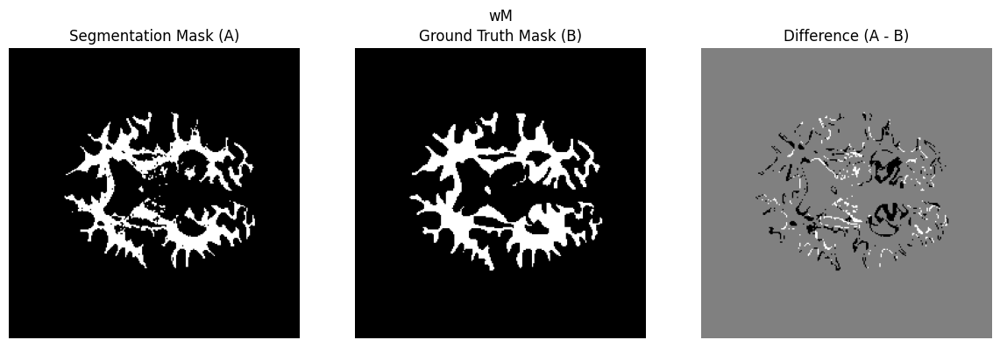

the dice score for this WM is: 0.85


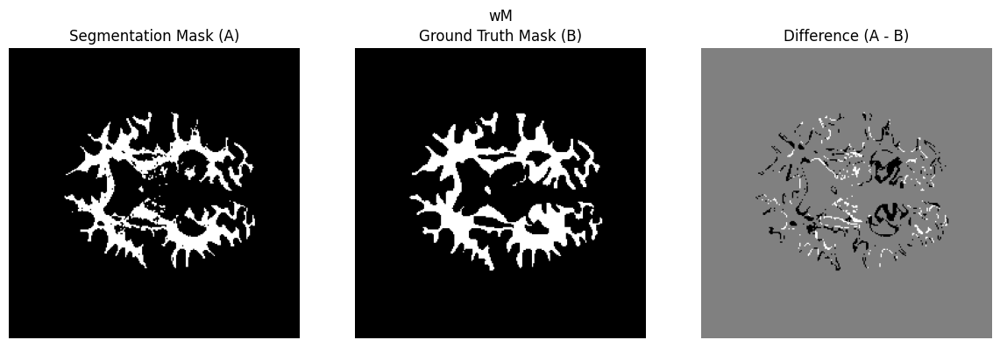

the dice score for this WM is: 0.85


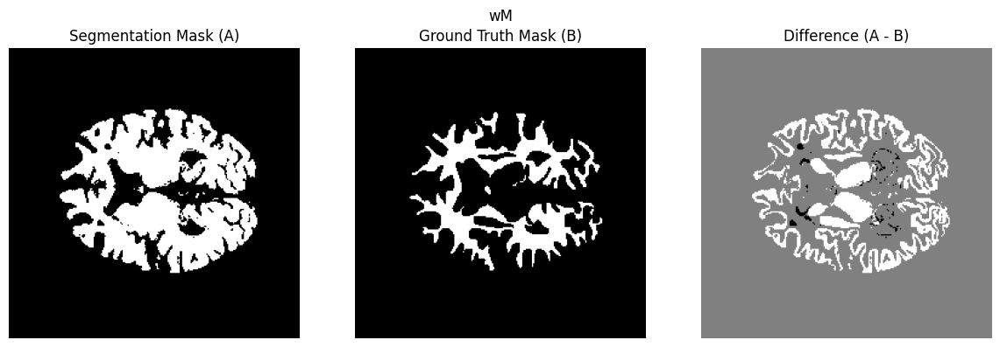

the dice score for this WM is: 0.65


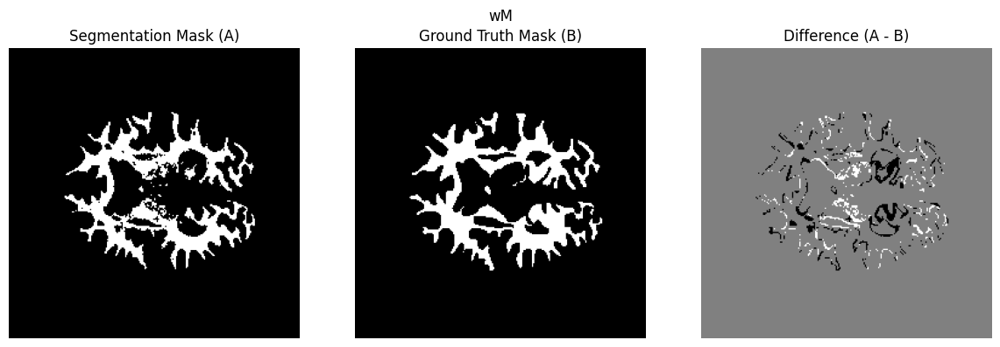

the dice score for this WM is: 0.86


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 'mv', 24)

#Patient 4

[[ 42.81775788]
 [139.94391482]
 [211.9867912 ]]
[[ 39.85976148]
 [151.51214548]
 [220.80544874]]


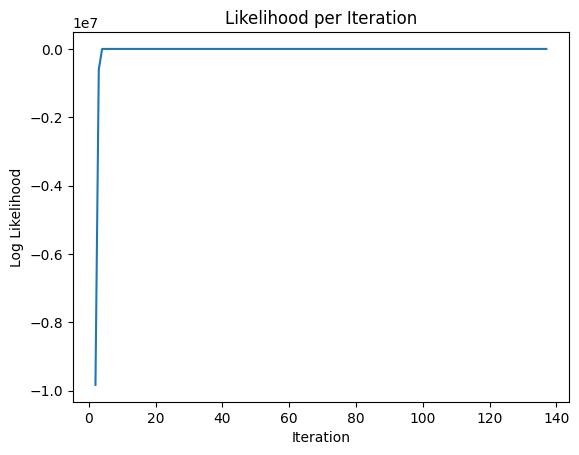


 k-means initialization custom gmm, t1 took 19 sec.
[[ 42.78618218]
 [139.87716734]
 [211.94696781]]
[[ 39.85973819]
 [151.51213113]
 [220.80544934]]


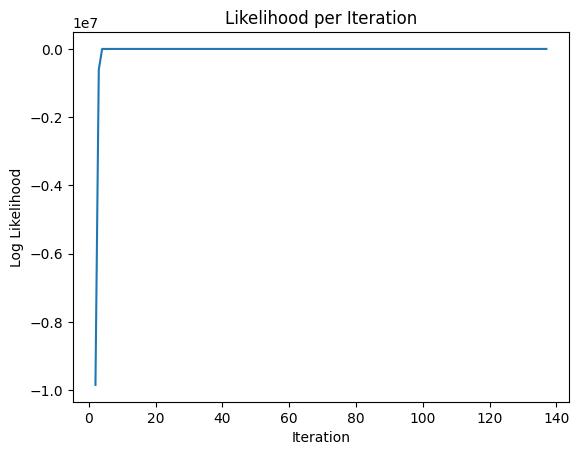


 k-means initialization scipy gmm, t1 took 15 sec.
[[109]
 [126]
 [249]]
[[ 39]
 [150]
 [220]]


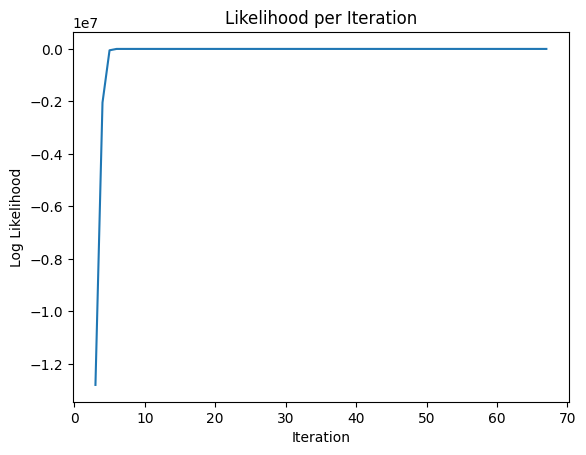


 random initialization custom gmm, with t1 took 6 sec.
[[131]
 [205]
 [220]]
[[ 39]
 [149]
 [219]]


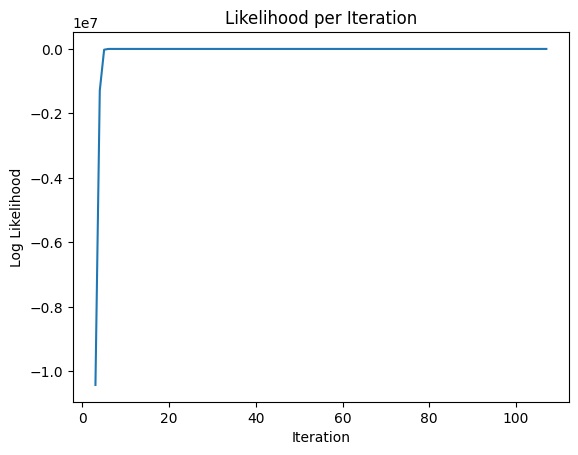


 random initialization scipy gmm, with t1 took 12 sec.


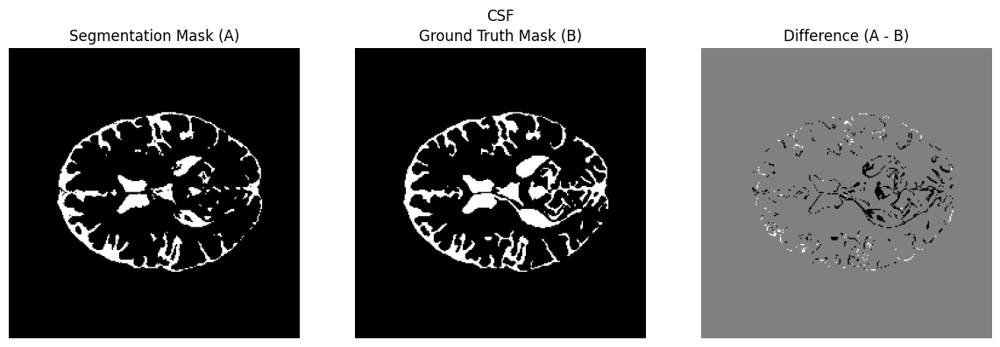

the dice score for this CSF is: 0.84


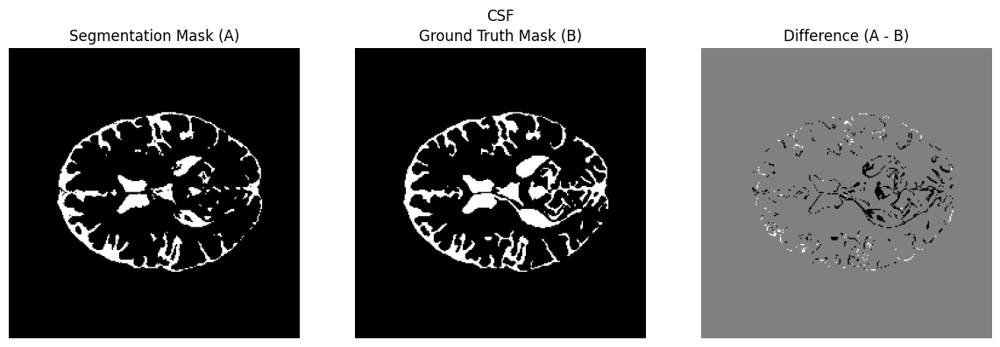

the dice score for this CSF is: 0.84


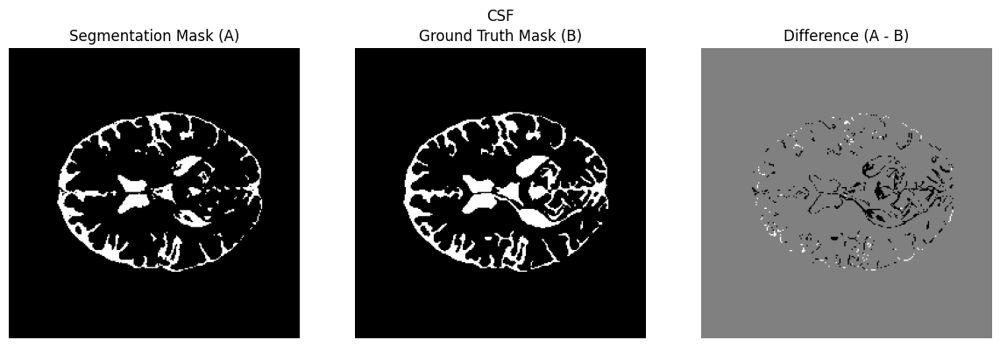

the dice score for this CSF is: 0.83


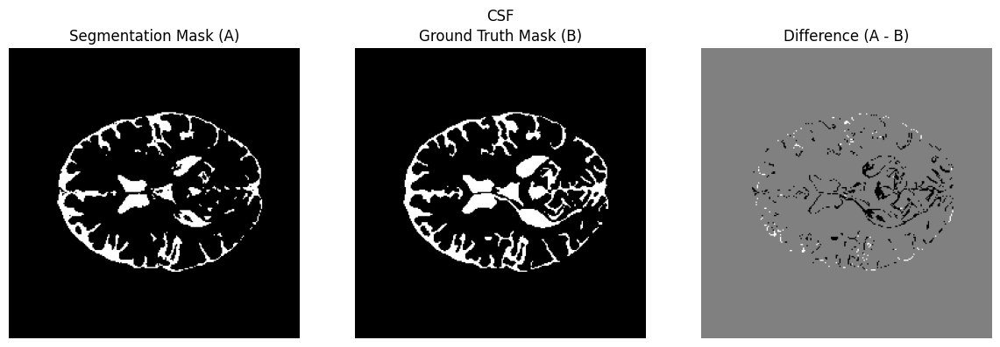

the dice score for this CSF is: 0.83


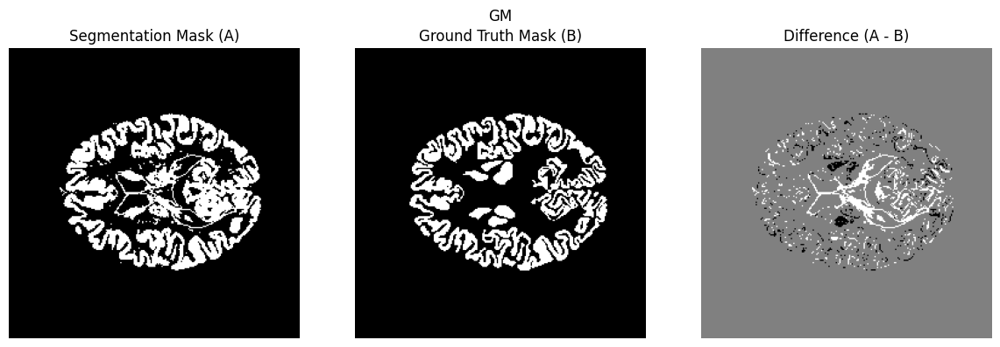

the dice score for this GM is: 0.82


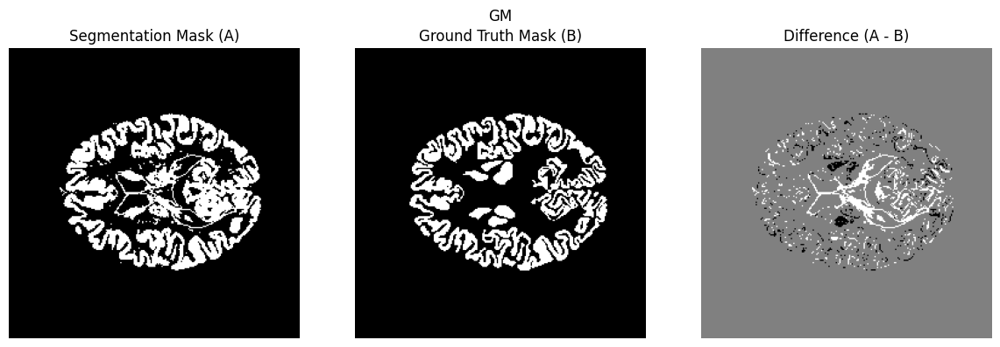

the dice score for this GM is: 0.82


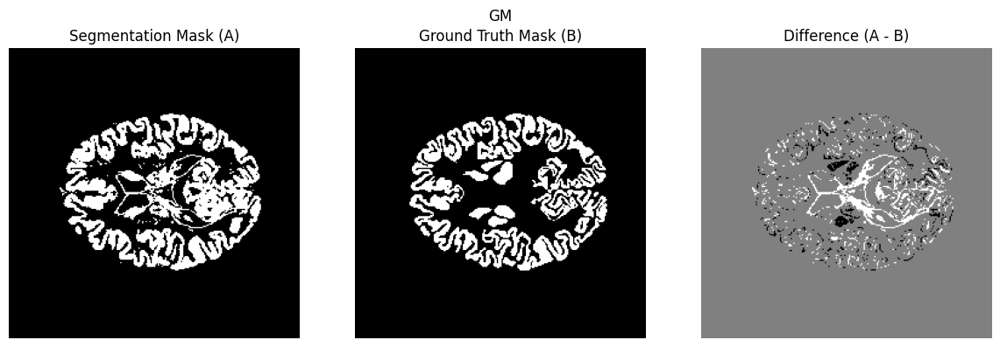

the dice score for this GM is: 0.82


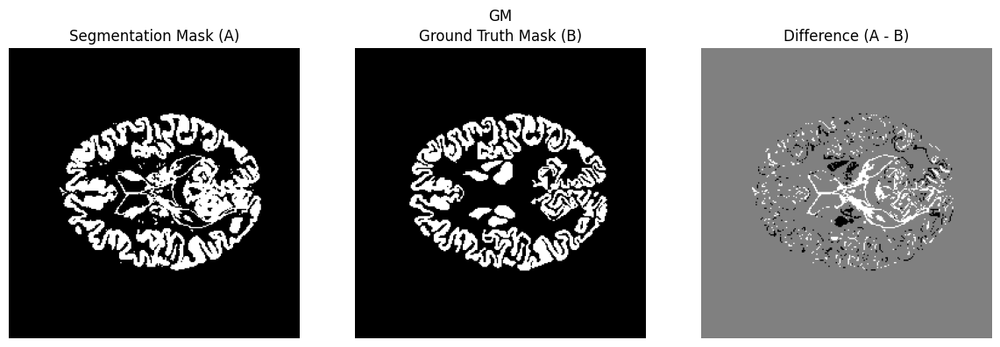

the dice score for this GM is: 0.82


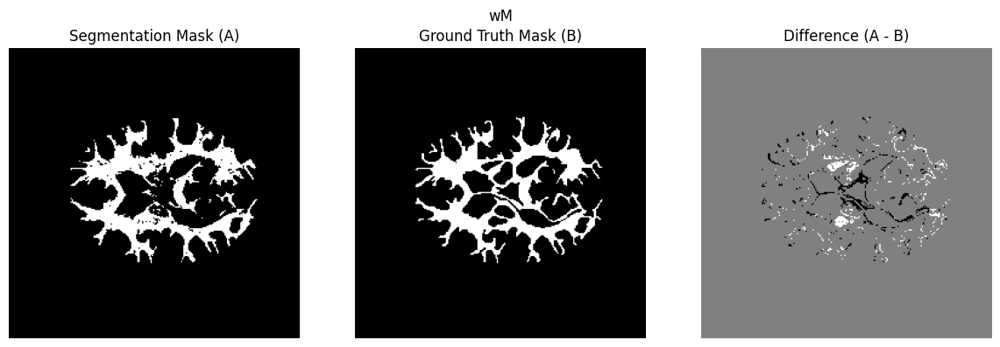

the dice score for this WM is: 0.87


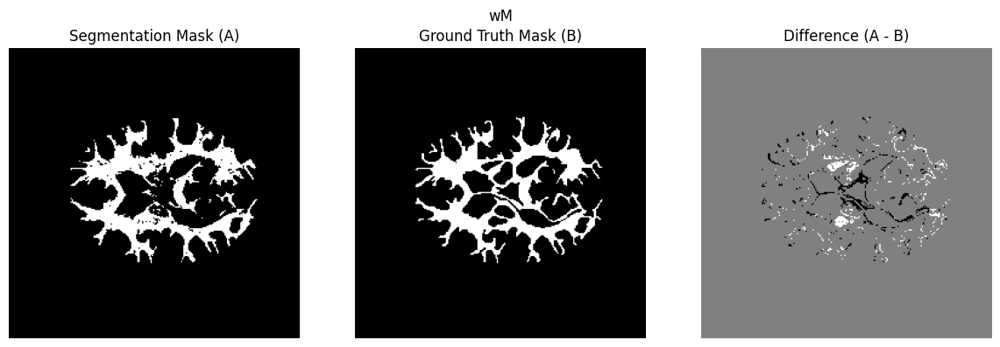

the dice score for this WM is: 0.87


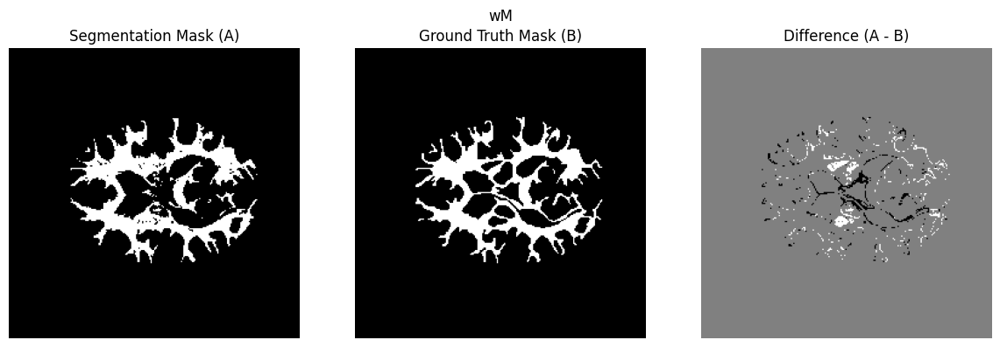

the dice score for this WM is: 0.87


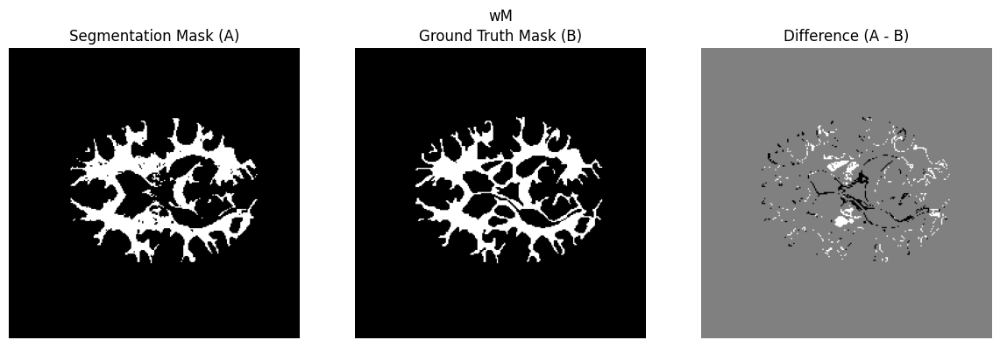

the dice score for this WM is: 0.87


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't1', 24)

[[ 58.22629906]
 [150.72345218]
 [190.79248365]]
[[ 71.45236854]
 [165.62139814]
 [181.65631495]]


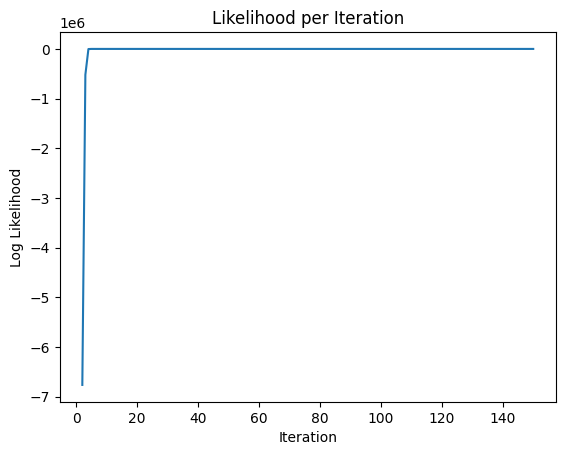


 k-means initialization custom gmm, t1 took 17 sec.
[[ 56.76263885]
 [147.43851777]
 [188.48228718]]
[[ 71.40813638]
 [166.7941807 ]
 [178.2889348 ]]


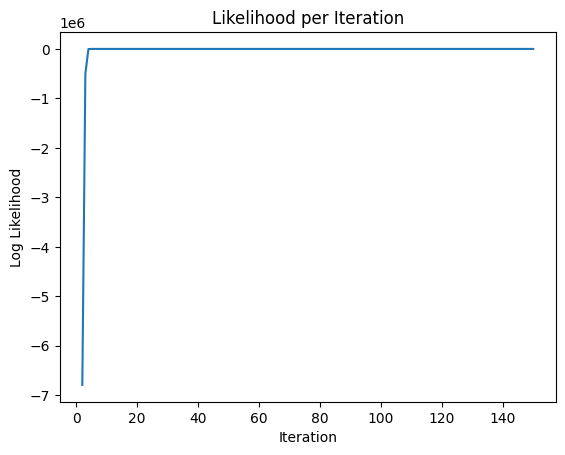


 k-means initialization scipy gmm, t1 took 18 sec.
[[ 50]
 [ 78]
 [146]]
[[ 38]
 [ 88]
 [172]]


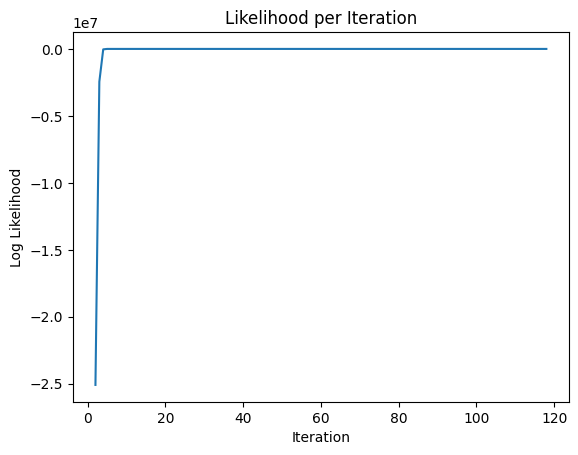


 random initialization custom gmm, with t1 took 14 sec.
[[15]
 [46]
 [62]]
[[  9]
 [ 68]
 [172]]


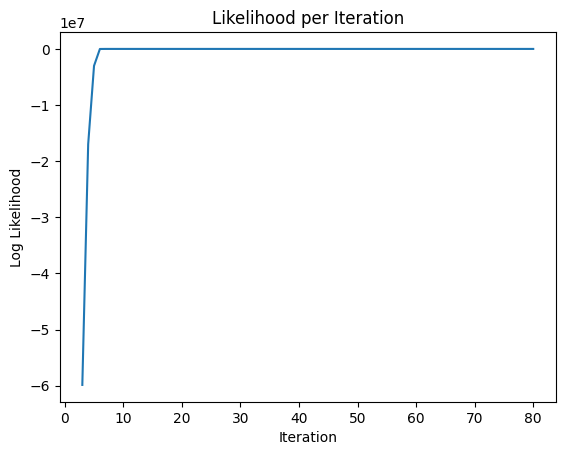


 random initialization scipy gmm, with t1 took 10 sec.


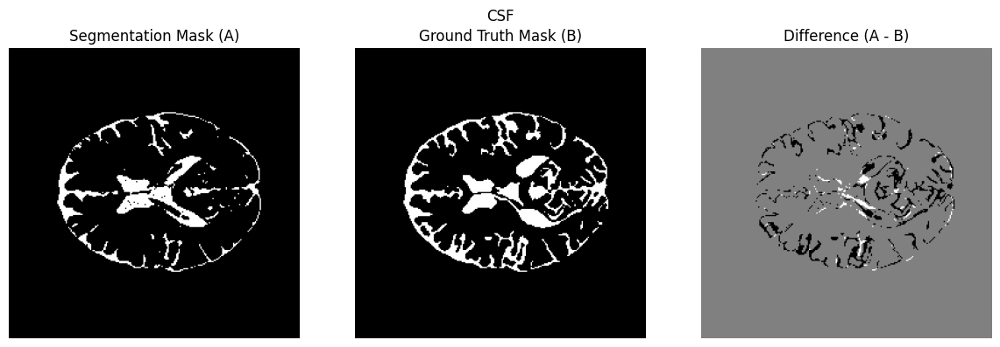

the dice score for this CSF is: 0.76


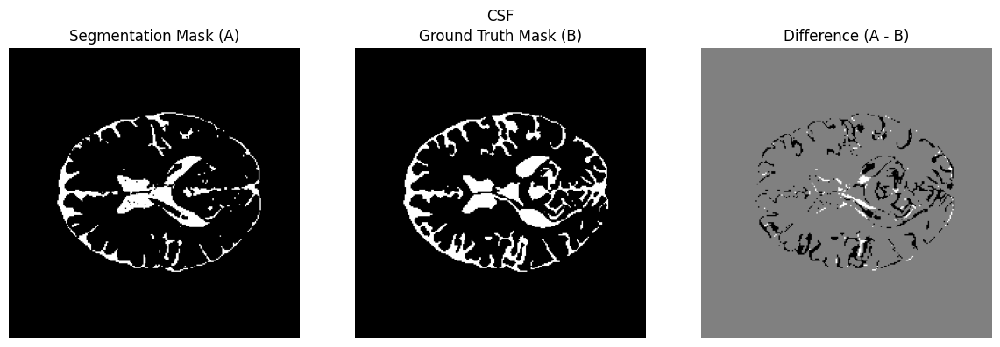

the dice score for this CSF is: 0.76


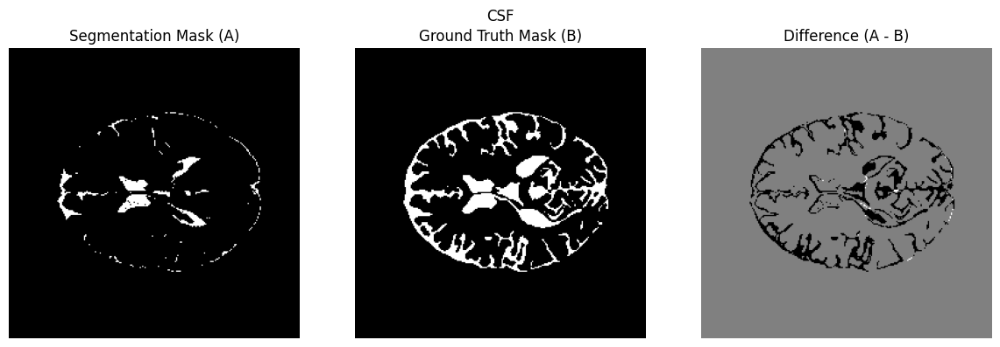

the dice score for this CSF is: 0.43


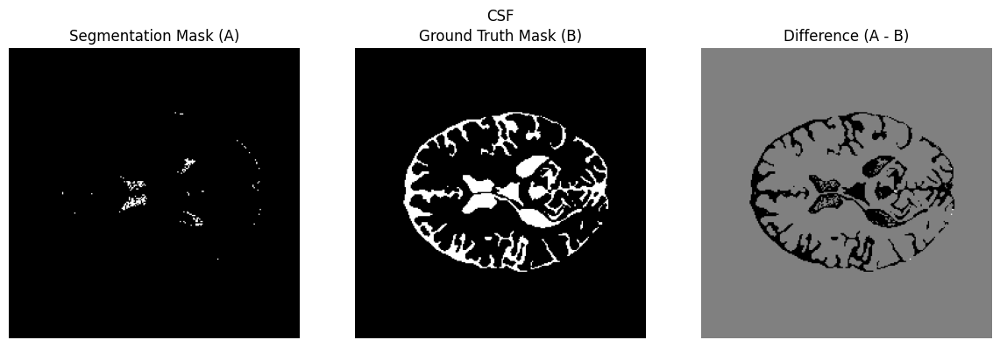

the dice score for this CSF is: 0.05


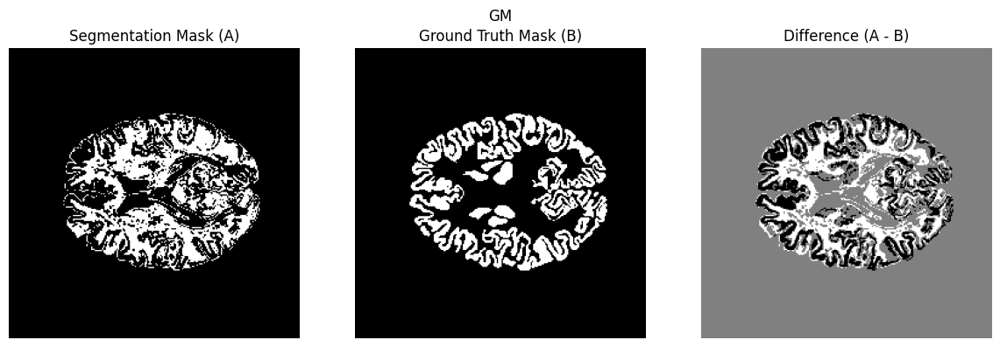

the dice score for this GM is: 0.38


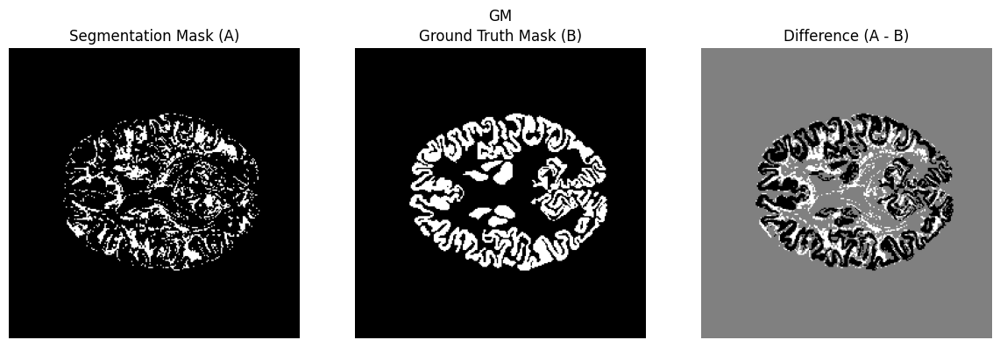

the dice score for this GM is: 0.22


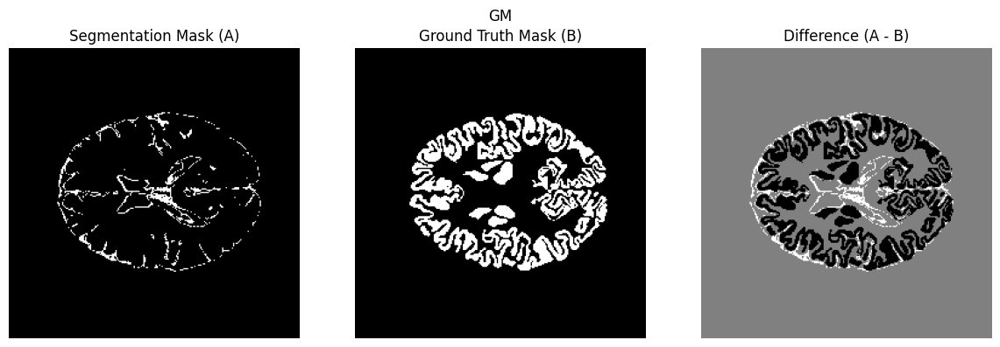

the dice score for this GM is: 0.03


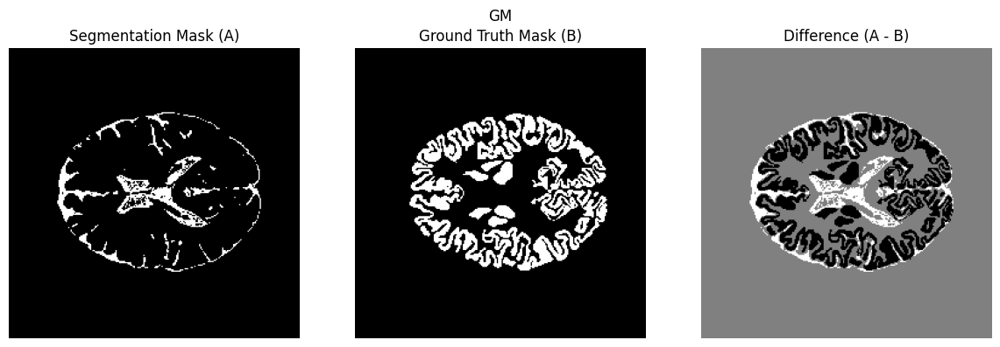

the dice score for this GM is: 0.02


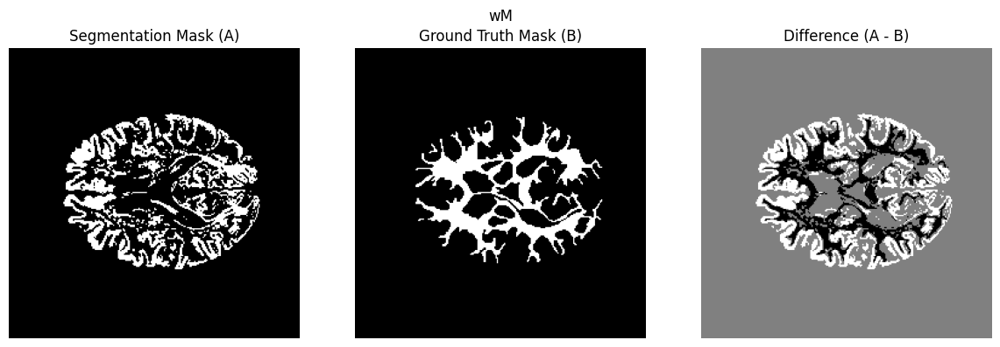

the dice score for this WM is: 0.16


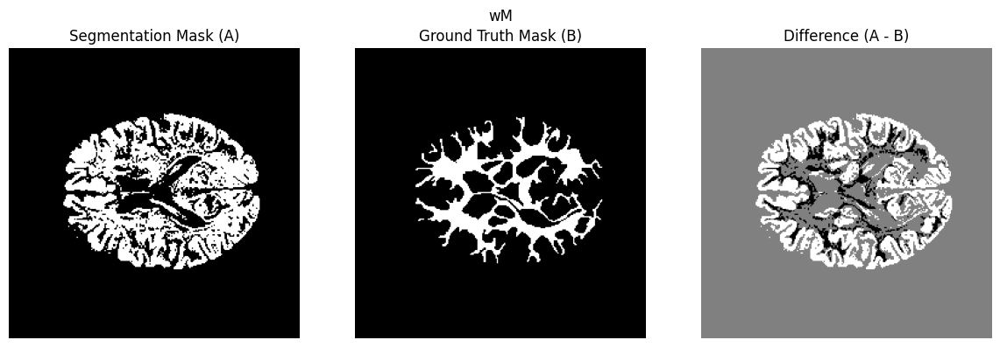

the dice score for this WM is: 0.33


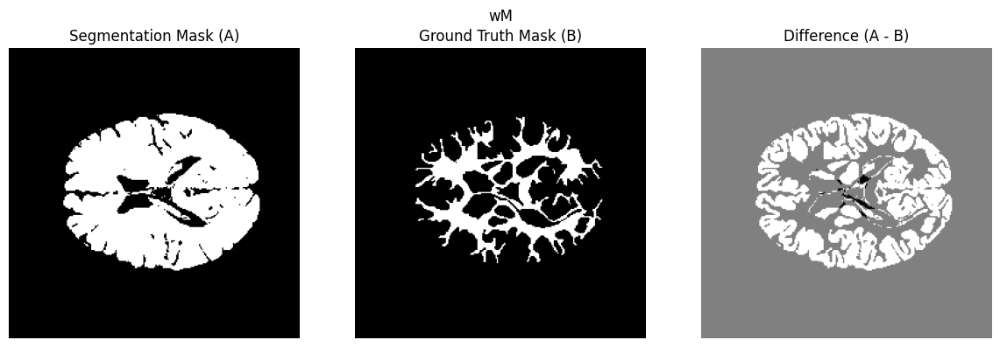

the dice score for this WM is: 0.48


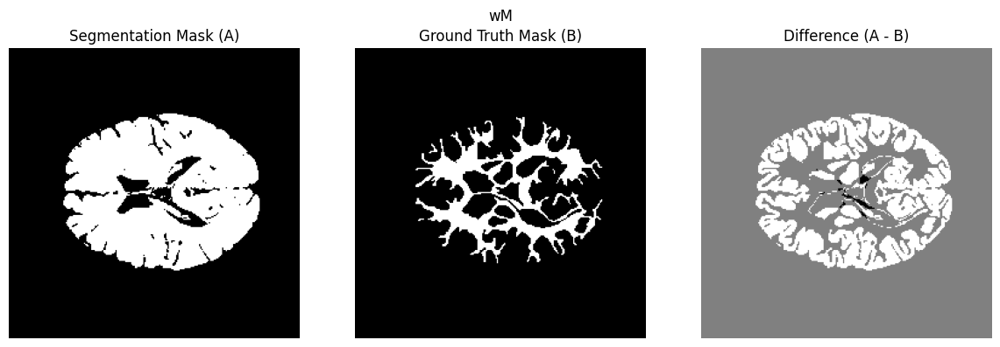

the dice score for this WM is: 0.47


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't2', 24)

[[ 39.40005437  74.41226382]
 [131.15125282 184.28672393]
 [210.05736924 164.20346473]]
[[ 52.89050504  99.17244779]
 [158.50131264 184.61438683]
 [220.35569244 162.46901642]]


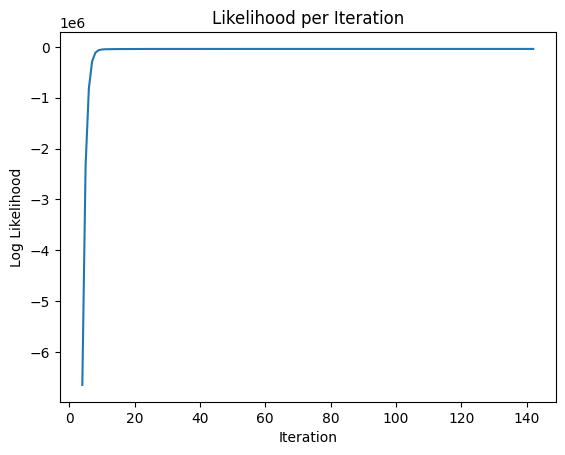


 k-means initialization custom gmm, t1 took 29 sec.
[[ 39.11905056  73.80728988]
 [130.21319691 184.06052651]
 [209.55562498 164.42780261]]
[[ 52.89050519  99.17244796]
 [158.50131309 184.61438669]
 [220.3556926  162.46901639]]


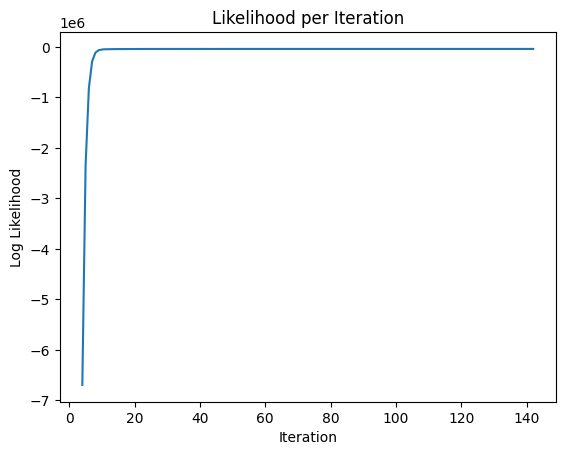


 k-means initialization scipy gmm, t1 took 30 sec.
[[ 70  70]
 [124 124]
 [158 158]]
[[ 28  56]
 [ 95 156]
 [188 174]]


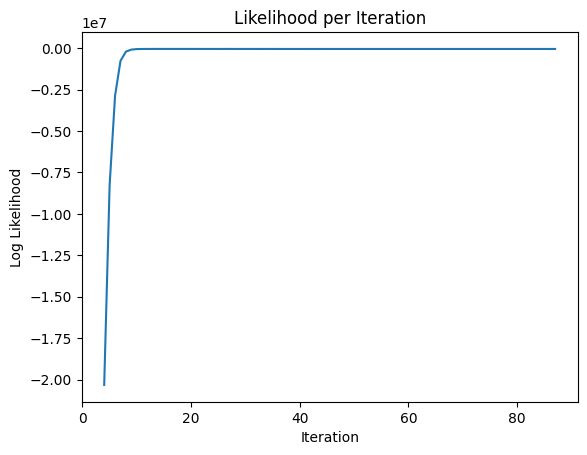


 random initialization custom gmm, with t1 took 19 sec.
[[205 205]
 [218 218]
 [240 240]]
[[ 59 106]
 [184 175]
 [224 241]]


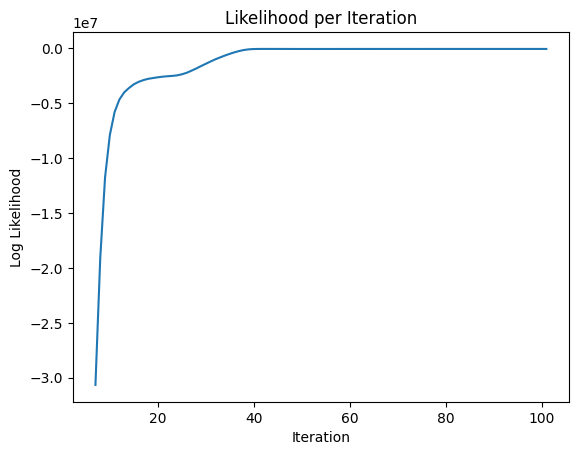


 random initialization scipy gmm, with t1 took 22 sec.


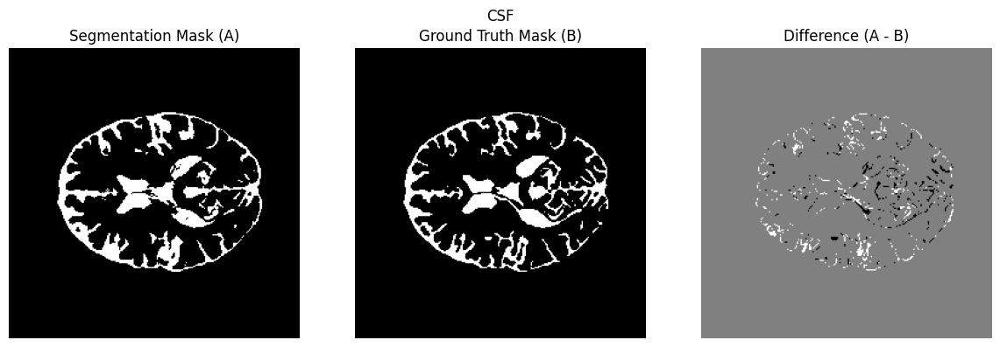

the dice score for this CSF is: 0.90


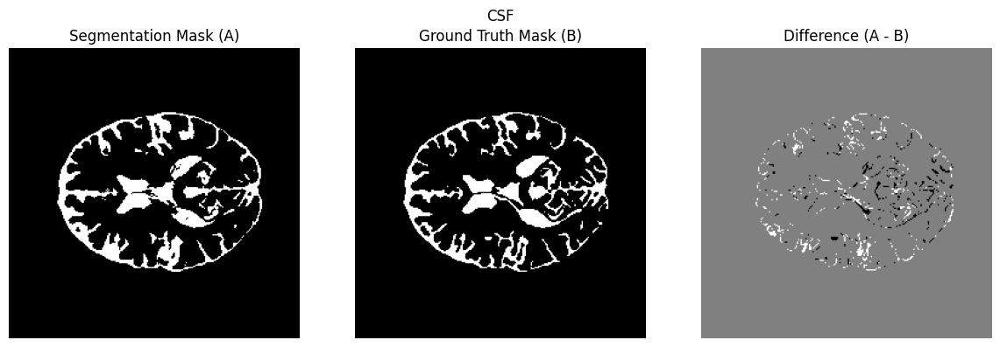

the dice score for this CSF is: 0.90


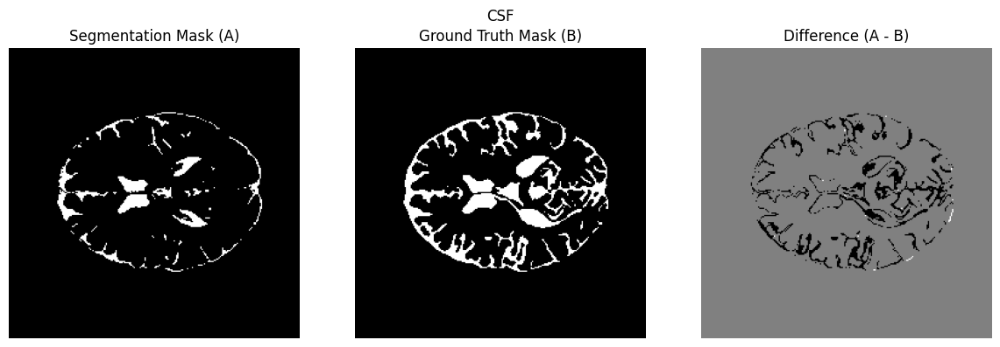

the dice score for this CSF is: 0.66


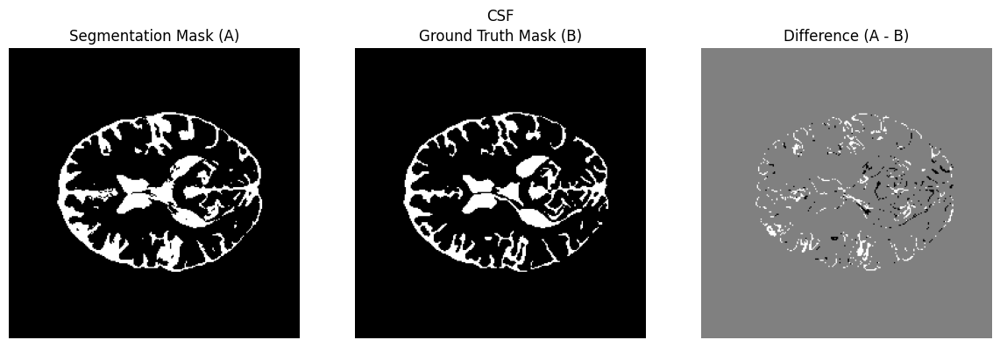

the dice score for this CSF is: 0.89


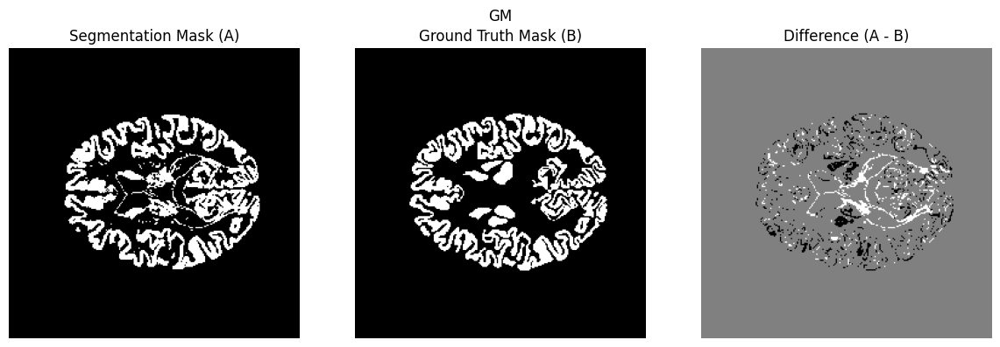

the dice score for this GM is: 0.84


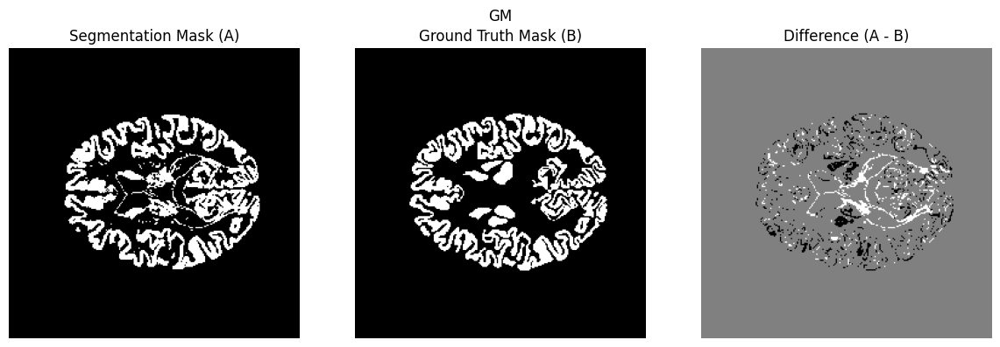

the dice score for this GM is: 0.84


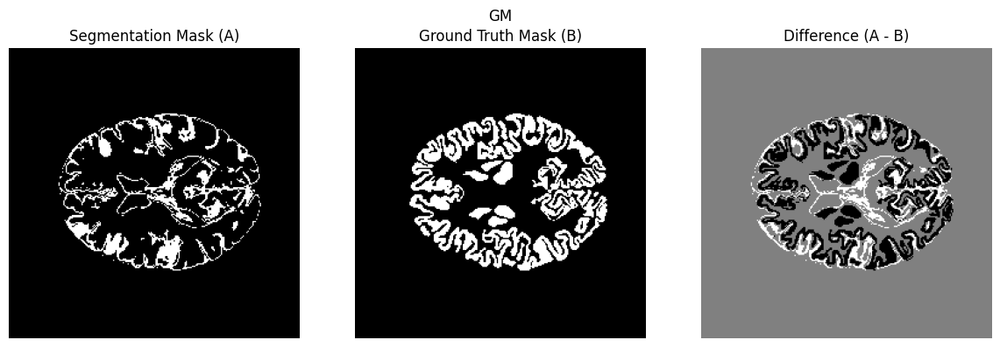

the dice score for this GM is: 0.23


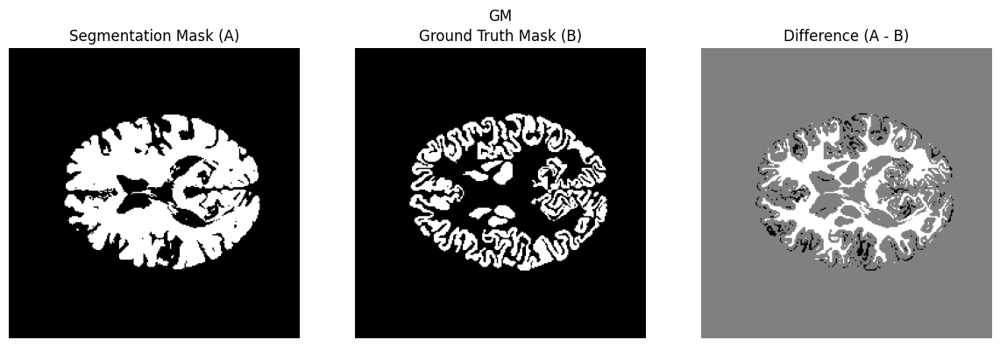

the dice score for this GM is: 0.69


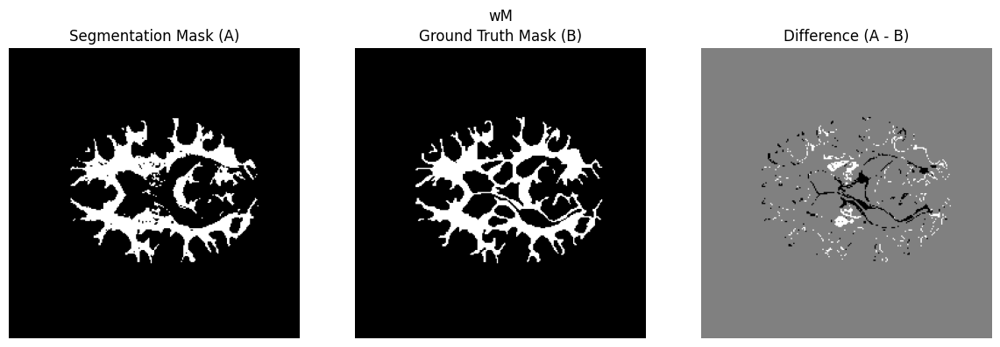

the dice score for this WM is: 0.87


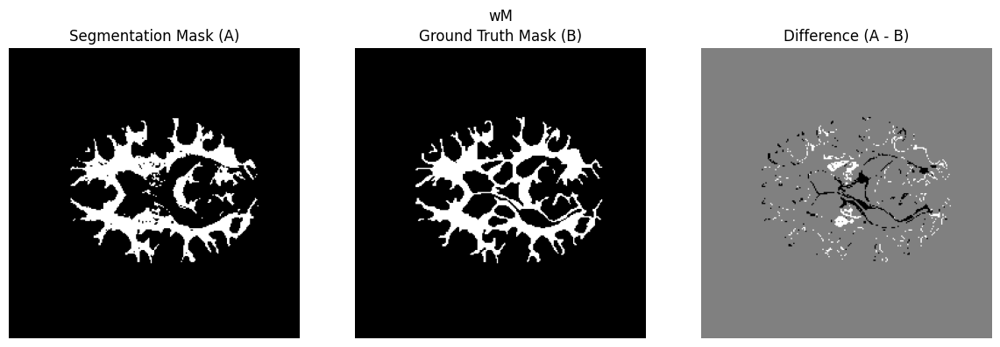

the dice score for this WM is: 0.87


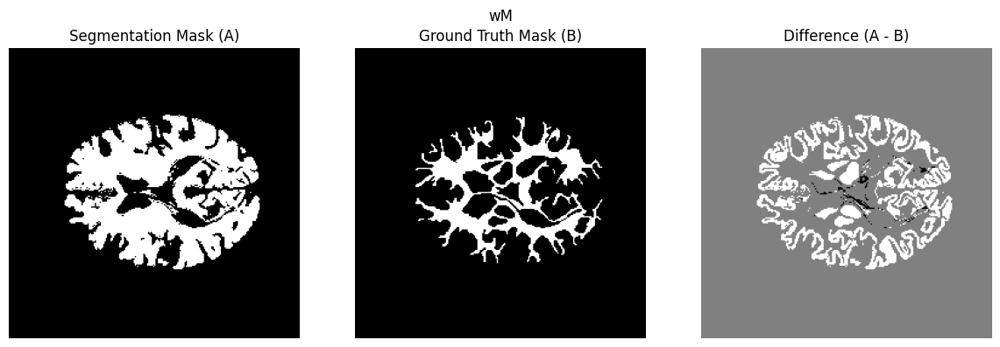

the dice score for this WM is: 0.58


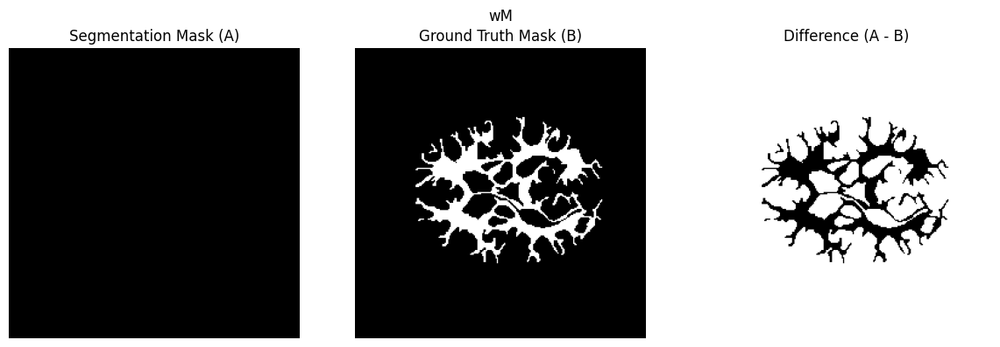

the dice score for this WM is: 0.00


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 'mv', 24)

#Patient 5

[[ 39.24964881]
 [131.08679513]
 [202.75899735]]
[[ 34.65138632]
 [140.05138688]
 [211.42588745]]


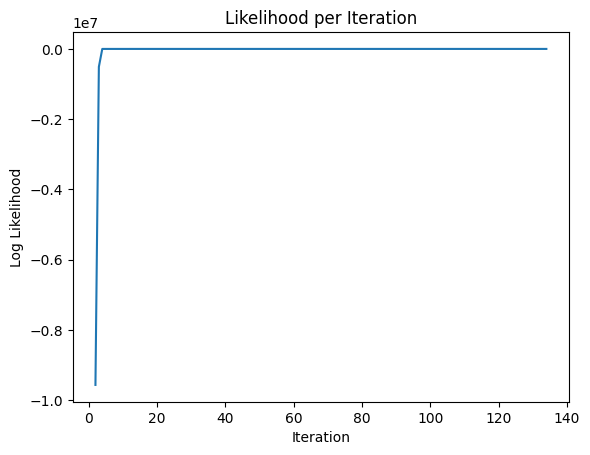


 k-means initialization custom gmm, t1 took 16 sec.
[[ 39.67606526]
 [131.70970841]
 [203.09441939]]
[[ 34.65138725]
 [140.05138752]
 [211.42588748]]


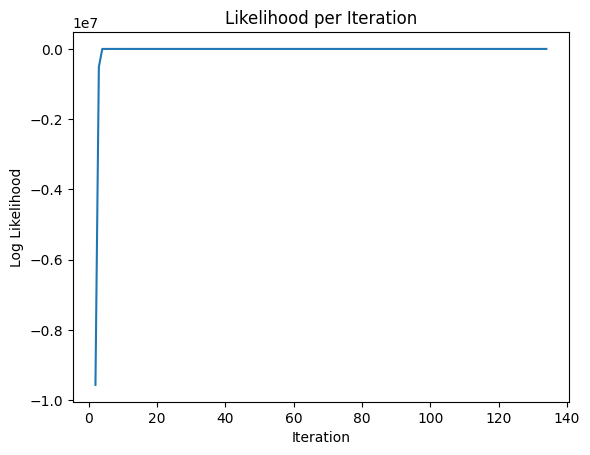


 k-means initialization scipy gmm, t1 took 16 sec.
[[ 81]
 [138]
 [155]]
[[ 34]
 [138]
 [210]]


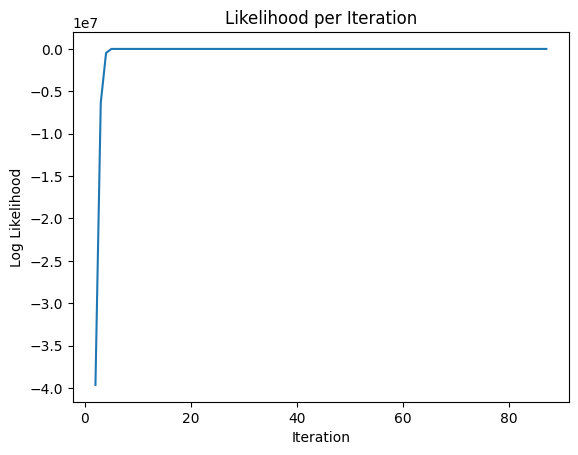


 random initialization custom gmm, with t1 took 10 sec.
[[  8]
 [ 13]
 [147]]
[[  4]
 [ 36]
 [159]]


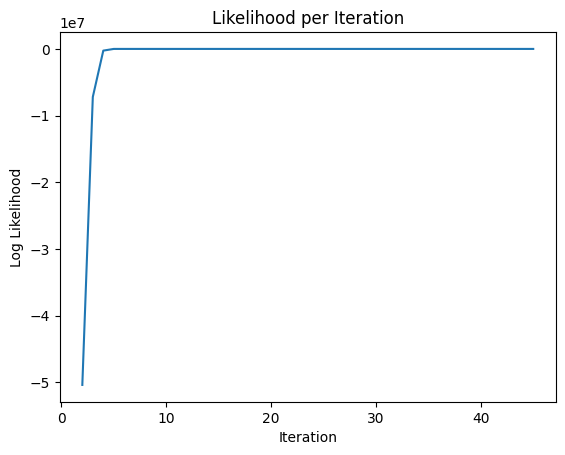


 random initialization scipy gmm, with t1 took 6 sec.


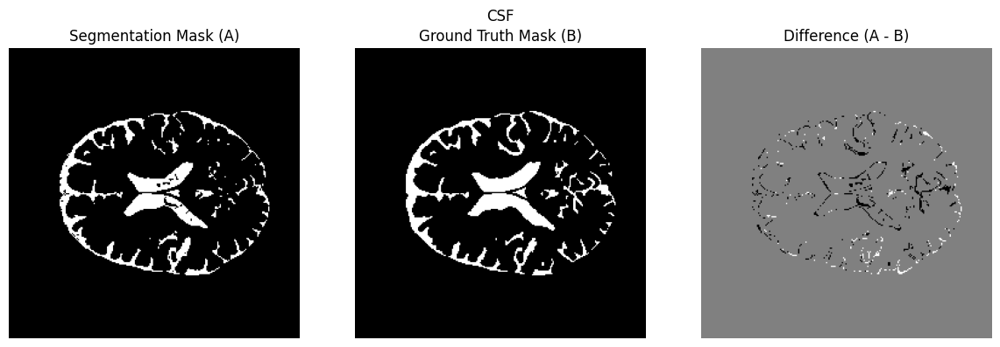

the dice score for this CSF is: 0.82


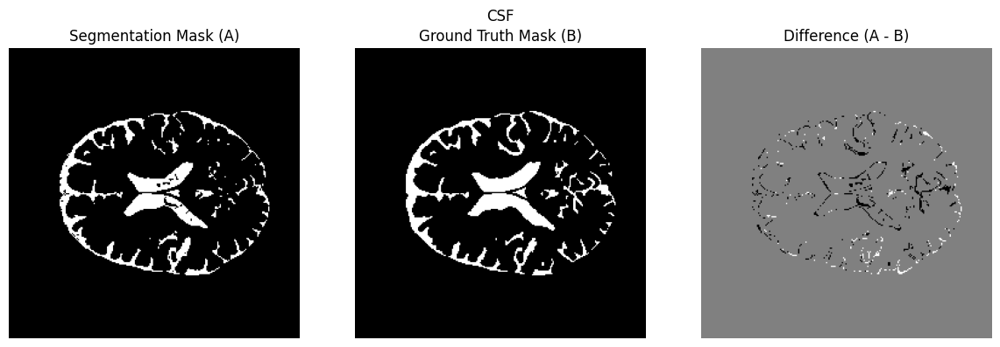

the dice score for this CSF is: 0.82


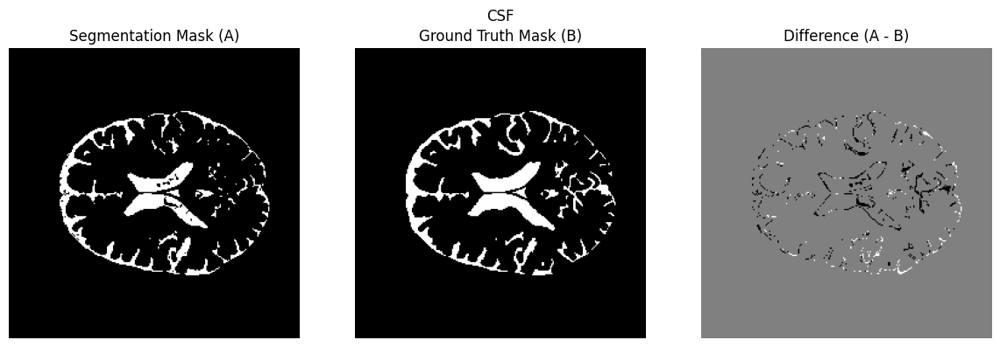

the dice score for this CSF is: 0.82


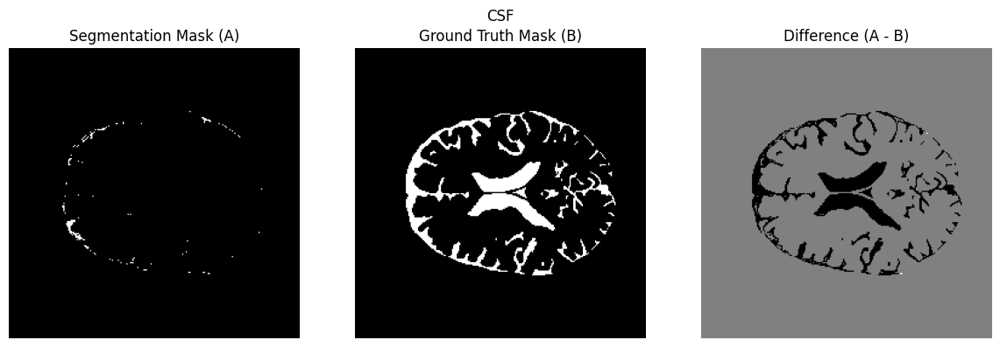

the dice score for this CSF is: 0.22


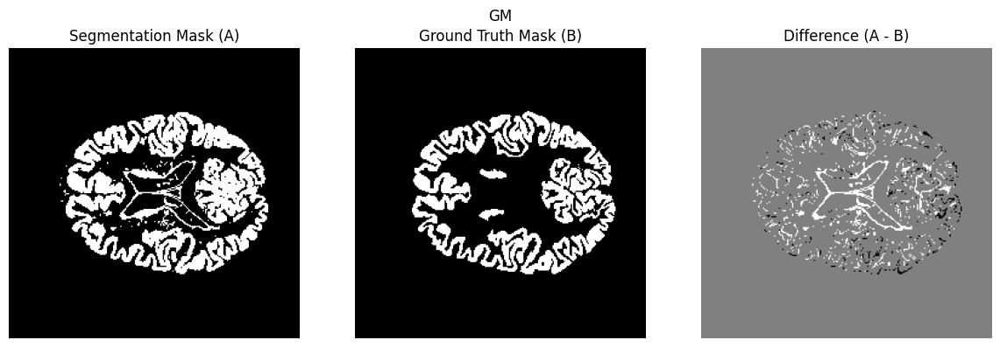

the dice score for this GM is: 0.86


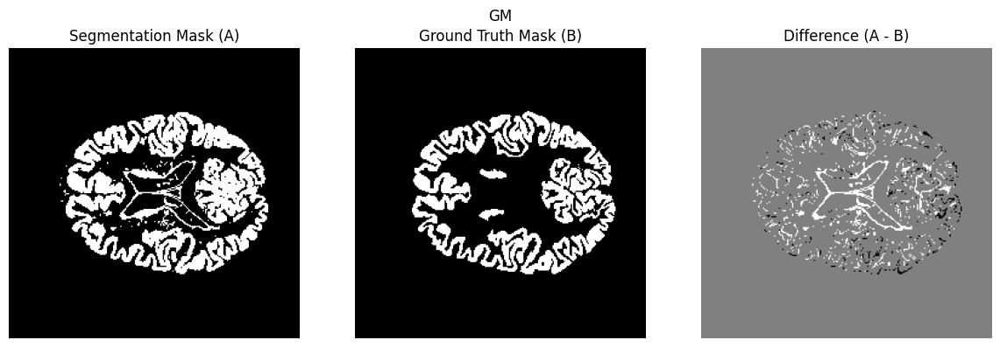

the dice score for this GM is: 0.86


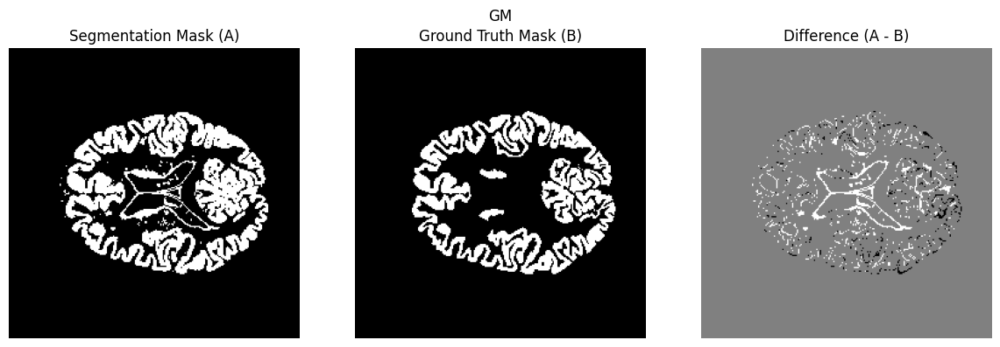

the dice score for this GM is: 0.86


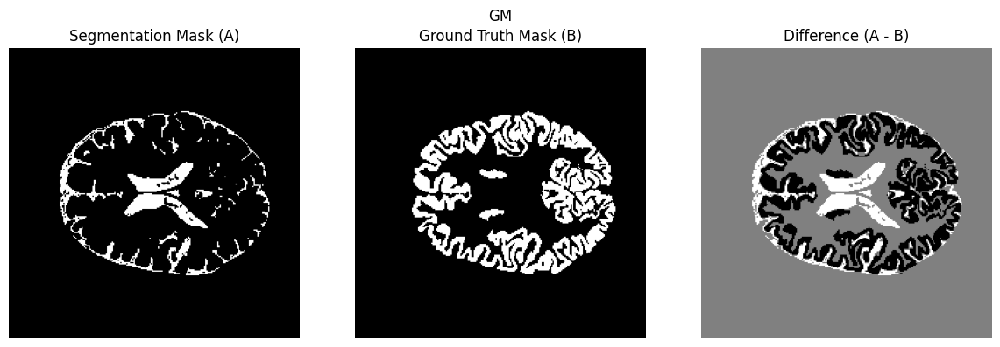

the dice score for this GM is: 0.06


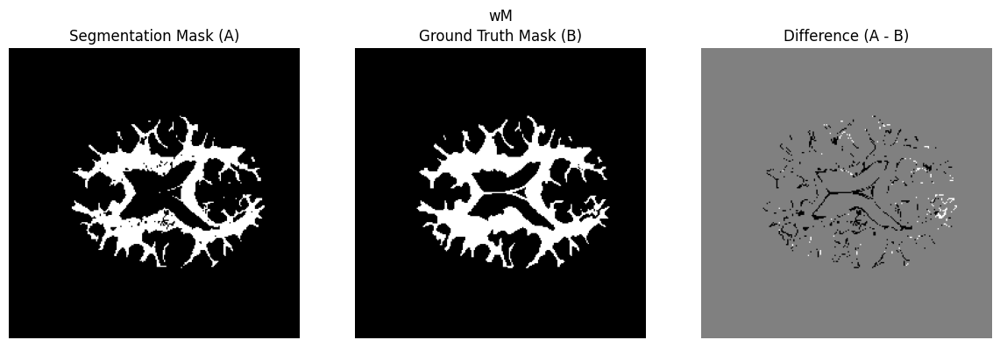

the dice score for this WM is: 0.89


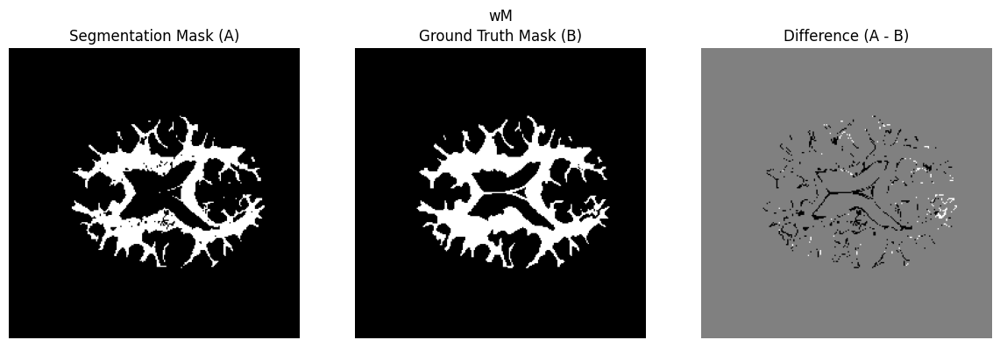

the dice score for this WM is: 0.89


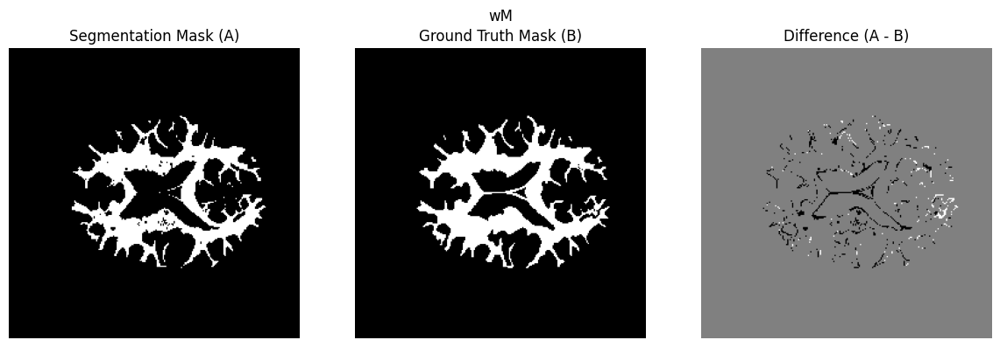

the dice score for this WM is: 0.90


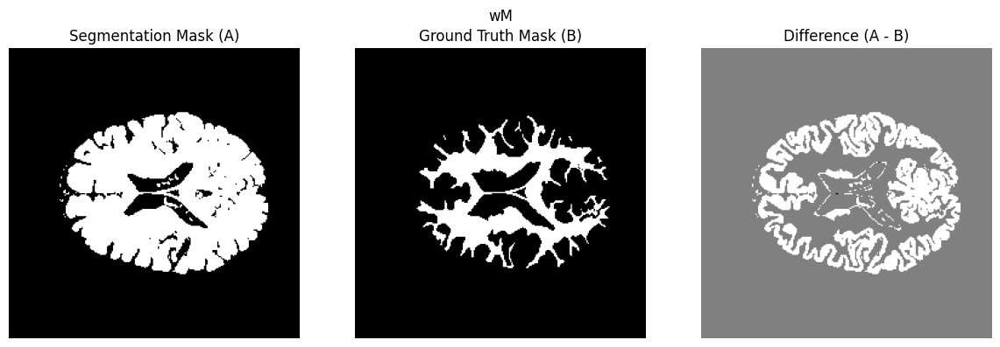

the dice score for this WM is: 0.54


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't1', 24)

[[ 56.65873469]
 [142.86318025]
 [182.07874989]]
[[ 68.55281234]
 [152.78861333]
 [180.86735183]]


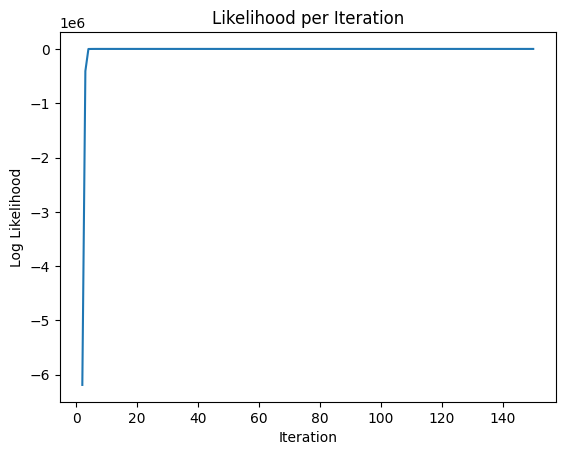


 k-means initialization custom gmm, t1 took 17 sec.
[[ 56.25304728]
 [141.70729996]
 [181.08979171]]
[[ 68.53730077]
 [152.37706581]
 [180.01102446]]


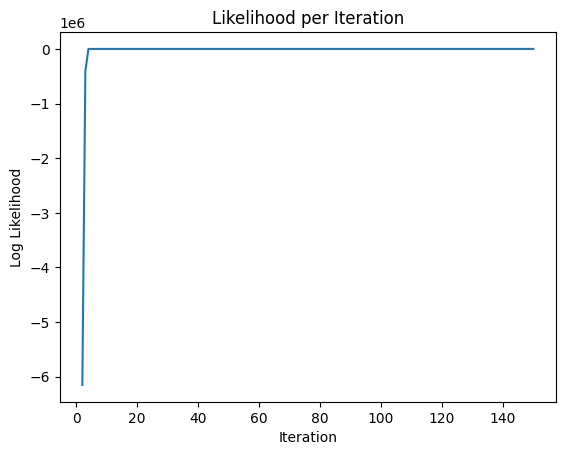


 k-means initialization scipy gmm, t1 took 19 sec.
[[ 35]
 [ 94]
 [161]]
[[ 30]
 [ 73]
 [163]]


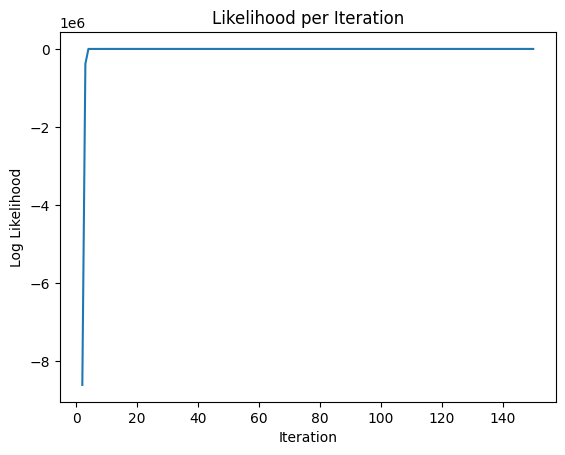


 random initialization custom gmm, with t1 took 17 sec.
[[ 51]
 [ 70]
 [112]]
[[ 26]
 [ 70]
 [162]]


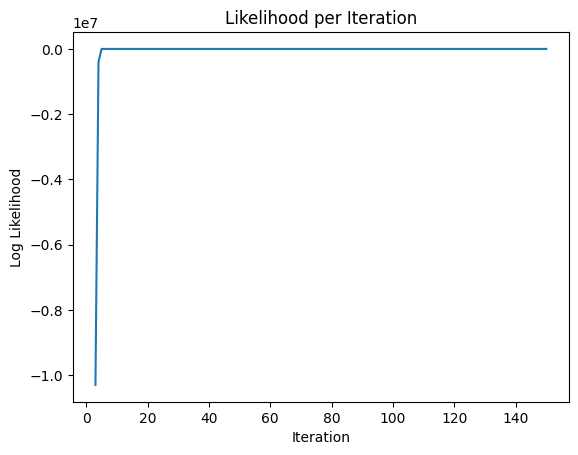


 random initialization scipy gmm, with t1 took 19 sec.


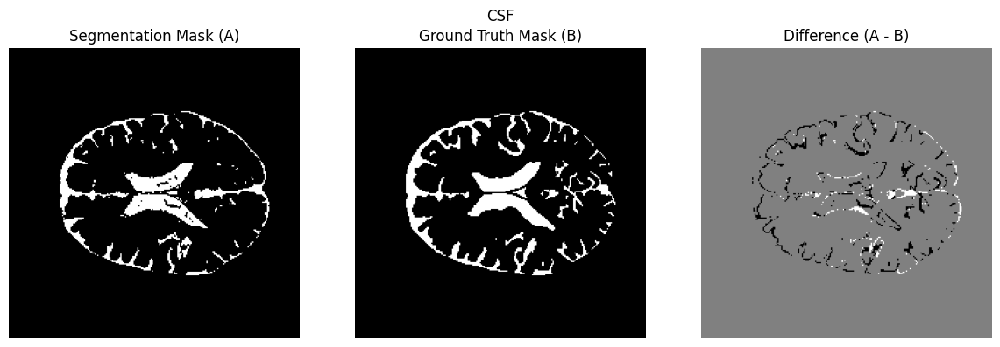

the dice score for this CSF is: 0.80


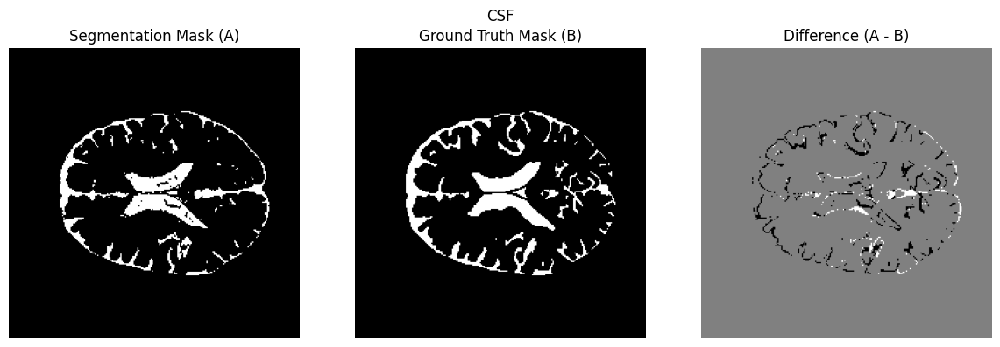

the dice score for this CSF is: 0.80


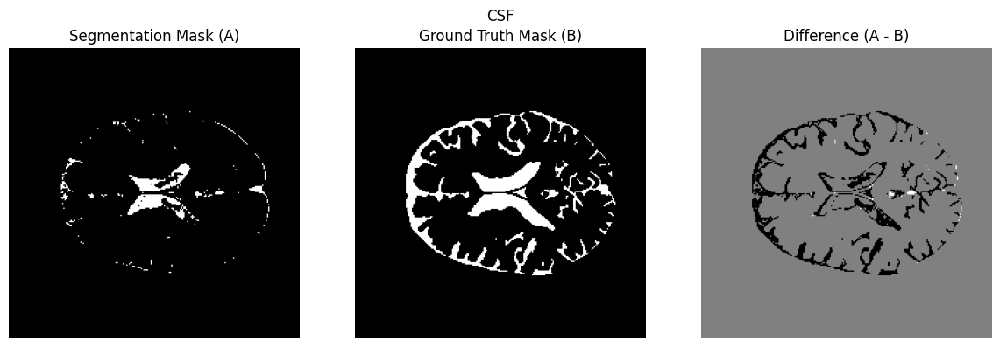

the dice score for this CSF is: 0.28


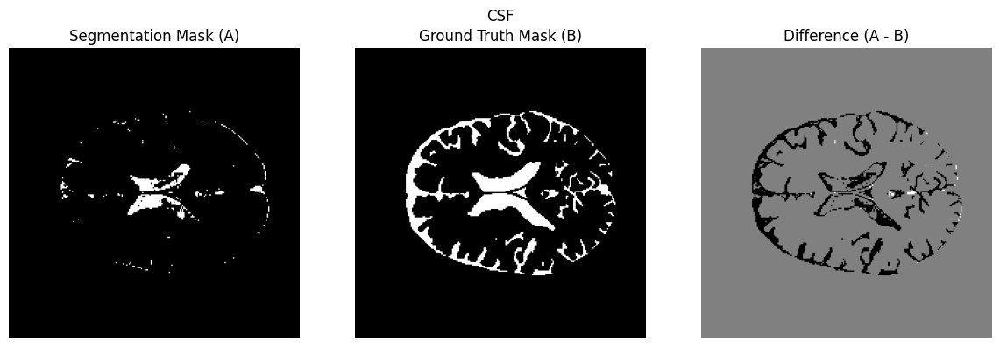

the dice score for this CSF is: 0.23


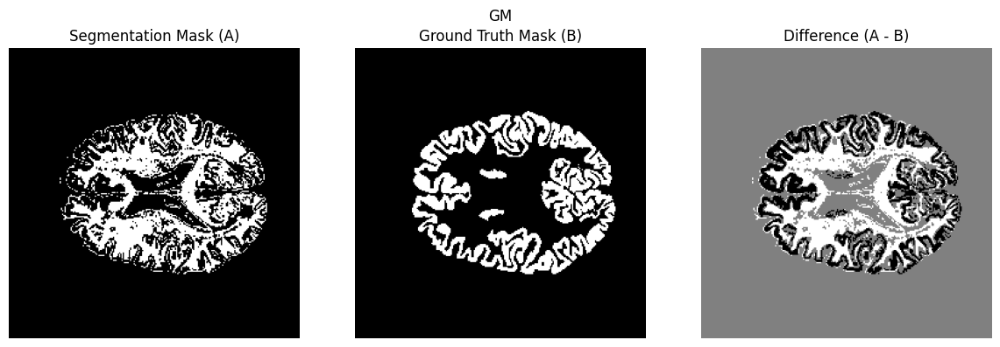

the dice score for this GM is: 0.40


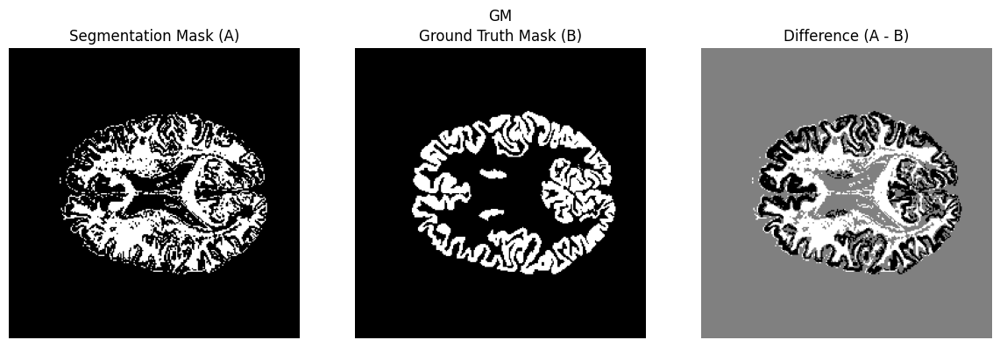

the dice score for this GM is: 0.38


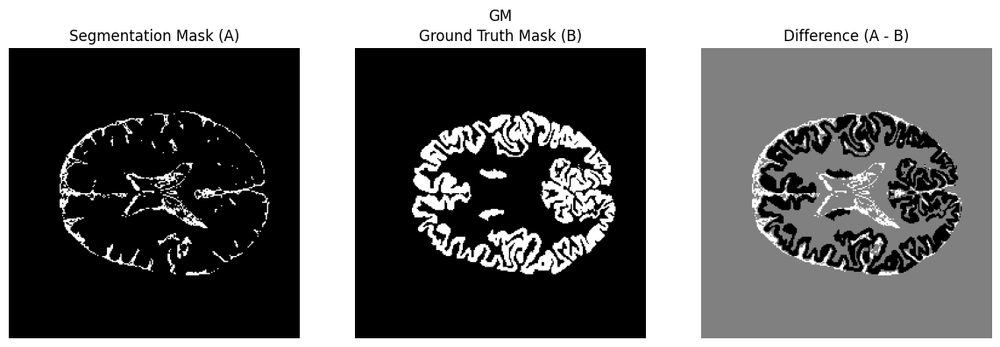

the dice score for this GM is: 0.05


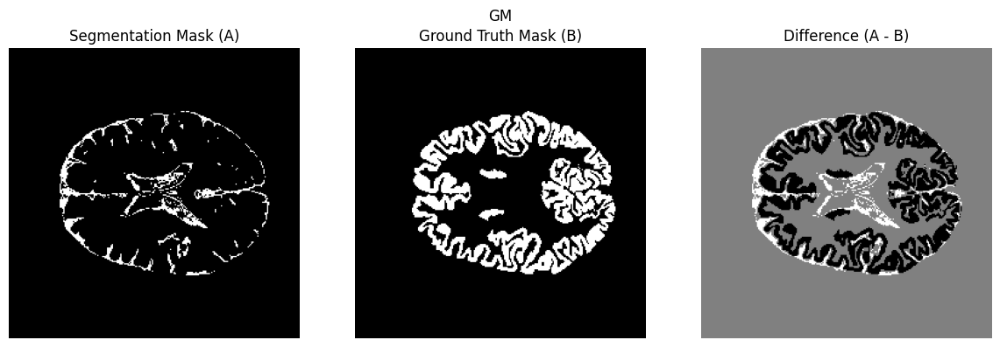

the dice score for this GM is: 0.04


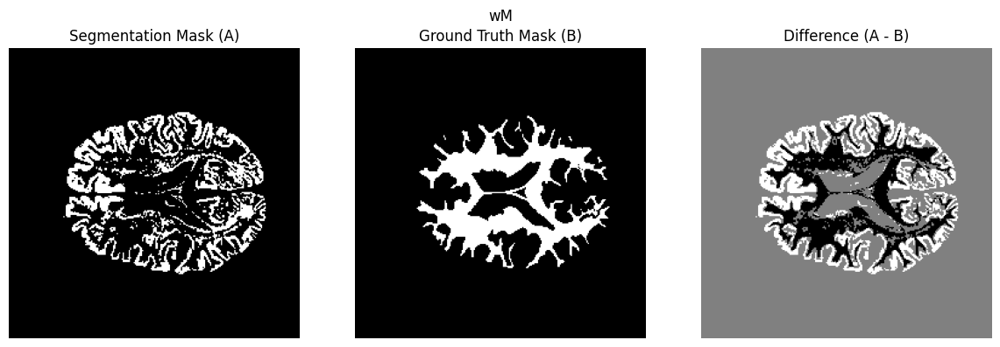

the dice score for this WM is: 0.12


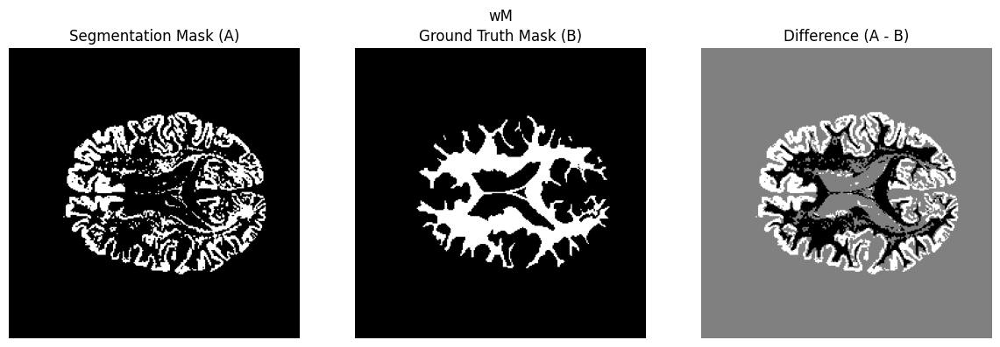

the dice score for this WM is: 0.14


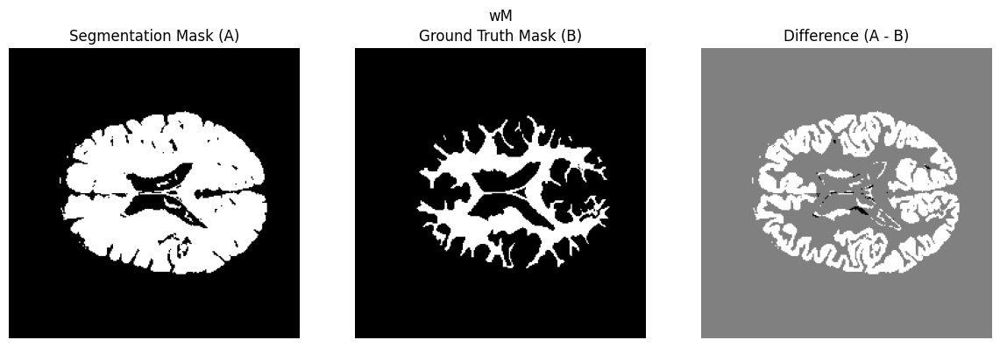

the dice score for this WM is: 0.51


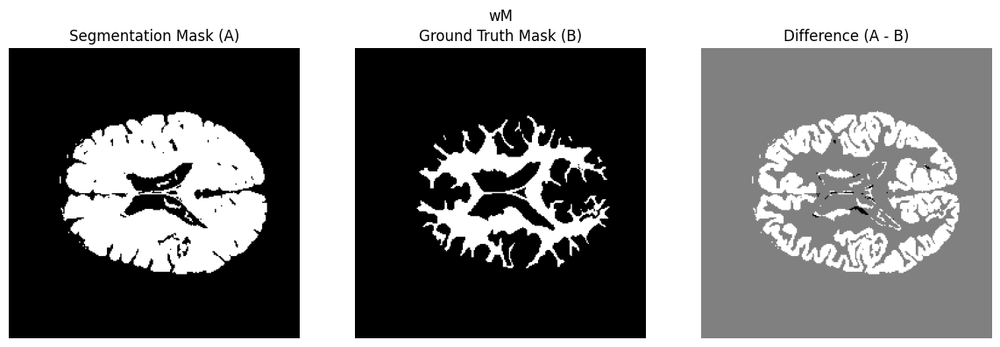

the dice score for this WM is: 0.51


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 't2', 24)

[[ 35.76530331  72.32519825]
 [123.84030118 175.6640438 ]
 [200.99251783 153.54073624]]
[[ 45.44438459  91.60993374]
 [145.87106441 175.53467697]
 [210.7635227  152.15486503]]


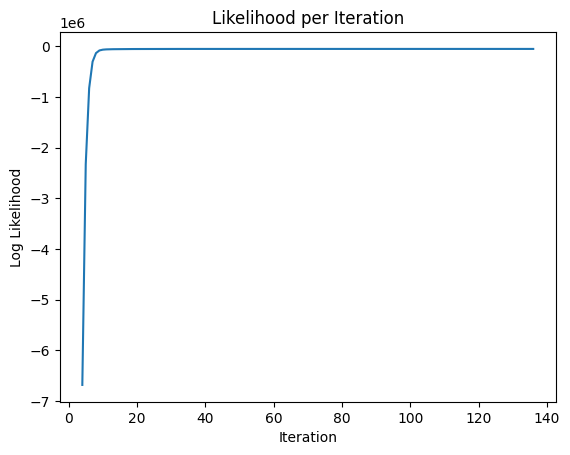


 k-means initialization custom gmm, t1 took 33 sec.
[[ 35.74272497  72.26501856]
 [123.74231168 175.65431034]
 [200.93221328 153.56422507]]
[[ 45.4443847   91.60993386]
 [145.87106474 175.53467687]
 [210.76352285 152.15486499]]


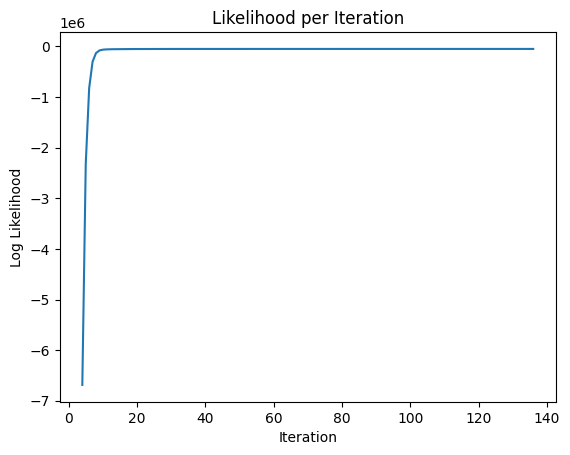


 k-means initialization scipy gmm, t1 took 31 sec.
[[ 21  21]
 [135 135]
 [175 175]]
[[ 24  55]
 [ 83 143]
 [175 165]]


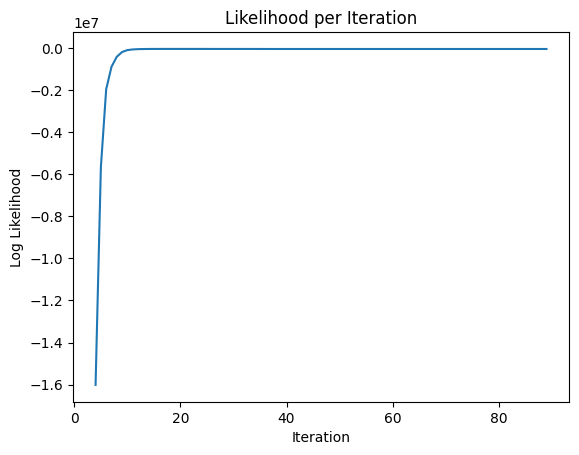


 random initialization custom gmm, with t1 took 22 sec.
[[109 109]
 [197 197]
 [224 224]]
[[ 50  96]
 [172 166]
 [222 223]]


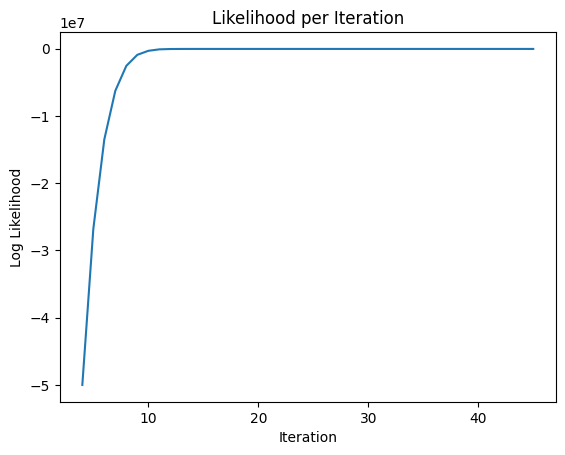


 random initialization scipy gmm, with t1 took 11 sec.


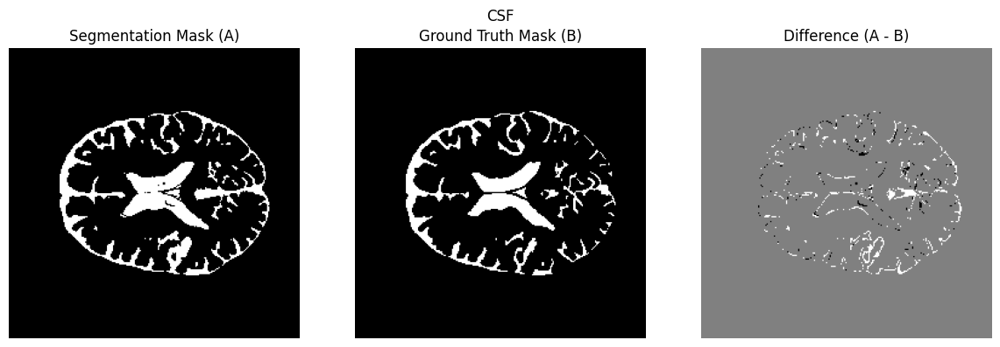

the dice score for this CSF is: 0.87


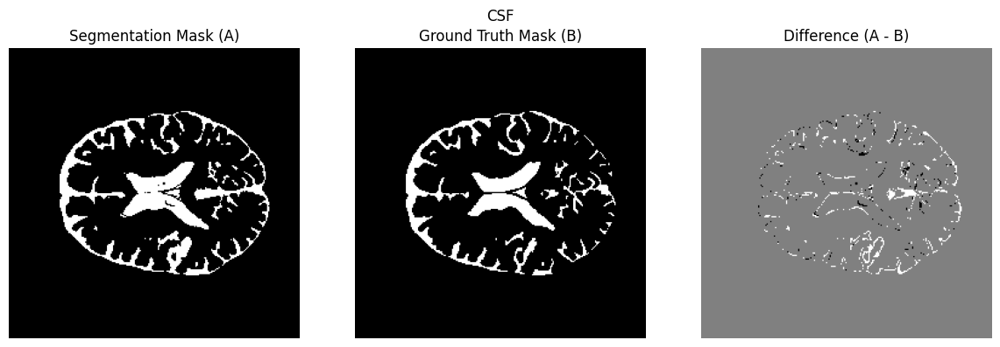

the dice score for this CSF is: 0.87


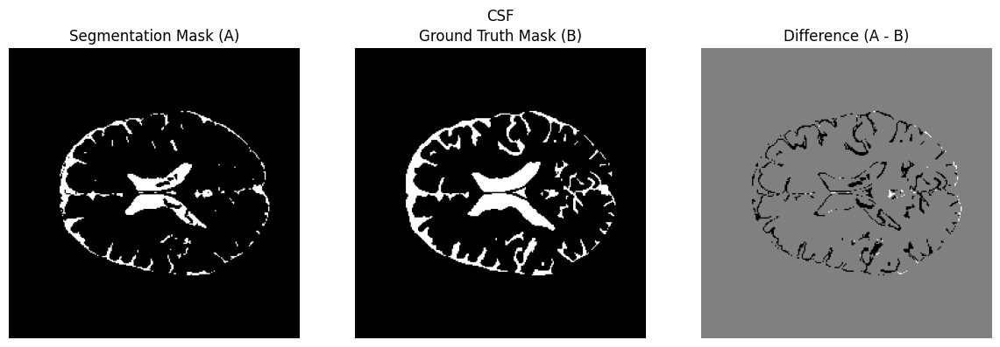

the dice score for this CSF is: 0.73


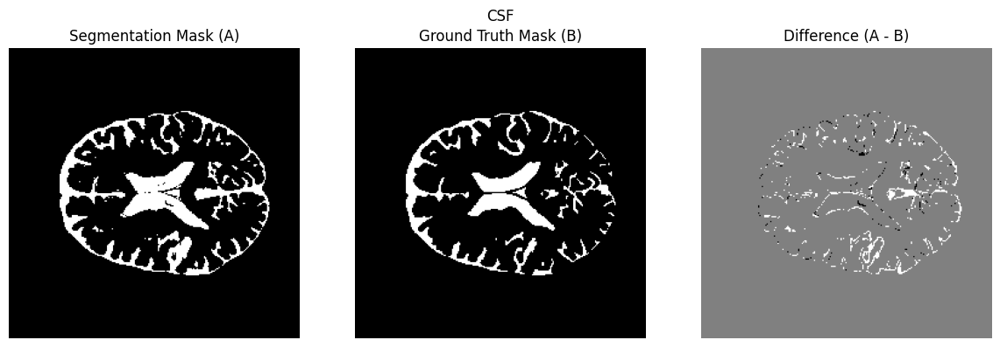

the dice score for this CSF is: 0.86


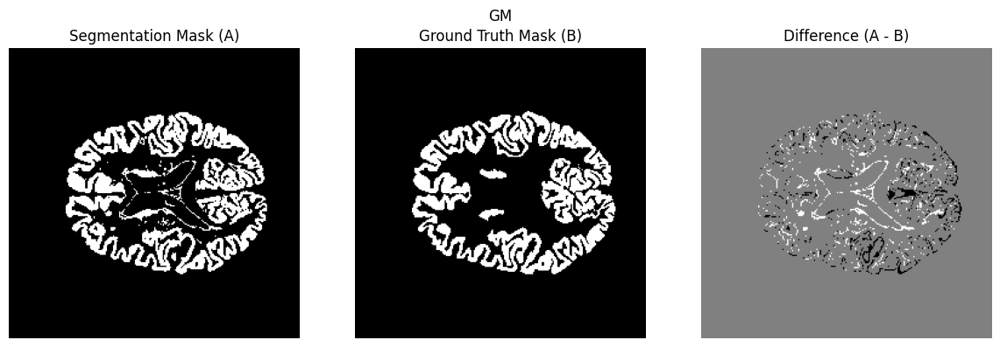

the dice score for this GM is: 0.85


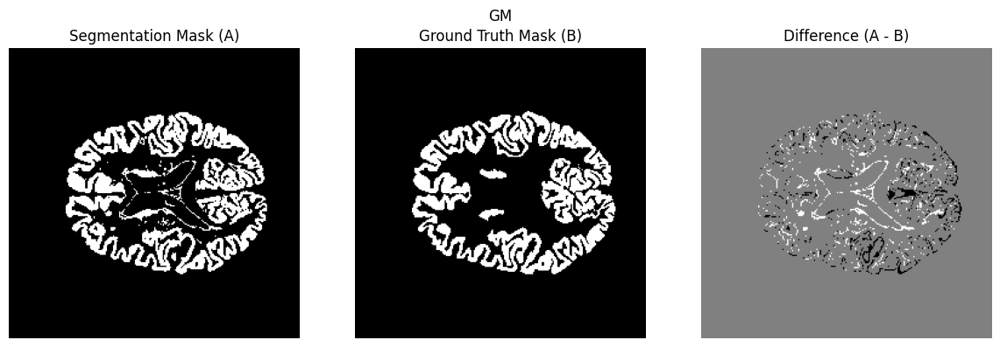

the dice score for this GM is: 0.85


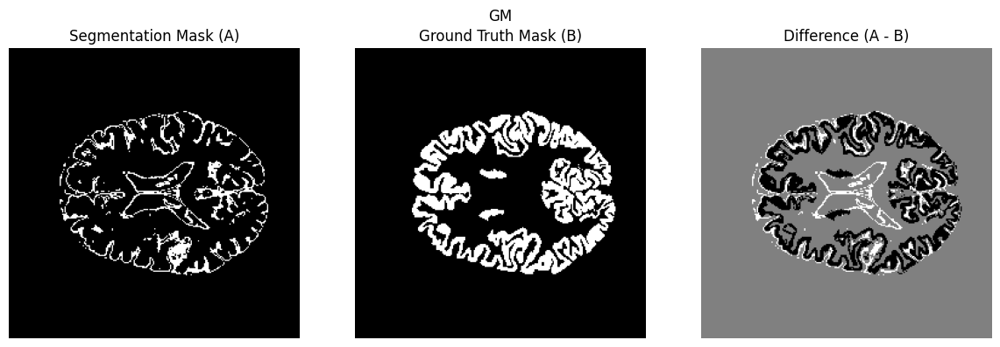

the dice score for this GM is: 0.28


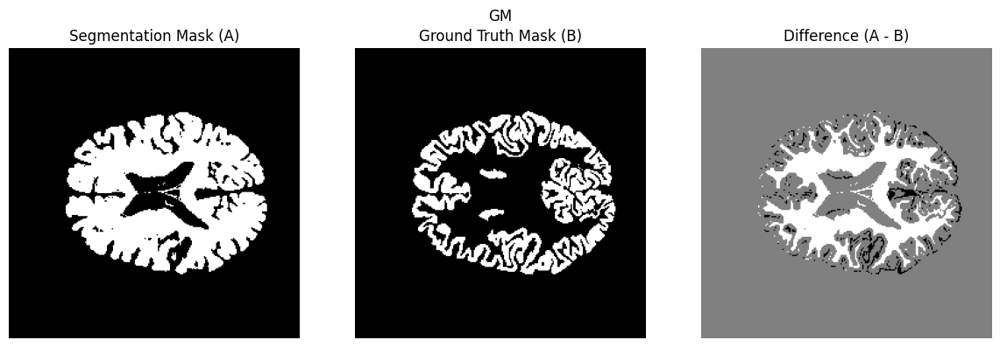

the dice score for this GM is: 0.68


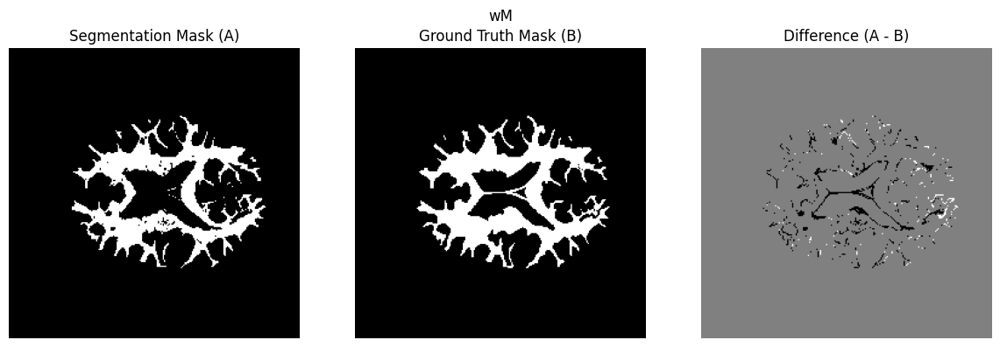

the dice score for this WM is: 0.89


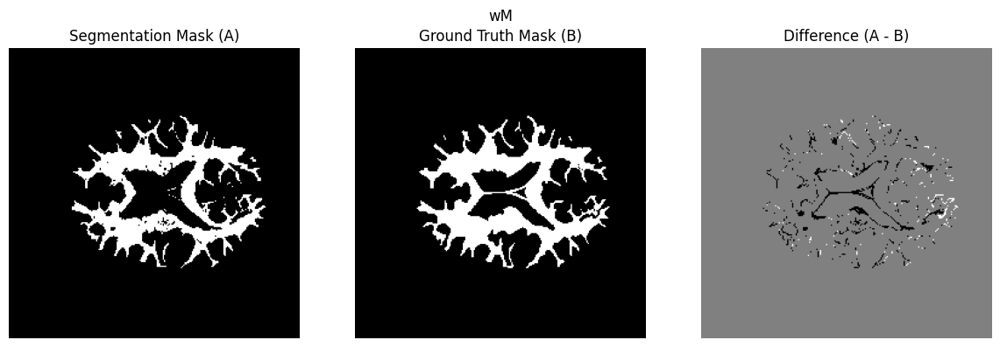

the dice score for this WM is: 0.89


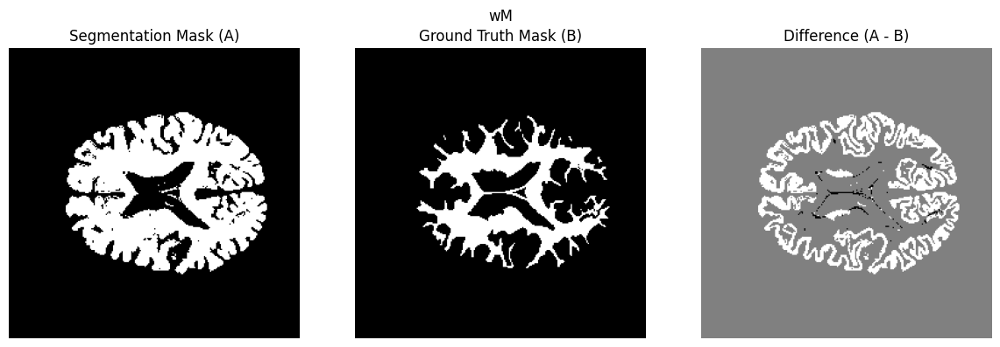

the dice score for this WM is: 0.60


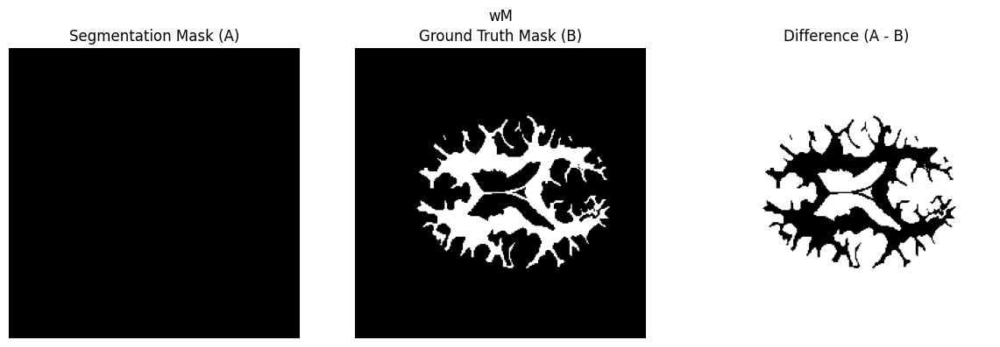

the dice score for this WM is: 0.00


In [ ]:
testing('stripped_T1.nii', 'stripped_T2.nii', 'LabelsForTesting.nii', 'mv', 24)